## Starfysh & benchmarking results on simulated ST dataset

**Azizi Lab**

Siyu He, Yinuo Jin

This notebook reproduces Starfysh paper results on Figure 1 & supplementary figure 1 (to be updated), which covers major cell type (`simu_5`) & fine grained cell type (`simu_10`) simulation studies as well as benchmarking with other methods

### I. Major cell type simulations

#### Load data

In [1]:
import sys
IN_COLAB = "google.colab" in sys.modules
if IN_COLAB:
    !pip3 install scanpy
    #!pip3 install histomicstk
    from google.colab import drive
    drive.mount('/content/drive')
    import sys
    sys.path.append('/content/drive/MyDrive/SpatialModelProject/model_test_colab/')

In [2]:
import os
import time
import numpy as np
import pandas as pd
import torch

from scipy.stats import gaussian_kde
from scipy.spatial.distance import jensenshannon

In [3]:
import matplotlib.pyplot as plt
import matplotlib.cm as cm
import matplotlib.font_manager
from matplotlib import rcParams

import seaborn as sns
sns.set_style('white')

font_list = []
fpaths = matplotlib.font_manager.findSystemFonts()
for i in fpaths:
    try:
        f = matplotlib.font_manager.get_font(i)
        font_list.append(f.family_name)
    except RuntimeError:
        pass

font_list = set(font_list)
plot_font = 'Helvetica' if 'Helvetica' in font_list else 'FreeSans'

rcParams['font.family'] = plot_font
rcParams.update({'font.size': 10})
rcParams.update({'figure.dpi': 300})
rcParams.update({'figure.figsize': (4,4)})
rcParams.update({'savefig.dpi': 500})

import warnings
warnings.filterwarnings('ignore')

In [4]:
from starfysh import (AA, utils, plot_utils, post_analysis, dataloader)
from starfysh import starfysh as sf_model

Load benchmark util functions:

In [5]:
sys.path.append('../simulation/')
import utils as benchmark_utils
# from importlib import reload
# reload(benchmark_utils)

Load simulation data:

```
├── simu_:
    \__ counts.st_synth.csv
        members.st_synth.csv
        proportions.st_synth.csv
        signature.st_synth.csv

    ├── (Optional, if simulating with paired image) spatial:
        \__ tissue_hires_image.png
            tissue_positions_list.csv
```

In [6]:
# Change data path
data_path = '../../starfysh/data/'
sample_id = 'simulated_ST_data_1/'
adata, adata_normed = utils.load_adata(data_folder=data_path,  # root data directory
                                       sample_id=sample_id,  # sample_id
                                       n_genes=2000  # number of highly variable genes to keep
                                      )

gene_sig = pd.read_csv(os.path.join(data_path, sample_id, 'signature.st_synth.csv'))
gene_sig = utils.filter_gene_sig(gene_sig,adata.to_df()) # filter out low-quality marker genes
gene_sig.head()

[2023-07-13 14:33:57] Preprocessing1: delete the mt and rp
[2023-07-13 14:33:58] Preprocessing2: Normalize
[2023-07-13 14:33:58] Preprocessing3: Logarithm
[2023-07-13 14:33:59] Preprocessing4: Find the variable genes


,CAFs,Cancer_Epithelial,Myeloid,Normal_Epithelial,T-cells
0,DCN,SCGB2A2,C1QB,KRT14,CCL5
1,COL1A1,CD24,LYZ,KRT17,IL7R
2,LUM,MUCL1,C1QA,LTF,GNLY
3,COL1A2,KRT19,C1QC,KRT15,NKG7
4,SFRP2,SCGB1D2,TYROBP,PTN,CD3E


Load ground-truth proportions & densities:

In [7]:
mem_df = pd.read_csv(os.path.join(data_path, sample_id, 'members.st_synth.csv'),index_col=0)
prop_df = pd.read_csv(os.path.join(data_path, sample_id, 'proportions.st_synth.csv'),index_col=0)

In [8]:
# Load paired spatial information
has_histology = False

if has_histology:
    # TODO: update code to load histology & spatial metadata w/ simulation
    raise NotImplementedError("We don't have paired histology simulation")
    
else:
    map_info = pd.read_csv(os.path.join(data_path, sample_id, 'spatial/tissue_positions_list.csv'), index_col=[0])

    # Create dummy dict. as img_metadata
    img_metadata = {
        'img': None,
        'map_info': map_info,
        'scalefactor': None
    }
    
#umap_df = utils.get_umap(adata_normed, display=True)

In [9]:
#umap_df = utils.get_umap(adata_normed, display=True)

Data preprocessing:

In [9]:
visium_args = utils.VisiumArguments(adata,
                                    adata_normed,
                                    gene_sig,
                                    img_metadata,
                                    window_size=1,
                                    sig_version='gene_score',
                                    sample_id=sample_id
                                   )

adata, adata_normed = visium_args.get_adata()
anchors_df = visium_args.get_anchors()
prior_df = visium_args.sig_mean_norm

[2023-07-13 14:34:00] Subsetting highly variable & signature genes ...
[2023-07-13 14:34:08] Smoothing library size by taking averaging with neighbor spots...
[2023-07-13 14:34:09] Retrieving & normalizing signature gene expressions...
[2023-07-13 14:34:10] Identifying anchor spots (highly expression of specific cell-type signatures)...


In [79]:
# Plot RMSE
def disp_rmse(y_true, y_preds, labels, title=None, return_rmse=False):
    """
    Violinplot of per-spot RMSEs for each prediction
    """
    n_spots, n_cts = y_true.shape
    rmses = np.array([
        np.sqrt(((y_true.values-y_pred.values)**2).sum(1) / n_cts)
        for y_pred in y_preds
    ])

    lbls = np.repeat(labels, n_spots)
    df = pd.DataFrame({
        'RMSE': rmses.flatten(),
        'Method': lbls
    })
    plt.figure(figsize=(10, 6))
    g = sns.boxplot(x='Method', y='RMSE', data=df)
    g.set_xticklabels(labels, rotation=45)
    plt.suptitle(title)
    plt.show()

    return rmses if return_rmse else None


def disp_metrics_violin(
    y_true,
    y_preds,
    labels,
    title=None,
    metric_name='RMSE',
    return_metrics=False):
    """
    Violinplot of per-spot metrics for each prediction against the ground-truth
    """
    n_spots, n_cts = y_true.shape
    if metric_name == 'RMSE':
        metrics = np.array([
            np.sqrt(((y_true.values-y_pred.values)**2).sum(1) / n_cts)
            for y_pred in y_preds
        ])
        
    elif metric_name == 'JSD':
        metrics = np.array([
            jensenshannon(y_true.values, y_pred.values, axis=1)
            for y_pred in y_preds
        ])
    else:
        raise NotImplementedError(metric_name)

    lbls = np.repeat(labels, n_spots)
    df = pd.DataFrame({
        metric_name: metrics.flatten(),
        'Method': lbls
    })
    
    fig, ax = plt.subplots(figsize=(10, 4), dpi=300)
    g = sns.violinplot(x='Method', y=metric_name, data=df, scale='width', ax=ax)    
    for violin in ax.collections:
        violin.set_alpha(0.5)
    g = sns.stripplot(x='Method', y=metric_name, data=df, color='black', alpha=0.2, s=1,  ax=ax)

    
    #g = sns.swarmplot(x='Method', y=metric_name, data=df, ax=ax)
    g.set_xticklabels(labels, rotation=45, fontsize=12)
    g.set_xlabel('Method', fontsize=15)
    g.set_ylabel(metric_name,fontsize=15)
    plt.suptitle(title, fontsize=20)
    plt.show()
    
    plt.setp(g.collections, alpha=.1)

    return metrics if return_metrics else None

In [10]:
# Archived helper functions:

def find_closest_colormap(rgba_color):
    # Get a list of all available colormaps
    colormaps = [cmap for cmap in cm.datad if not cmap.endswith("_r")]

    # Convert the given RGBA color to RGB
    rgb_color = rgba_color[:3]

    closest_colormap = None
    closest_distance = np.inf

    # Find the closest matching colormap
    for cmap in colormaps:
        cmap_colors = cm.get_cmap(cmap)(np.linspace(0, 1, 256))[:, :3]
        distances = np.linalg.norm(cmap_colors - rgb_color, axis=1)
        min_distance = np.min(distances)
        if min_distance < closest_distance:
            closest_colormap = cmap
            closest_distance = min_distance

    return closest_colormap


def generate_colormaps(num_colormaps):
    # Get a list of all available sequential colormaps
    colormaps = [cmap for cmap in cm.datad if not cmap.endswith("_r")]

    # Calculate the step size to evenly distribute the colormaps
    step_size = len(colormaps) // num_colormaps

    # Select the colormaps at regular intervals
    selected_colormaps = colormaps[::step_size][:num_colormaps]

    # Generate a list of colors for each colormap
    #colors = [cm.get_cmap(cmap)(0.5) for cmap in selected_colormaps]
    #cmaps = [cm.get_cmap(cmap)(0.5) for cmap in selected_colormaps

    return selected_colormaps


def calc_anchor_props(anchors_df, prop_df):
    """
    Calculate average ground-truth proportion of the given cell type
    captured at the inferred anchors
    """
    avg_anchor_props = np.zeros(anchors_df.shape[1])

    for i, cell_type in enumerate(anchors_df.columns):
        anchor_indices = anchors_df.iloc[:, i][anchors_df[cell_type] > 0]
        avg_prop = prop_df.iloc[anchor_indices, i].mean()
        avg_anchor_props[i] = avg_prop
        
    return np.array(avg_anchor_props).round(3)

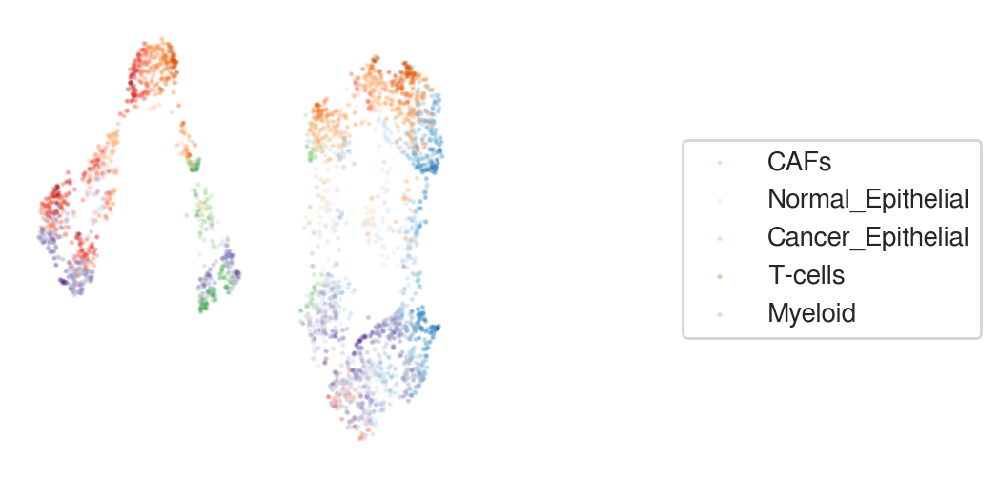

In [12]:
# display_gt_umaps(umap_df, prop_df)

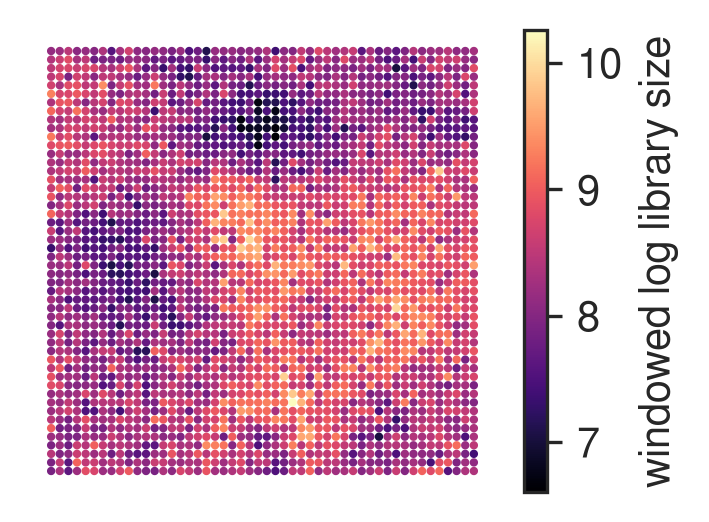

In [10]:
plot_utils.plot_spatial_feature(adata,
                                map_info,
                                visium_args.win_loglib,
                                label='windowed log library size',
                                )

#### Figure 1(b)-1(e):

##### (a). Starfysh with only signature priors

In [10]:
n_repeats = 3
epochs = 200
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')

model, loss = utils.run_starfysh(visium_args,
                                 n_repeats=n_repeats,
                                 alpha_mul=50,
                                 epochs=epochs,
                                 poe=False,
                                 device=device)

[2023-07-11 12:31:29] Running Starfysh with 3 restarts, choose the model with best parameters...
[2023-07-11 12:31:29]  ===  Restart Starfysh 1 === 

[2023-07-11 12:31:30] Initializing model parameters...
[2023-07-11 12:31:44] Epoch[10/200], train_loss: 1886.1299, train_reconst: 1808.4386, train_u: 16.1653,train_z: 26.5865,train_c: 32.6774,train_l: 2.2621
[2023-07-11 12:31:56] Epoch[20/200], train_loss: 1778.9774, train_reconst: 1705.1190, train_u: 14.7639,train_z: 28.2459,train_c: 28.0305,train_l: 2.8182
[2023-07-11 12:32:09] Epoch[30/200], train_loss: 1728.4257, train_reconst: 1657.6756, train_u: 13.8080,train_z: 27.9530,train_c: 25.9923,train_l: 2.9969
[2023-07-11 12:32:22] Epoch[40/200], train_loss: 1697.8451, train_reconst: 1629.5996, train_u: 13.1575,train_z: 27.5577,train_c: 24.4147,train_l: 3.1156
[2023-07-11 12:32:35] Epoch[50/200], train_loss: 1669.1337, train_reconst: 1602.2550, train_u: 12.7151,train_z: 28.0484,train_c: 22.8853,train_l: 3.2300
[2023-07-11 12:32:48] Epoch[60

Parse results:

In [13]:
inference_outputs, generative_outputs = sf_model.model_eval(model,
                                                            adata,
                                                            visium_args,
                                                            poe=False,
                                                            device=device)

# Deconvolution prediction
prop_pred_df = pd.DataFrame(adata.obsm['qc_m'], index=adata.obs_names, columns=gene_sig.columns)

In [14]:
prop_pred_df.to_csv('../simulation/results/Starfysh_simu_5.csv', index=True)

**Signature prior baseline**

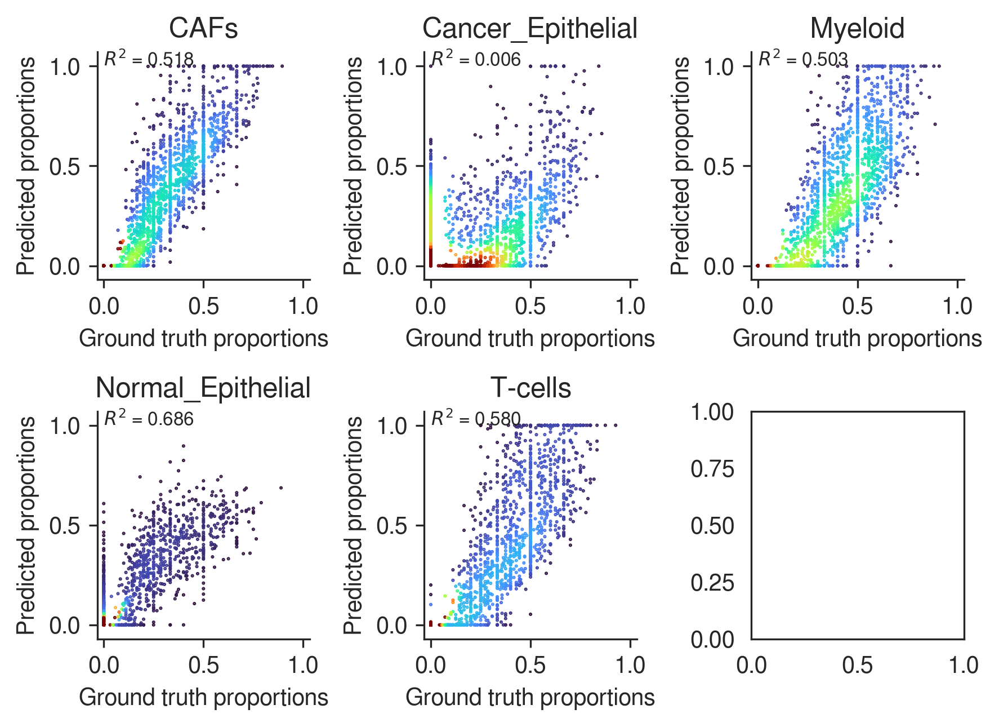

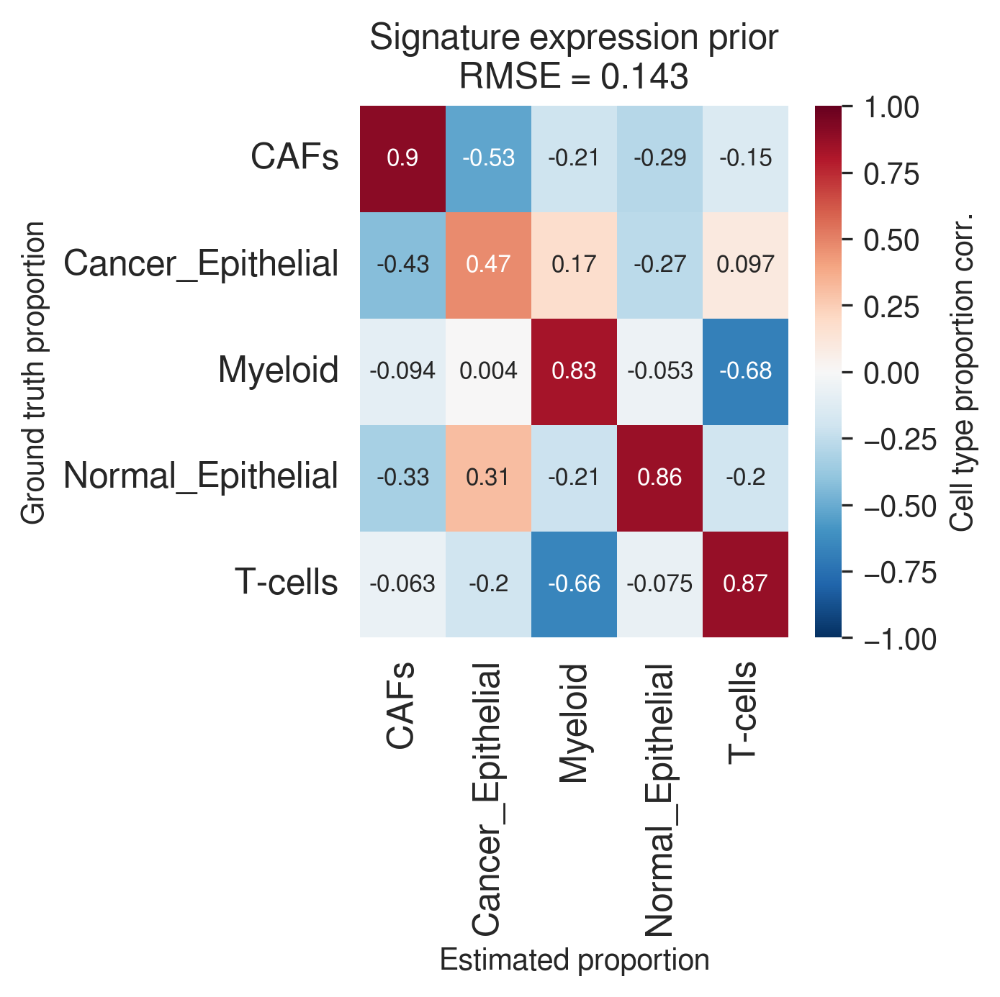

In [19]:
prior_df = visium_args.sig_mean_norm.copy()

benchmark_utils.disp_prop_scatter(prop_df, prior_df)
benchmark_utils.disp_corr(
    prop_df,
    prior_df, 
    fontsize=8, 
    title='Signature expression prior',
    # filename='simu_5_prior',
    # savefig=True,
    # format='svg'    
)

**Starfysh deconvolution (signature priors)**

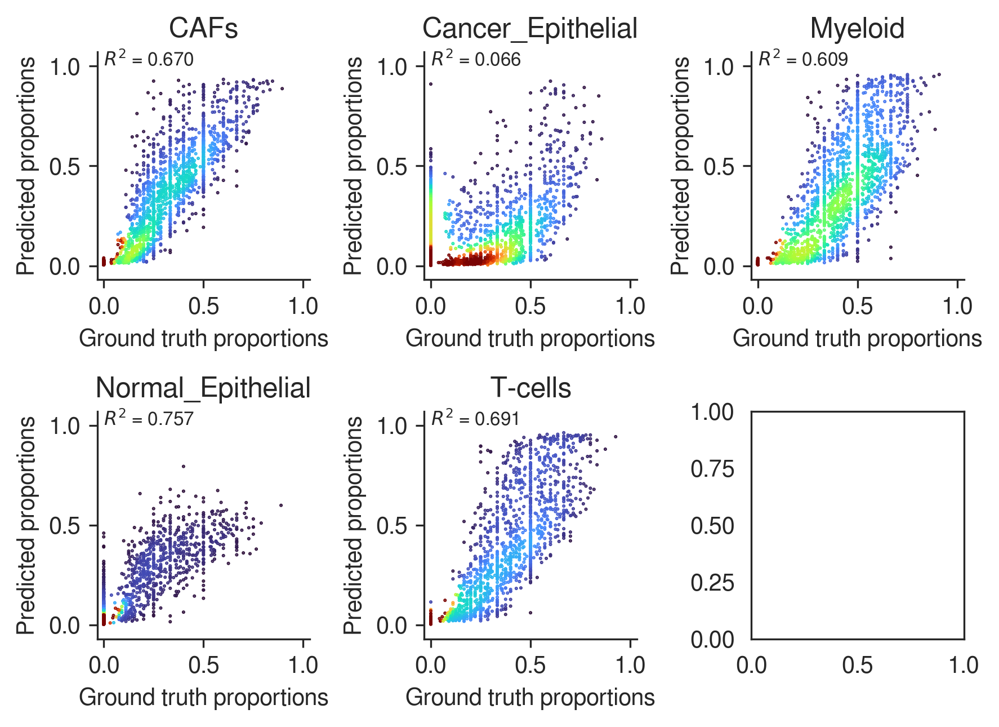

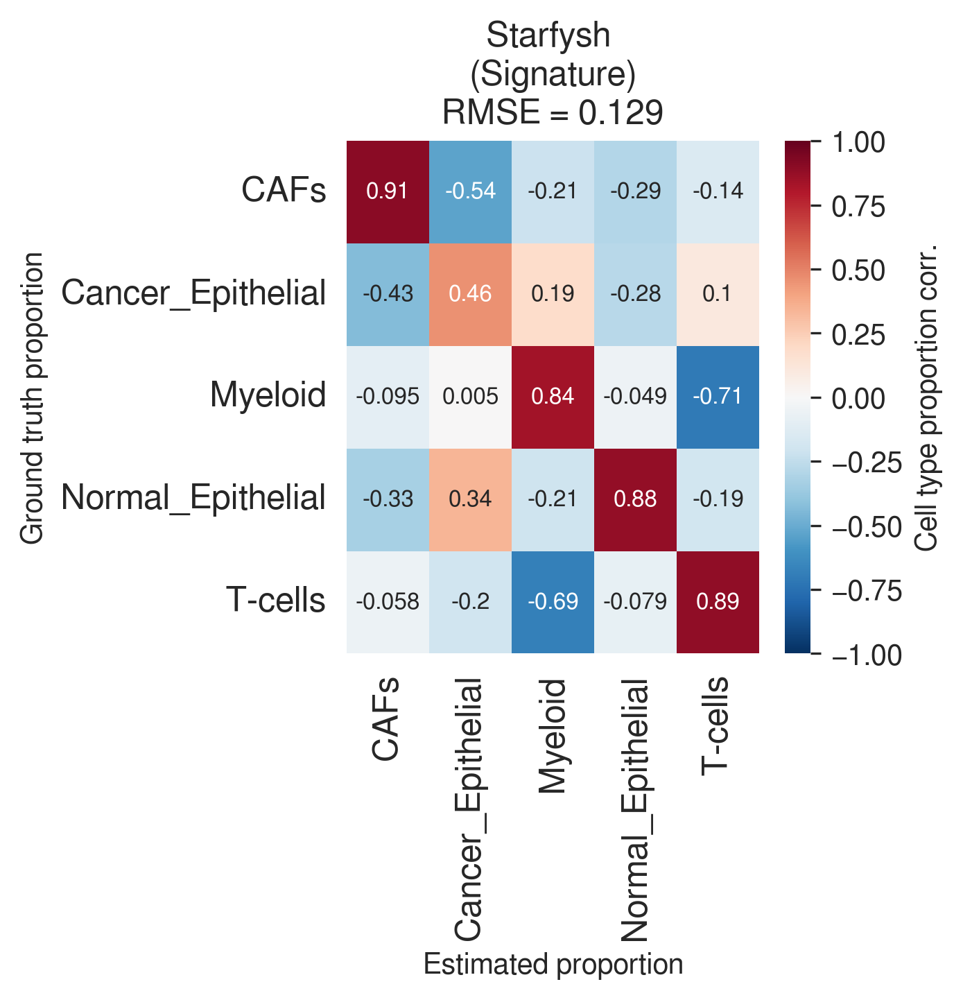

In [15]:
benchmark_utils.disp_prop_scatter(
    prop_df, 
    prop_pred_df,
    outdir='../../plot_files/starfysh_revision/',
    filename='simu_5_starfysh_scatter',
    savefig=False,
    format='svg'
)
benchmark_utils.disp_corr(
    prop_df,
    prop_pred_df,
    fontsize=8, 
    # outdir='../../plot_files/starfysh_revision/',
    title='Starfysh \n(Signature)',
    filename='simu_5_starfysh',
    savefig=False,
    format='svg'
)

##### (b). Starfysh with archetypal analysis

In [10]:
aa_model = AA.ArchetypalAnalysis(adata_orig=adata)

# set large resolution / convergence criteria to obtain major archetypes
archetype, arche_dict, major_idx, evs = aa_model.compute_archetypes(cn=10,
                                                                    r=400,  
                                                                    converge=1e-2,
                                                                    display=False)

arche_df = aa_model.find_archetypal_spots(major=True)
markers_df = aa_model.find_markers(n_markers=30, display=False)

# (3). Map archetypes to closest anchors within `r` nearest neighbors
# Choose the top 30% anchors of each cell type for mapping
percent_anchor = 0.3
n_ancs = int(percent_anchor*adata.shape[0])

anchors_df = visium_args.get_anchors()
map_df, map_dict = aa_model.assign_archetypes(anchor_df=anchors_df[:n_ancs],
                                              r=n_ancs)

[2023-07-13 14:34:13] Computing intrinsic dimension to estimate k...


4 components are retained using conditional_number=10.00


[2023-07-13 14:34:13] Estimating lower bound of # archetype as 3...
[2023-07-13 14:34:33] 0.8978 variance explained by raw archetypes.
Merging raw archetypes within 400 NNs to get major archetypes
[2023-07-13 14:34:33] Finding 20 nearest neighbors for each archetype...
[2023-07-13 14:34:33] Finding 30 top marker genes for each archetype...


(<Figure size 1800x1200 with 1 Axes>, <AxesSubplot:>)

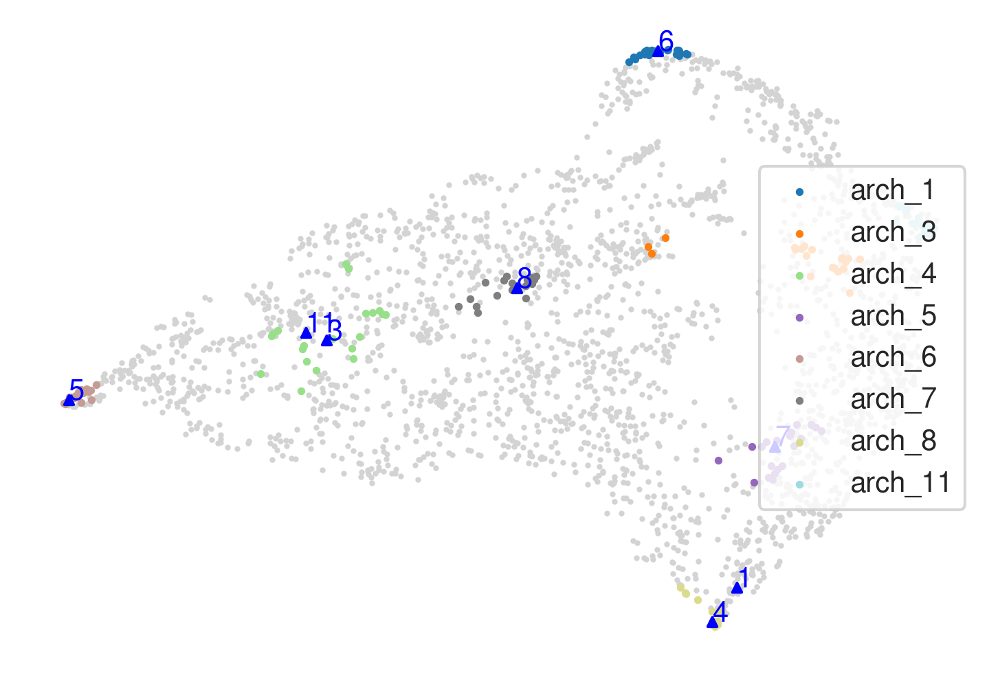

In [90]:
aa_model.plot_archetypes()

<AxesSubplot:>

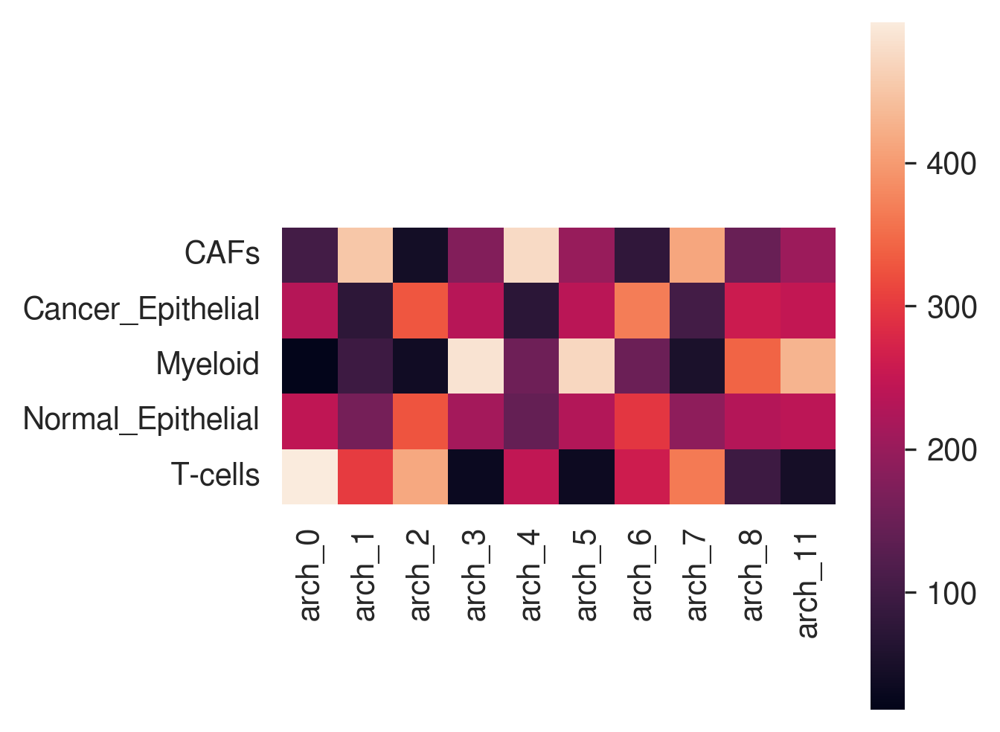

In [15]:
sns.heatmap(map_df, square=True)

##### Supp. fig. 2

3D scatter plot of ground-truth proportion enrichment:

In [50]:
import scanpy as sc
import umap

In [157]:
%matplotlib widget

In [154]:
def get_umap_3d(cnt, archetype, indices, adata):
    X = np.vstack([cnt, archetype])
    idx = list(adata.obs_names) + ['arche_'+str(idx) for idx in indices]
    reducer = umap.UMAP(n_neighbors=30, n_components=3, random_state=42)
    U = reducer.fit_transform(X)
    umap_df = pd.DataFrame(U,
                           columns=['umap1', 'umap2', 'umap_3'],
                           index=idx)
    return umap_df

def display_gt_umaps(umap_df, prop_df, indices={}, n_arches=10, disp_arche=False):
    cell_types = prop_df.columns
    ncells = len(cell_types)
    cmaps = ['Blues','Greens','Reds','Oranges','Purples'] if ncells <= 5 else generate_colormaps(ncells)
    u, props = umap_df.values,prop_df.values
    max_prop_lbl = props.argmax(axis=1)
    
    fig, ax = plt.subplots(dpi=200, figsize=(6, 6), subplot_kw=dict(projection='3d'))
    if disp_arche:
        for i in range(len(umap_df)-n_arches, len(umap_df)):
            ax.scatter(u[i, 0], u[i, 1], u[i, 2], c='blue', s=15, marker='^')
            ax.text(u[i, 0], u[i, 1], u[i, 2], umap_df.index[i].split('_')[-1], fontsize=8, c='blue')
    
    for i in range(len(cell_types)):
        if i in indices:
            ax.scatter(u[max_prop_lbl==i, 0], u[max_prop_lbl==i, 1], u[max_prop_lbl==i, 2],
                       c=props[max_prop_lbl==i, i],
                       s=5,
                       cmap=cmaps[i], alpha=1
                      )
    # ax.scatter(u[:, 0], u[:, 1], u[:, 2], s=5, c='darkgray', alpha=0.1)
    
    ax.legend(cell_types, loc='right', bbox_to_anchor=(2.2, 0.5))
    # ax.axis('off')
    plt.show()
    
    return None
    

In [92]:
umap_df = get_umap_3d(aa_model.count, aa_model.major_archetype, aa_model.major_idx, adata_normed)

In [93]:
prop_df_dummy = pd.concat([
        prop_df,
        pd.DataFrame(np.ones((len(aa_model.major_idx), 5))*0.2, index=arche_df.columns, columns=prop_df.columns)
    ], axis=0
)

prop_df_dummy.head()

,CAFs,Cancer_Epithelial,Myeloid,Normal_Epithelial,T-cells
location_0,0.333333,0.0,0.000000,0.0,0.666667
location_1,0.500000,0.0,0.000000,0.0,0.500000
location_2,0.545455,0.0,0.181818,0.0,0.272727
location_3,0.625000,0.0,0.375000,0.0,0.000000
location_4,0.444444,0.0,0.555556,0.0,0.000000


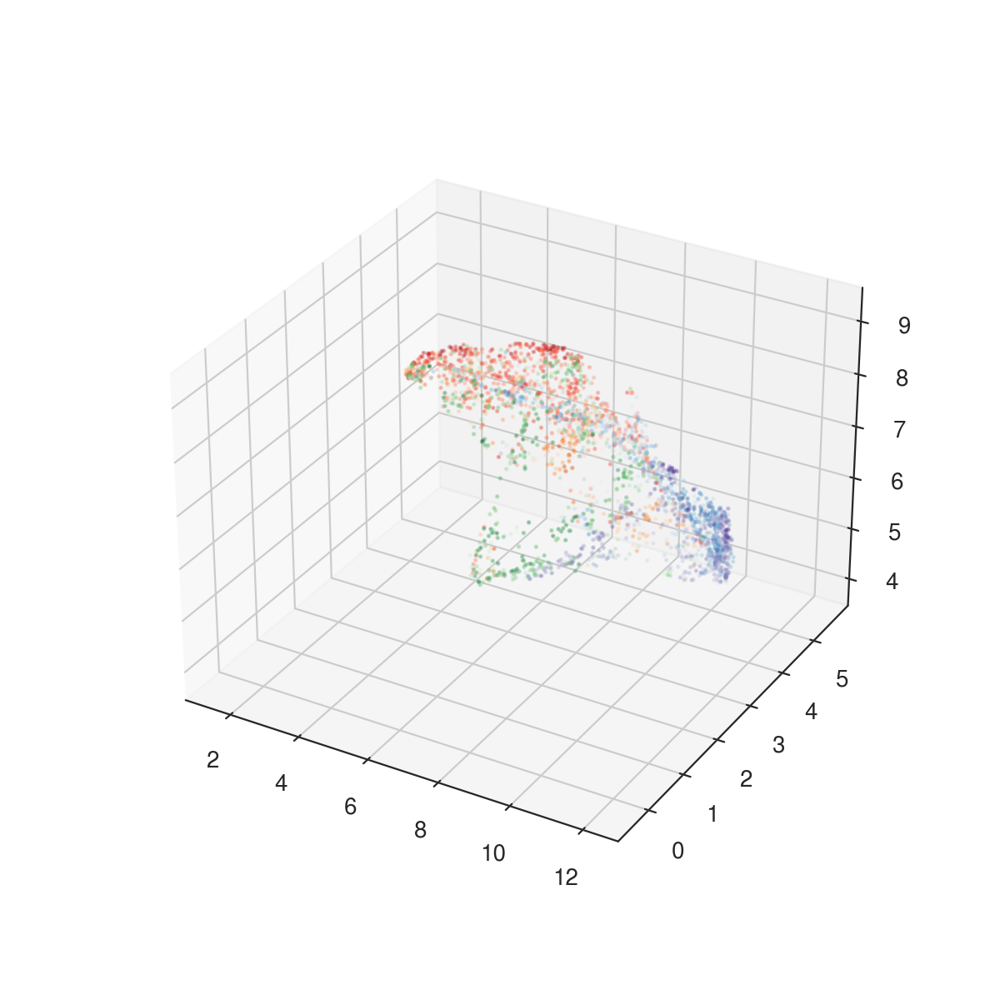

In [146]:
display_gt_umaps(umap_df, prop_df_dummy, indices={0,1,2,3,4})

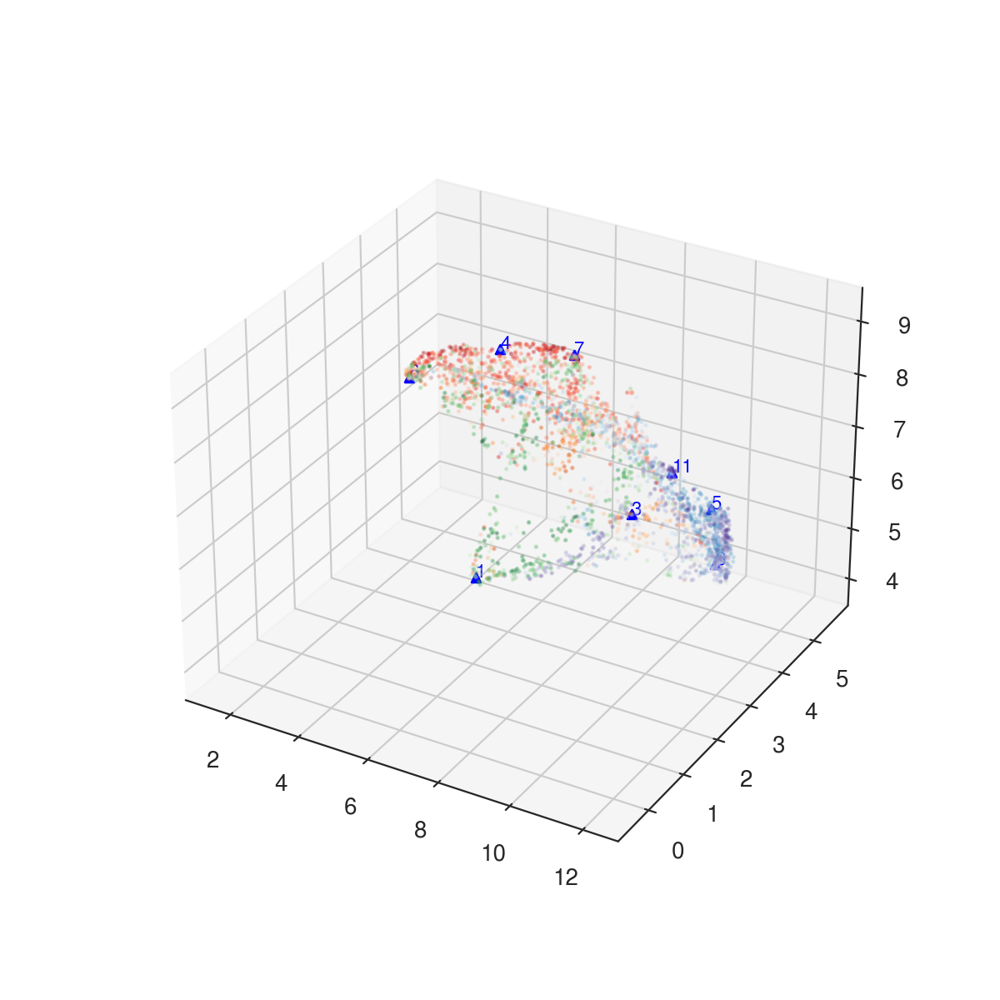

In [112]:
display_gt_umaps(umap_df, prop_df_dummy, indices={0,1,2,3,4}, n_arches=8, disp_arche=True)

---

Append archetypal markers to signatures based on best anchor-archetype mapping, Calculate updated anchors:

In [16]:
gene_sig_arch = gene_sig.copy()

for cell_type in map_dict.keys():
    arch = map_dict[cell_type]
    gene_sig_arch = utils.append_sigs(gene_sig_arch, cell_type, markers_df[arch], n_genes=30)

visium_args = utils.VisiumArguments(adata,
                                    adata_normed,
                                    gene_sig_arch,
                                    img_metadata,
                                    window_size=1,
                                    sample_id=sample_id
                                   )

adata, adata_normed = visium_args.get_adata()
anchors_df = visium_args.get_anchors()

[2023-07-13 15:18:29] Subsetting highly variable & signature genes ...
[2023-07-13 15:18:36] Smoothing library size by taking averaging with neighbor spots...
[2023-07-13 15:18:37] Retrieving & normalizing signature gene expressions...
[2023-07-13 15:18:37] Identifying anchor spots (highly expression of specific cell-type signatures)...


In [18]:
n_repeats = 3
epochs = 200
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')

model, loss = utils.run_starfysh(visium_args,
                                 n_repeats=n_repeats,
                                 epochs=epochs,
                                 alpha_mul=50,
                                 poe=False,
                                 device=device)

[2023-07-13 15:18:49] Running Starfysh with 3 restarts, choose the model with best parameters...
[2023-07-13 15:18:49]  ===  Restart Starfysh 1 === 

[2023-07-13 15:18:49] Initializing model parameters...
[2023-07-13 15:19:03] Epoch[10/200], train_loss: 1881.9666, train_reconst: 1804.1431, train_u: 16.0582,train_z: 25.6702,train_c: 34.0779,train_l: 2.0172
[2023-07-13 15:19:16] Epoch[20/200], train_loss: 1792.2046, train_reconst: 1719.3052, train_u: 14.6268,train_z: 27.3551,train_c: 28.4924,train_l: 2.4251
[2023-07-13 15:19:30] Epoch[30/200], train_loss: 1733.1430, train_reconst: 1662.8394, train_u: 13.7218,train_z: 27.8353,train_c: 26.0870,train_l: 2.6595
[2023-07-13 15:19:44] Epoch[40/200], train_loss: 1709.3952, train_reconst: 1640.9338, train_u: 13.1334,train_z: 27.8647,train_c: 24.5409,train_l: 2.9224
[2023-07-13 15:19:57] Epoch[50/200], train_loss: 1680.4302, train_reconst: 1612.9036, train_u: 12.7361,train_z: 28.0862,train_c: 23.6540,train_l: 3.0503
[2023-07-13 15:20:11] Epoch[60

Parse results:

In [19]:
inference_outputs, generative_outputs = sf_model.model_eval(model,
                                                            adata,
                                                            visium_args,
                                                            poe=False,
                                                            device=device)

# Deconvolution prediction
prop_pred_arche_df = pd.DataFrame(adata.obsm['qc_m'], index=adata.obs_names, columns=gene_sig.columns)

**Starfysh deconvolution (signature w/ archetype)**

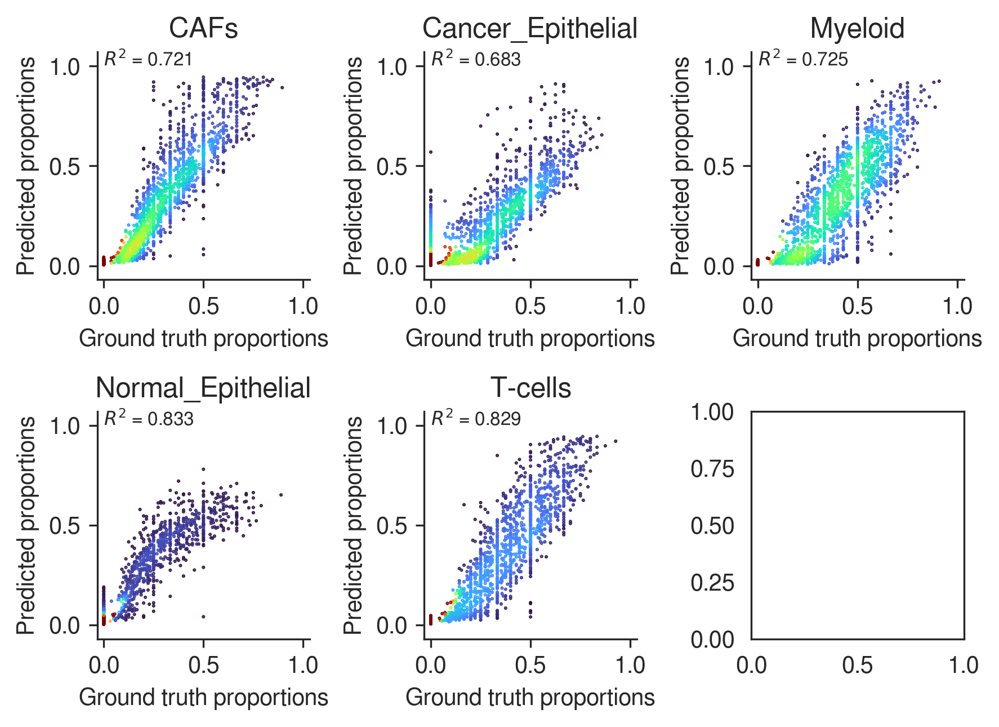

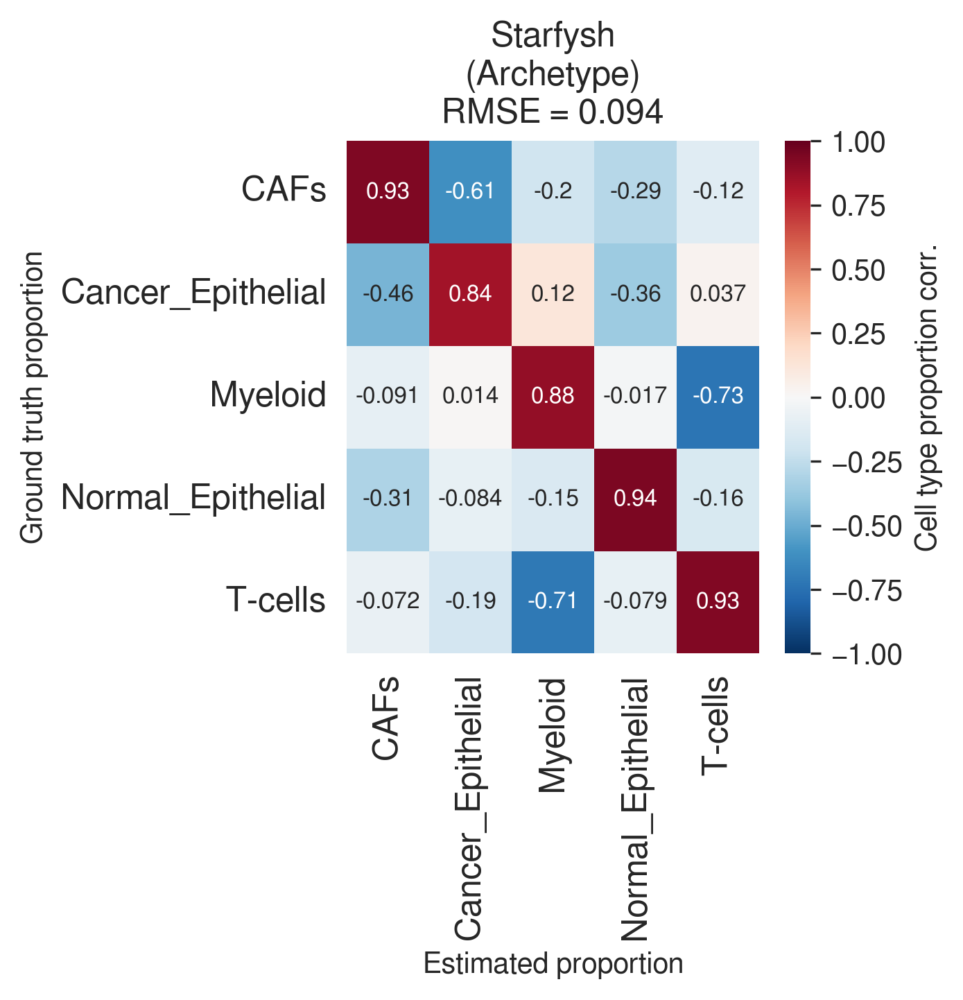

In [29]:
benchmark_utils.disp_prop_scatter(
    prop_df, 
    prop_pred_arche_df,
    outdir='../../plot_files/starfysh_revision/',
    filename='simu_5_starfysh_arche_scatter',
    savefig=False,
    format='svg'
)
benchmark_utils.disp_corr(
    prop_df,
    prop_pred_arche_df,
    fontsize=8,
    outdir='../../plot_files/starfysh_revision/',
    title='Starfysh\n(Archetype)',
    filename='simu_5_starfysh_arche',
    savefig=False,
    format='svg'
)

Spatial plots & UMAP of Z:

In [25]:
def disp_spatial(prop):
    nrow = int(np.sqrt(len(prop)))
    nfactors = prop.shape[1]
    fig, axes = plt.subplots(3, nfactors//2, figsize=(1.8*nfactors, 12), dpi=300)
    
    r = 0
    c = 0
    
    for i, factor in enumerate(prop.columns):
        ax = axes[r, c]
        pattern = prop.iloc[:, i].values.reshape(nrow, -1, order='A')
        sns.heatmap(pattern, annot=False, vmin=0, vmax=1, ax=ax)
        ax.set_title(factor, fontsize=15)
        ax.axis('off')
        
        if c < nfactors//2-1:
            c += 1
        else:
            c = 0
            r += 1
        
    fig.tight_layout()
    plt.show()
    
    return fig, axes

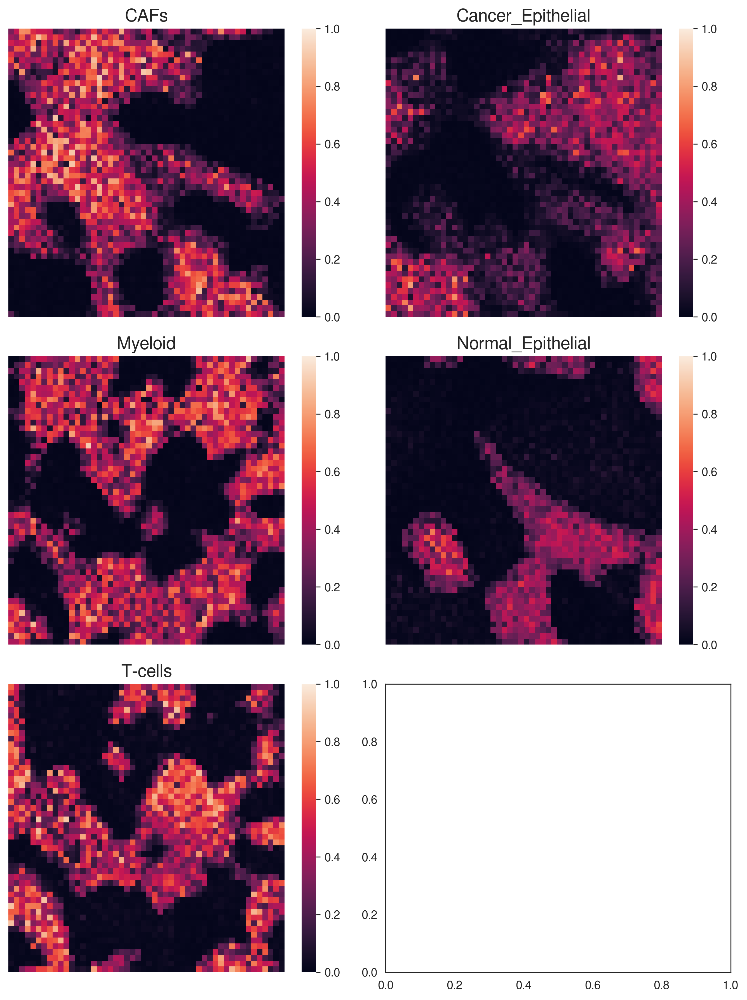

In [26]:
fig, axes = disp_spatial(prop_pred_arche_df)

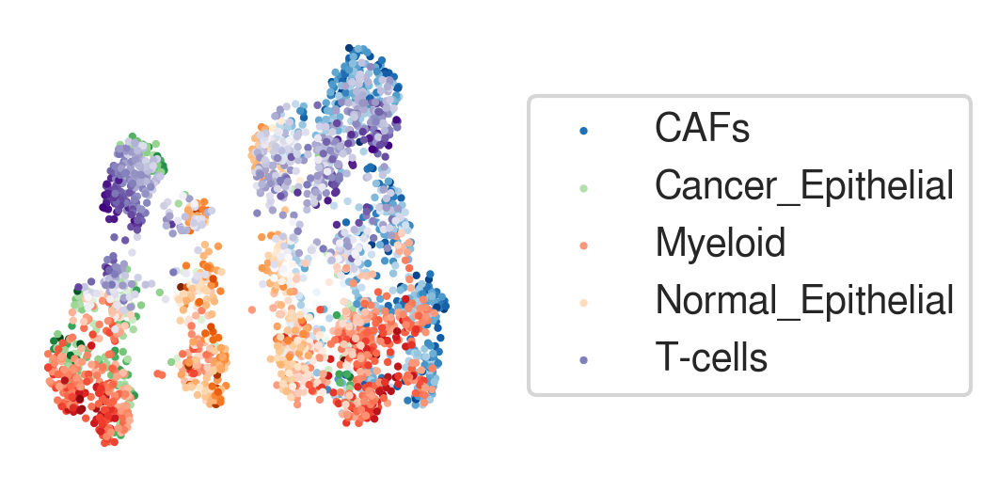

In [27]:
qz_u = post_analysis.get_z_umap(adata.obsm['qz_m'])
fig, ax = post_analysis.plot_type_all(inference_outputs, qz_u, prop_df, figsize=(2, 2))

In [34]:
fig.savefig('../../plot_files/starfysh_revision/fig1d_qz_arche.png', dpi=300, bbox_inches='tight')

##### (c). Starfysh with image integration (w/ simulated H&E)

Load paired image:

In [12]:
img_metadata = utils.preprocess_img(data_path,
                                    sample_id,
                                    adata_index=adata.obs.index,
                                    hchannel=True)

img, map_info, scalefactor = img_metadata['img'], img_metadata['map_info'], img_metadata['scalefactor']
map_info = map_info[['array_row', 'array_col']].astype(float)

In [13]:
use_archetype = True

if use_archetype:
    visium_args_poe = utils.VisiumArguments(adata,
                                            adata_normed,
                                            gene_sig_arch,
                                            img_metadata,
                                            window_size=1,
                                            sample_id=sample_id)
else:
    visium_args_poe = utils.VisiumArguments(adata,
                                            adata_normed,
                                            gene_sig,
                                            img_metadata,
                                            window_size=1,
                                            sample_id=sample_id)    

[2023-07-11 18:16:44] Subsetting highly variable & signature genes ...
[2023-07-11 18:16:50] Smoothing library size by taking averaging with neighbor spots...
[2023-07-11 18:16:51] Retrieving & normalizing signature gene expressions...
[2023-07-11 18:16:52] Identifying anchor spots (highly expression of specific cell-type signatures)...


**Starfysh with only archetypal analysis & image integration**

In [35]:
n_repeats = 3
epochs = 200
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')

model_poe, loss = utils.run_starfysh(visium_args_poe,
                                     n_repeats=n_repeats,
                                     alpha_mul=50,
                                     epochs=epochs,
                                     poe=True,
                                     device=device)

[2023-07-10 22:23:34] Running Starfysh with 3 restarts, choose the model with best parameters...
[2023-07-10 22:23:34]  ===  Restart Starfysh 1 === 

[2023-07-10 22:23:34] Initializing model parameters...
[2023-07-10 22:24:00] Epoch[10/200], train_loss: 18638.5958, train_reconst: 18263.6330, train_u: 31.9547,train_z: 30.2257,train_c: 310.2966,train_l: 2.4858
[2023-07-10 22:24:26] Epoch[20/200], train_loss: 17702.1316, train_reconst: 17330.0501, train_u: 28.5934,train_z: 34.1529,train_c: 306.4578,train_l: 2.8773
[2023-07-10 22:25:00] Epoch[30/200], train_loss: 17144.9157, train_reconst: 16772.0130, train_u: 26.0519,train_z: 40.9184,train_c: 302.7745,train_l: 3.1579
[2023-07-10 22:25:32] Epoch[40/200], train_loss: 17231.6746, train_reconst: 16866.2519, train_u: 24.1480,train_z: 43.6466,train_c: 294.4278,train_l: 3.2002
[2023-07-10 22:25:58] Epoch[50/200], train_loss: 16994.1951, train_reconst: 16618.1195, train_u: 22.7571,train_z: 49.2877,train_c: 300.8738,train_l: 3.1571
[2023-07-10 22:

In [36]:
adata, adata_normed = visium_args_poe.get_adata()
inference_outputs, generative_outputs = sf_model.model_eval(model_poe,
                                                            visium_args_poe.adata,
                                                            visium_args_poe,
                                                            poe=True,
                                                            device=device)


prop_pred_poe_df = pd.DataFrame(adata.obsm['qc_m'], index=adata.obs_names, columns=gene_sig.columns)


In [24]:
prop_pred_poe_df = pd.read_csv('../simulation/results/Starfysh_simu_5_poe.csv', index_col=[0])

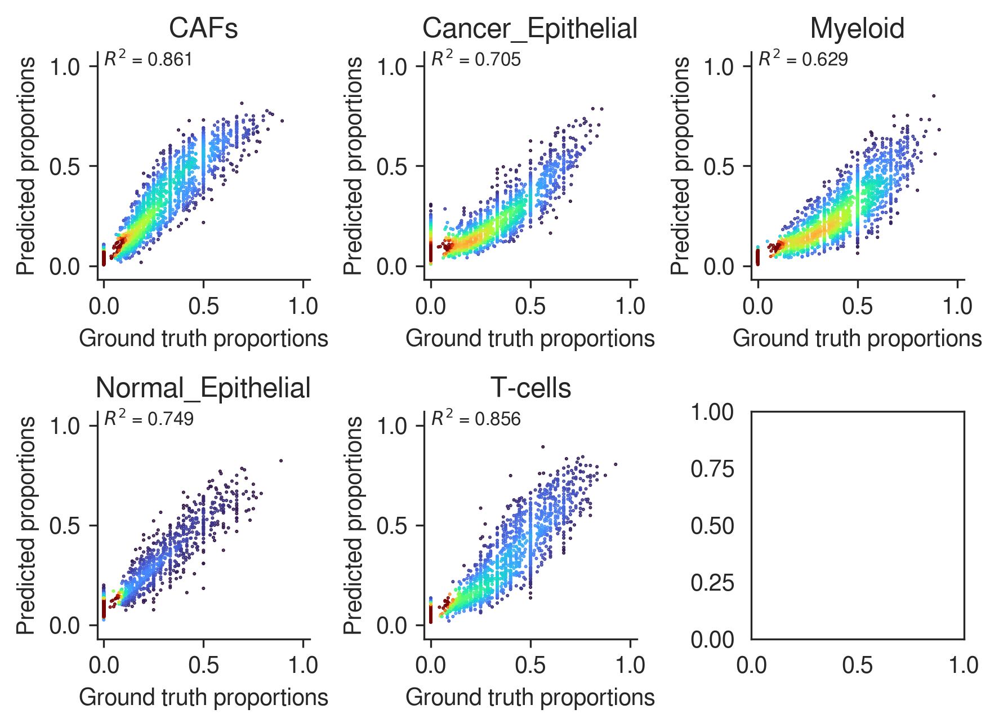

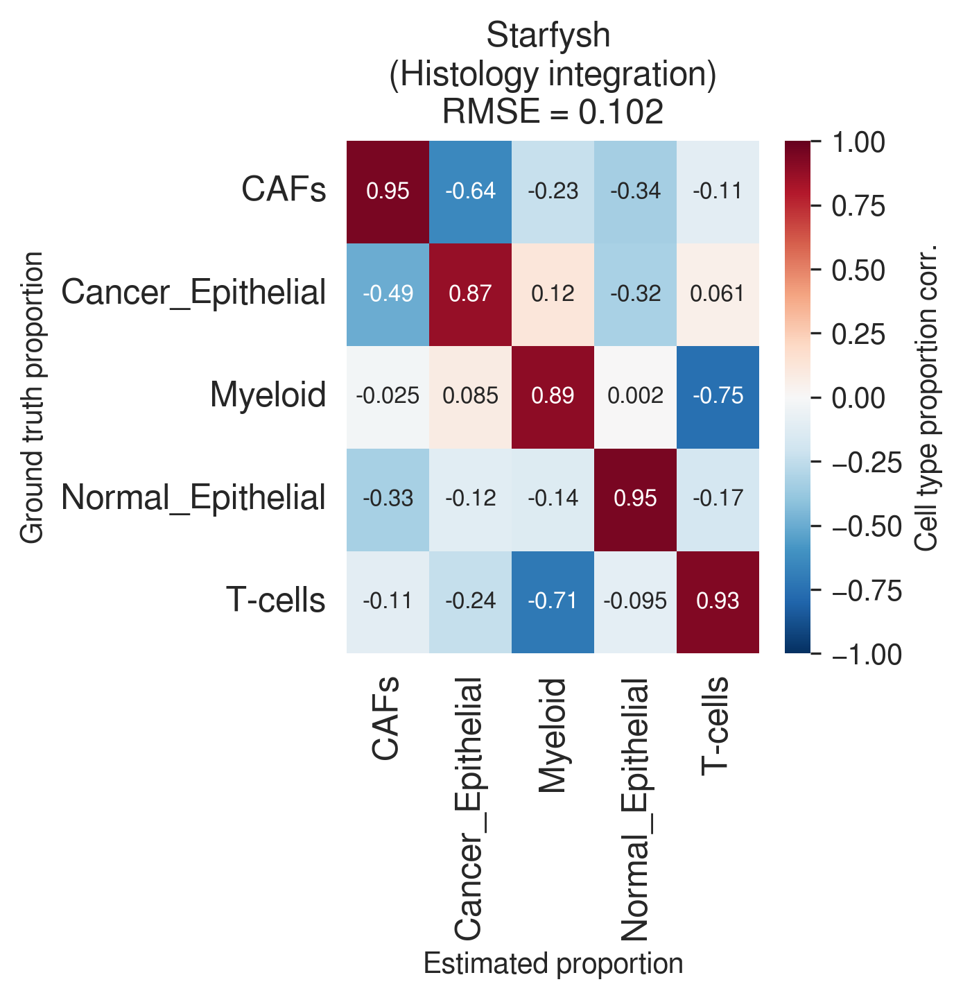

In [27]:
benchmark_utils.disp_prop_scatter(
    prop_df, 
    prop_pred_poe_df,
    outdir='../../plot_files/starfysh_revision/',
    filename='simu_5_starfysh_poe_scatter',
    savefig=False,
    format='png'
)

benchmark_utils.disp_corr(
    prop_df,
    prop_pred_poe_df,
    fontsize=8,
    title='Starfysh \n(Histology integration)',
    outdir='../../plot_files/starfysh_revision/',
    filename='simu_5_starfysh_poe',
    savefig=False,
    format='png'
)

Save priors & prediction matrices to output (for future RMSE plots):

In [19]:
out_path = '../simulation/results/'

prop_pred_df.to_csv(os.path.join(out_path, 'Starfysh_simu_5.csv'), index=True)
prop_pred_arche_df.to_csv(os.path.join(out_path, 'Starfysh_simu_5_arche.csv'), index=True)
prop_pred_poe_df.to_csv(os.path.join(out_path, 'Starfysh_simu_5_poe.csv'), index=True)

**Spatial reconstruction & q(z) plots**

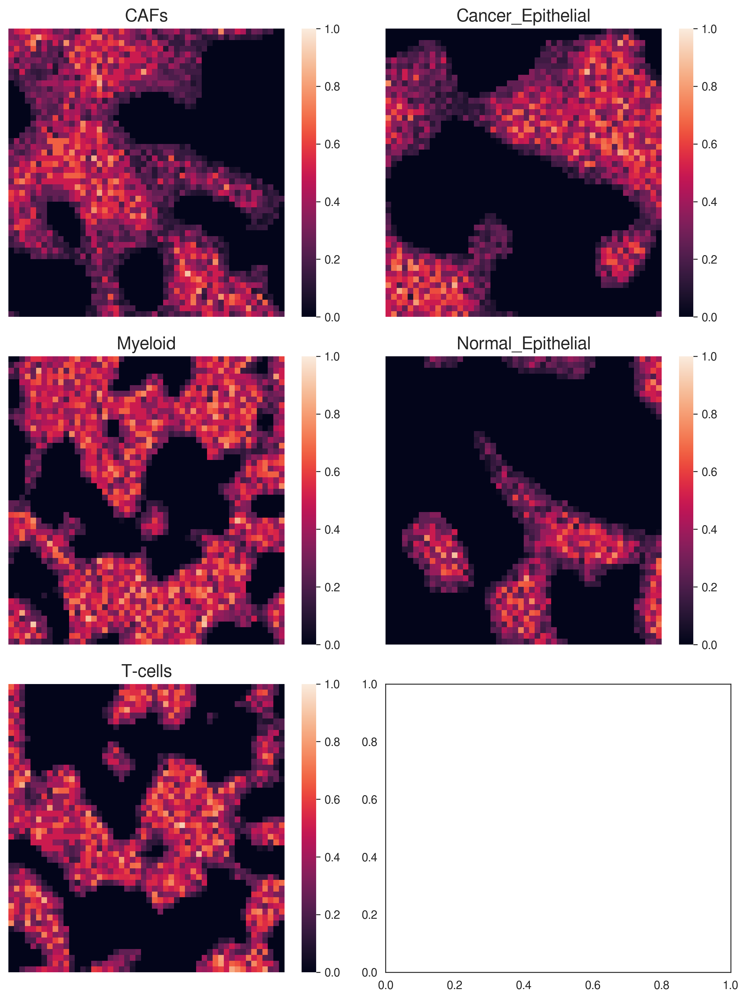

In [34]:
fig, axes = disp_spatial(prop_df)
# fig.savefig('../../plot_files/starfysh_revision/fig1d_spatial_gt.svg', dpi=300, bbox_inches='tight')

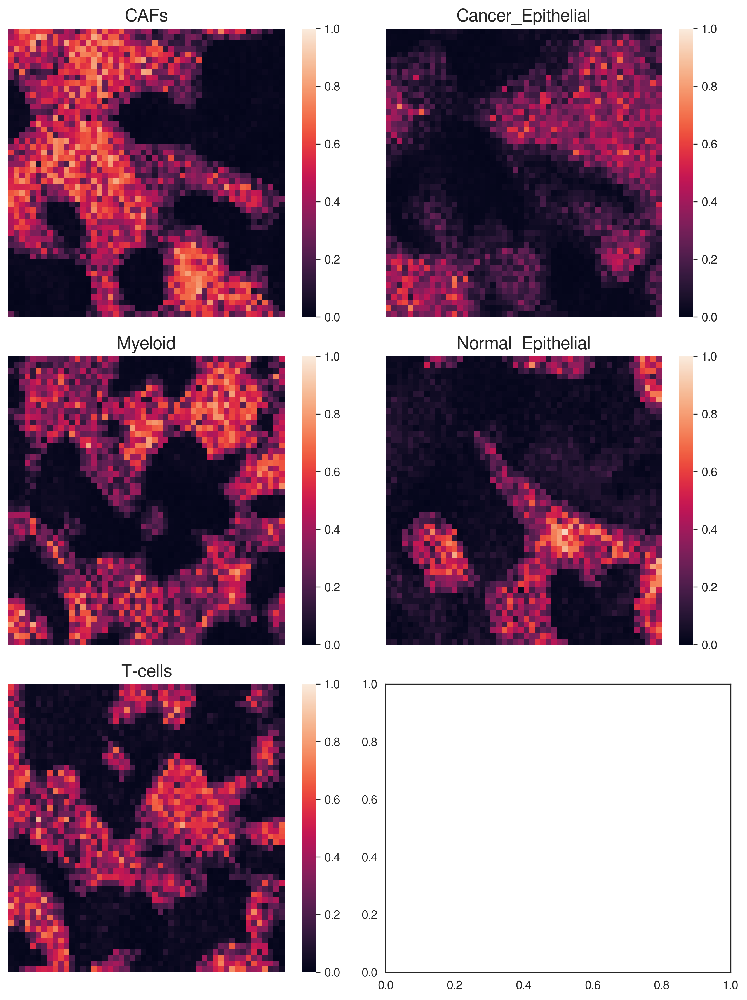

In [35]:
fig, axes = disp_spatial(prop_pred_poe_df)
# fig.savefig('../../plot_files/starfysh_revision/fig1d_spatial_reconst.svg', dpi=300, bbox_inches='tight')

Spatial image reconstruction with PoE:

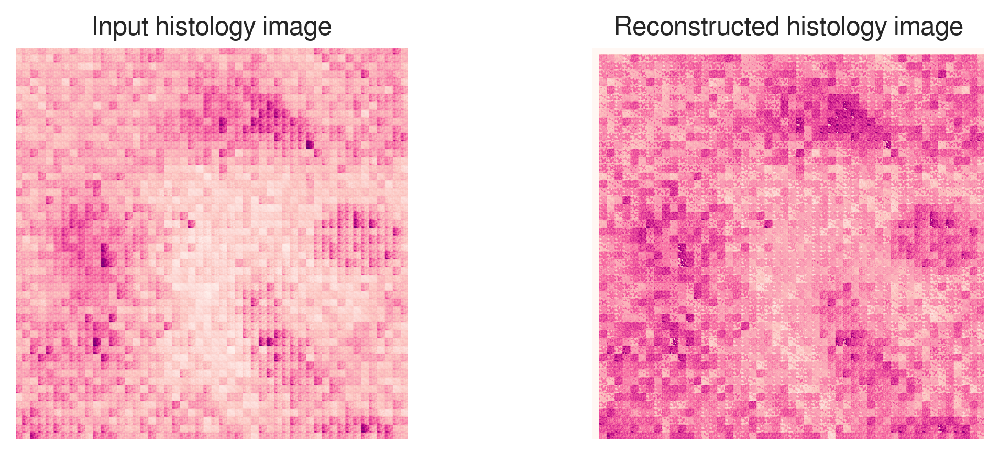

In [68]:
img_pred = utils.get_reconst_img(visium_args_poe, adata.obsm['py_m'])

fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(8, 3), dpi=300)
ax1.imshow(rgb2gray(visium_args_poe.img), cmap='RdPu')
ax1.set_title('Input histology image')
ax1.axis('off')

ax2.imshow(rgb2gray(img_), cmap='RdPu')
ax2.set_title('Reconstructed histology image')
ax2.axis('off')

plt.tight_layout()
plt.show()

In [69]:
fig.savefig('../../plot_files/starfysh_revision/fig1d_img_reconst.svg', dpi=300, bbox_inches='tight')

##### (d). Benchmark with other methods

Load spatial deconvolution results from other methods:

In [8]:
%ls ../simulation/results

Bayesprism_44971_proportion.csv       DestVI_proportion_simu_5.csv
Bayesprism_proportion_simu_10.csv     Starfysh_44971_proportions.csv
Bayesprism_proportion_simu_5.csv      Starfysh_arche_proportions.csv
BayesTME_proportion_simu_10.csv       Starfysh_simu_5_arche.csv
BayesTME_proportion_simu_5.csv        Starfysh_simu_5.csv
CARD_proportion_simu_10.csv           Starfysh_simu_5_poe.csv
CARD_proportion_simu_5.csv            STdeconvolve_44971_proportion.csv
CARD_proportion_simu_5_sc.csv         STDeconvolve_proportion_simu_10.csv
Cell2Location_44971_proportion.csv    STDeconvolve_proportion_simu_5.csv
Cell2Location_proportion_simu_10.csv  Tangram_proportion_simu_10.csv
Cell2Location_proportion_simu_5.csv   Tangram_proportion_simu_5.csv
DestVI_proportion_simu_10.csv


In [343]:
res_path = '../simulation/results/'

# Starfysh
prop_pred_starfysh_df = pd.read_csv(os.path.join(res_path, 'Starfysh_simu_5_arche.csv'), index_col=[0])

# Cell2Location
prop_pred_cell2loc_df = pd.read_csv(os.path.join(res_path, 'Cell2Location_proportion_simu_5.csv'), index_col=[0])

# STDeconvolve
prop_pred_stdeconv_df = pd.read_csv(os.path.join(res_path, 'STDeconvolve_proportion_simu_5.csv'), index_col=[0])

# CARD (ref-free)
prop_pred_card_free_df = pd.read_csv(os.path.join(res_path, 'CARD_proportion_simu_5.csv'), index_col=[0])

# DestVI
prop_pred_destvi_df = pd.read_csv(os.path.join(res_path, 'DestVI_proportion_simu_5.csv'), index_col=[0])


# Tangram
prop_pred_tangram_df = pd.read_csv(os.path.join(res_path, 'Tangram_proportion_simu_5.csv'), index_col=[0])

# BayesTME
prop_pred_bayestme_df = pd.read_csv(os.path.join(res_path, 'BayesTME_proportion_simu_5.csv'), index_col=[0])

# BayesPrism
prop_pred_bayesprism_df = pd.read_csv(os.path.join(res_path, 'Bayesprism_proportion_simu_5.csv'), index_col=[0])
prop_pred_bayesprism_df.columns = ['CAFs', 'T-cells', 'Myeloid', 'Cancer_Epithelial', 'Normal_Epithelial']
prop_pred_bayesprism_df = prop_pred_bayesprism_df[prop_df.columns]

In [344]:
prop_pred_stdeconv_df = benchmark_utils.get_best_permute(prop_df, prop_pred_stdeconv_df)
prop_pred_card_free_df = benchmark_utils.get_best_permute(prop_df, prop_pred_card_free_df)
prop_pred_bayestme_df = benchmark_utils.get_best_permute(prop_df, prop_pred_bayestme_df)

Reference-based methods:

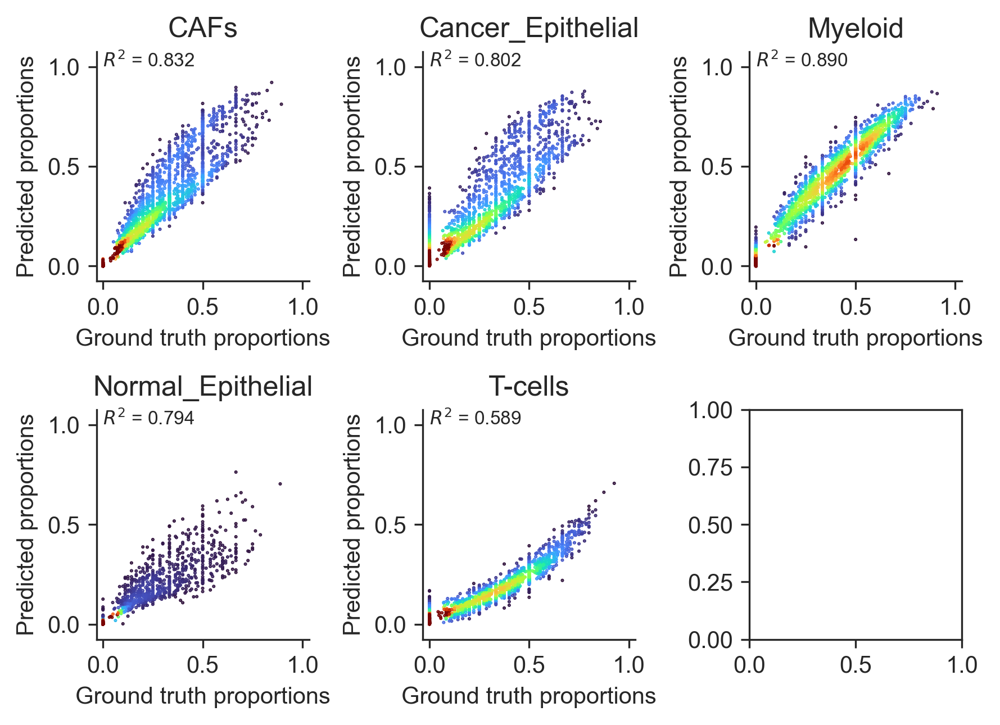

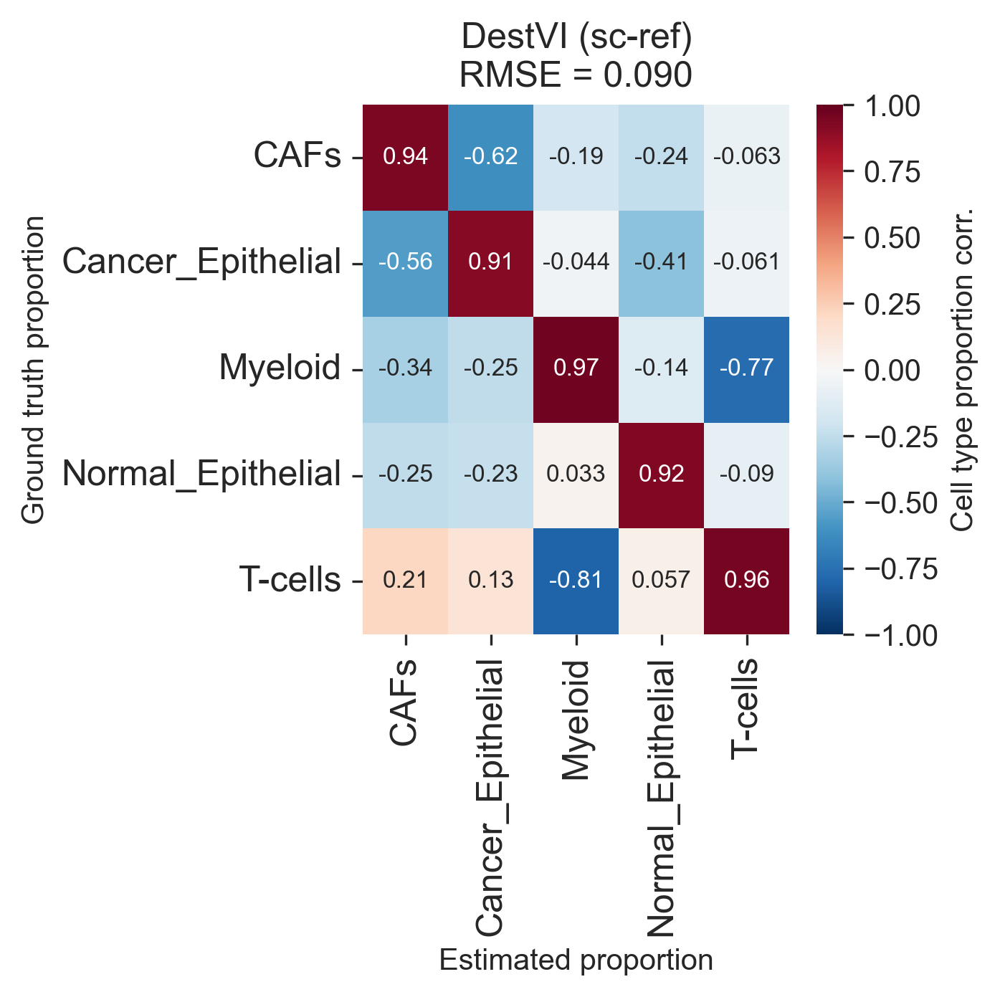

In [106]:
# DestVI
# Cell2Location
benchmark_utils.disp_prop_scatter(prop_df, prop_pred_destvi_df)
benchmark_utils.disp_corr(
    prop_df,
    prop_pred_destvi_df,
    fontsize=8, 
    title='DestVI (sc-ref)',
    outdir='../../plot_files/starfysh_revision/',
    filename='simu_5_destvi',
    savefig=True,
    format='svg'
)


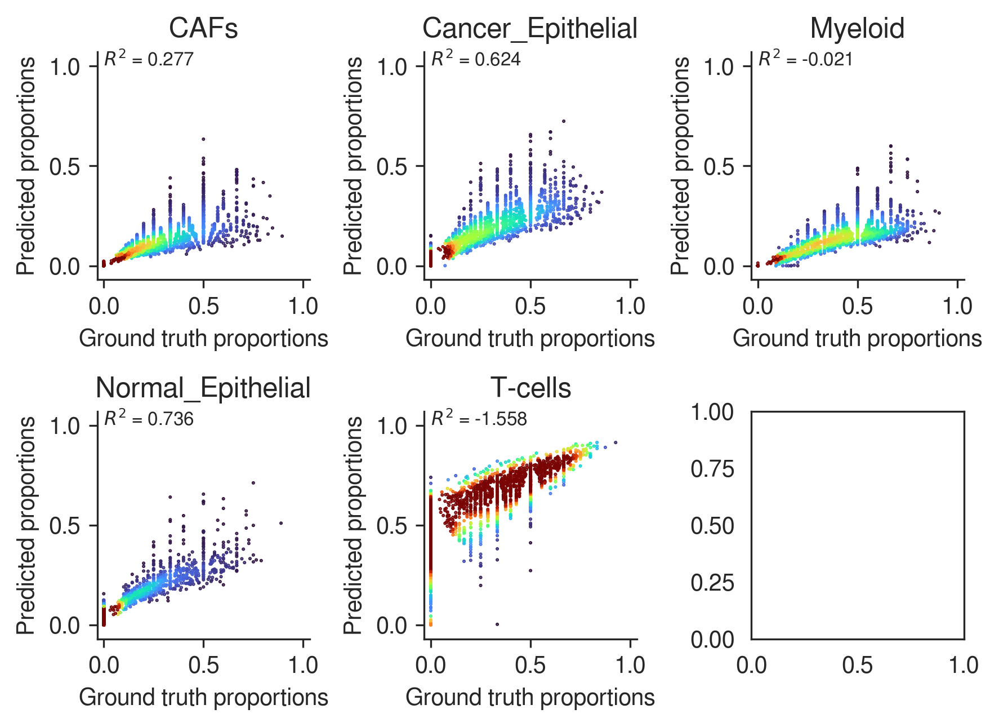

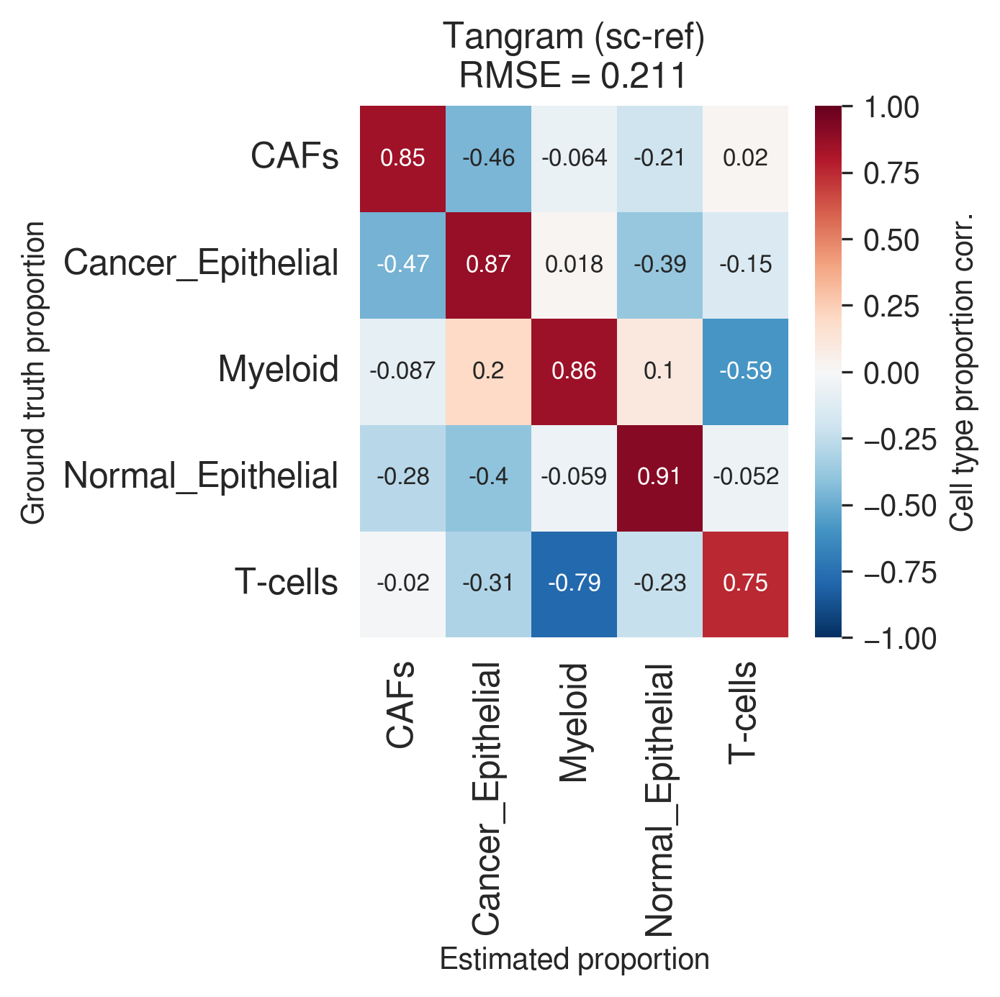

In [79]:
# Tangram
benchmark_utils.disp_prop_scatter(prop_df, prop_pred_tangram_df)
benchmark_utils.disp_corr(
    prop_df,
    prop_pred_tangram_df,
    fontsize=8, 
    title='Tangram (sc-ref)',
    outdir='../../plot_files/starfysh_revision/',
    filename='simu_5_tangram',
    savefig=True,
    format='png'
)

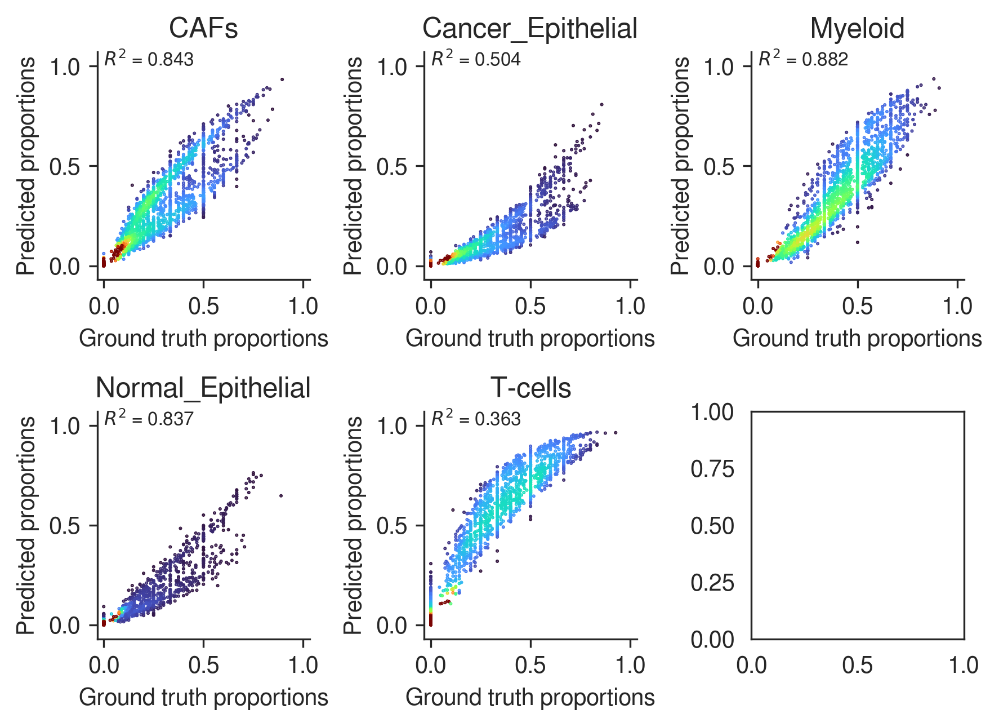

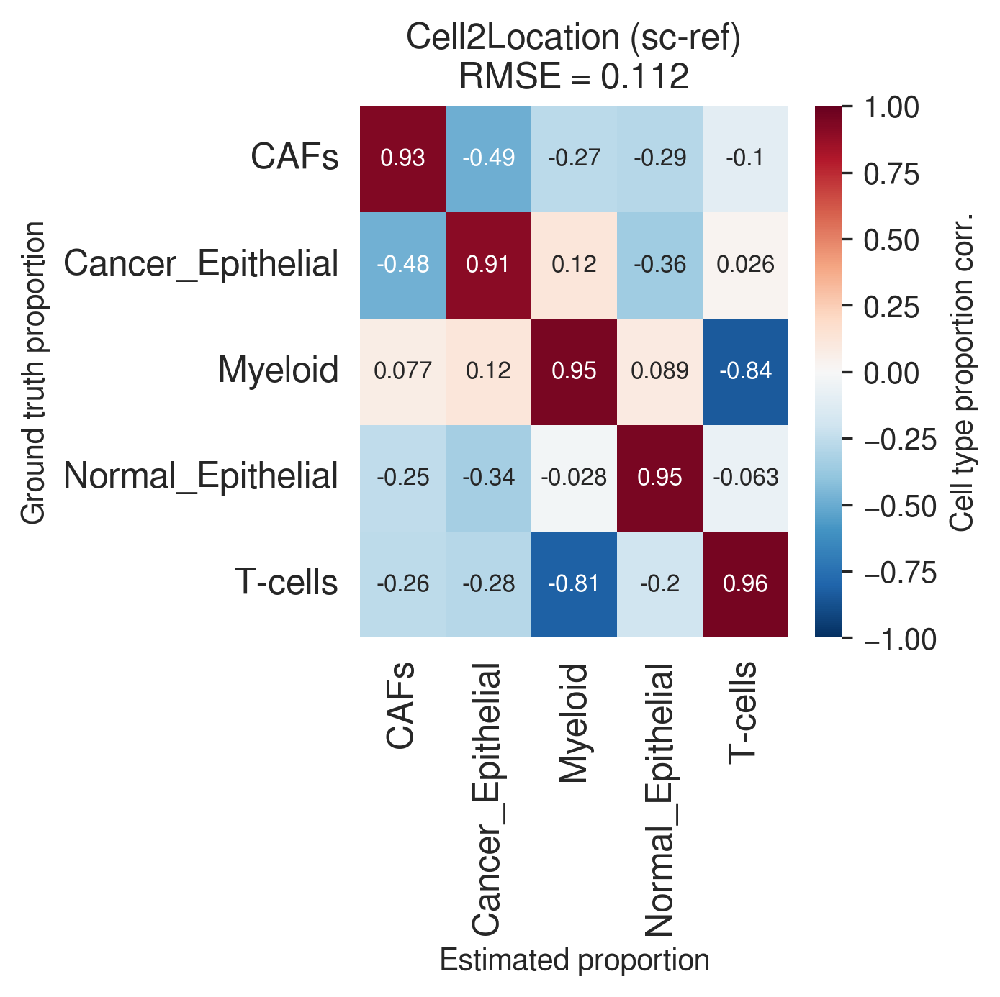

In [74]:
# Cell2Location
benchmark_utils.disp_prop_scatter(prop_df, prop_pred_cell2loc_df)
benchmark_utils.disp_corr(
    prop_df,
    prop_pred_cell2loc_df,
    fontsize=8, 
    title='Cell2Location (sc-ref)',
    outdir='../../plot_files/starfysh_revision/',
    filename='simu_5_cell2loc',
    savefig=True,
    format='png'
)

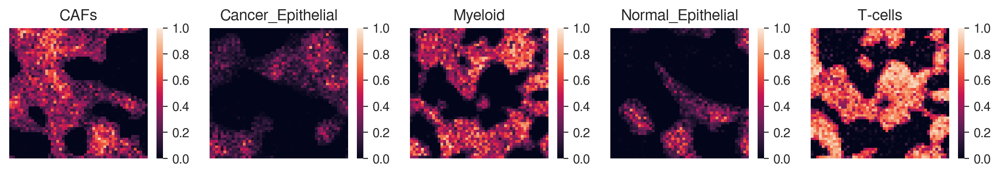

In [195]:
disp_spatial(prop_pred_cell2loc_df)

In [154]:
prop_pred_bayesprism_df.columns = ['CAFs', 'T-cells', 'Myeloid', 'Cancer_Epithelial', 'Normal_Epithelial']

,CAFs,T-cells,Myeloid,Cancer Epithelial,Normal Epithelial
location_0,0.361996,0.632715,0.001324,0.001364,0.002600
location_1,0.554868,0.437133,0.004102,0.002814,0.001083
location_2,0.588895,0.284856,0.113412,0.008677,0.004160
location_3,0.735444,0.011354,0.251053,0.001555,0.000594
location_4,0.480046,0.003713,0.513237,0.001796,0.001207
...,...,...,...,...,...
location_2495,0.450862,0.515414,0.005626,0.001398,0.026701
location_2496,0.239419,0.756065,0.003107,0.000659,0.000749
location_2497,0.536316,0.214489,0.007349,0.015493,0.226353
location_2498,0.290970,0.233338,0.117115,0.002315,0.356261


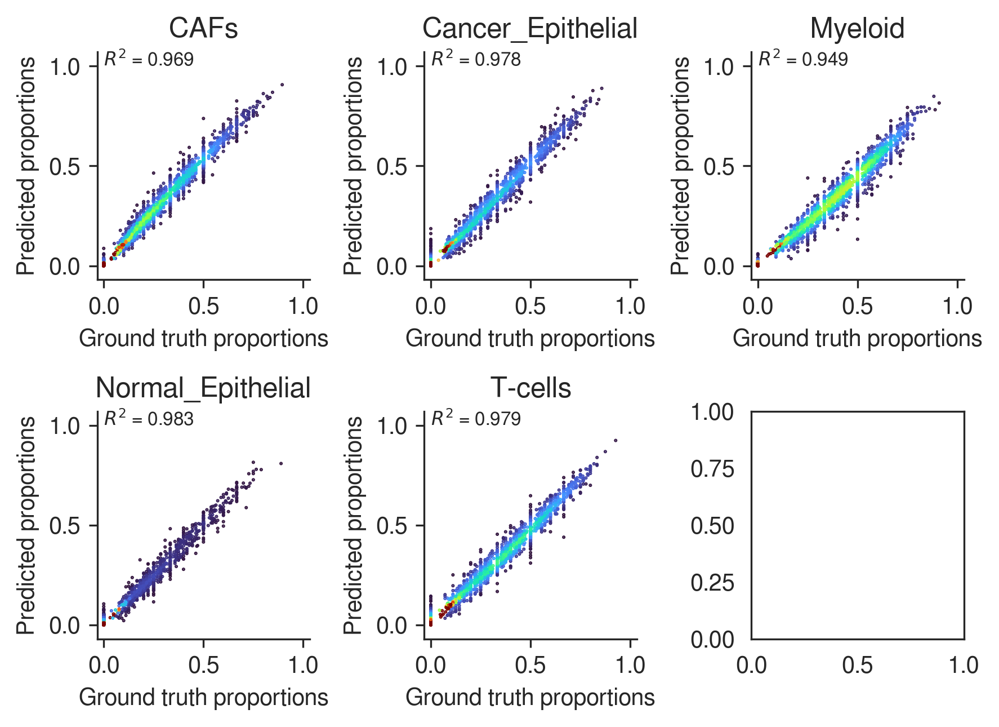

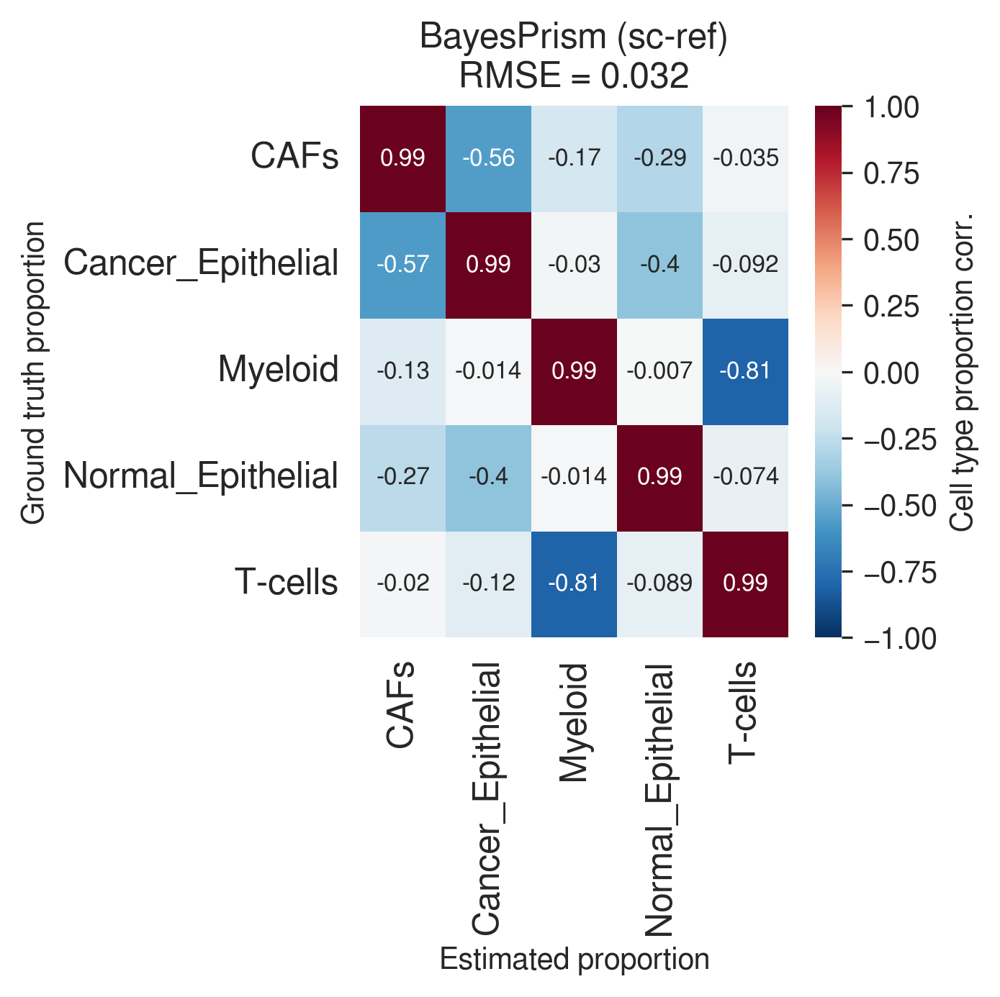

In [83]:
# BayesPrism
benchmark_utils.disp_prop_scatter(prop_df, prop_pred_bayesprism_df)
benchmark_utils.disp_corr(
    prop_df,
    prop_pred_bayesprism_df,
    fontsize=8, 
    title='BayesPrism (sc-ref)',
    outdir='../../plot_files/starfysh_revision/',
    filename='simu_5_bayesprism',
    savefig=True,
    format='png'
)

Reference-free methods:

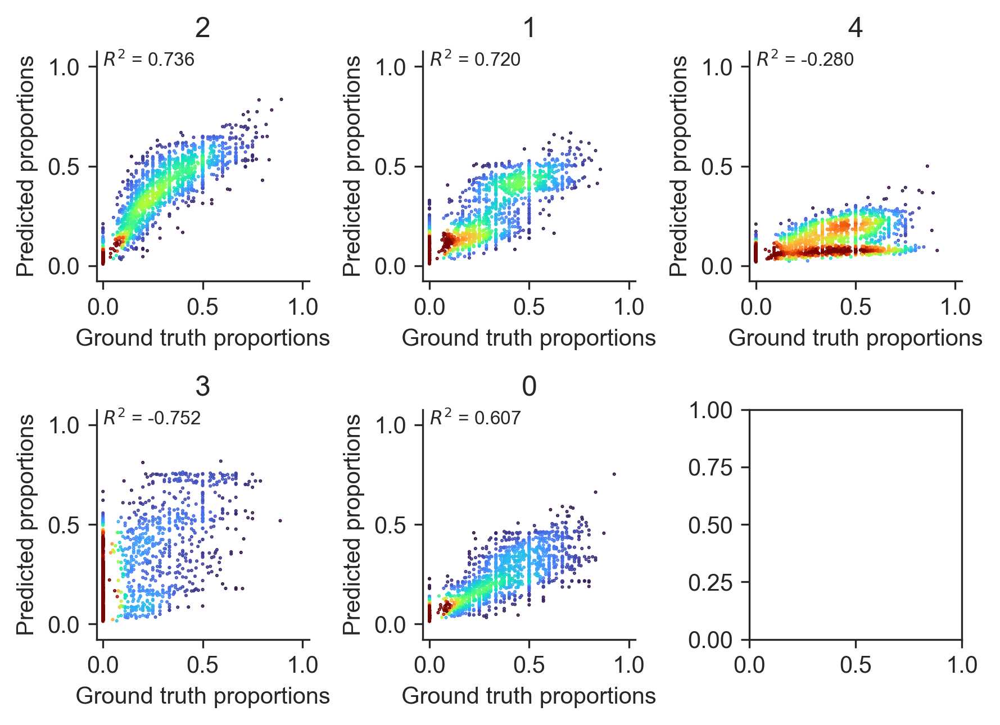

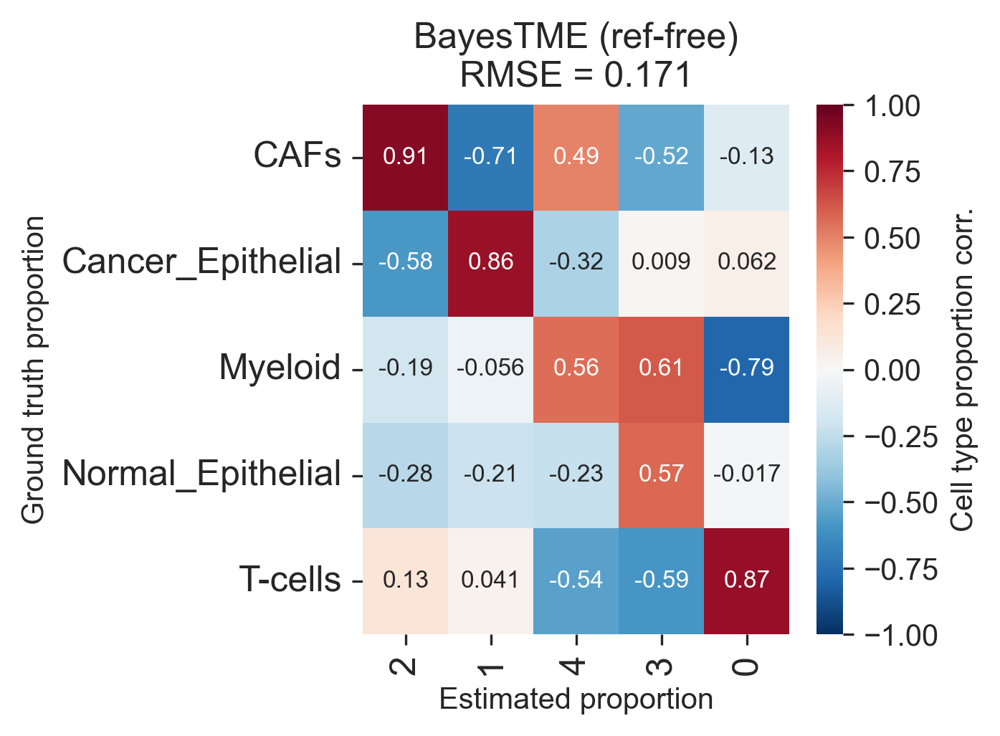

In [112]:
# BayesTME

benchmark_utils.disp_prop_scatter(prop_df, prop_pred_bayestme_df)
benchmark_utils.disp_corr(
    prop_df,
    prop_pred_bayestme_df,
    fontsize=8, 
    title='BayesTME (ref-free)',
    outdir='../../plot_files/starfysh_revision/',
    filename='simu_5_bayestme',
    savefig=True,
    format='png'
)

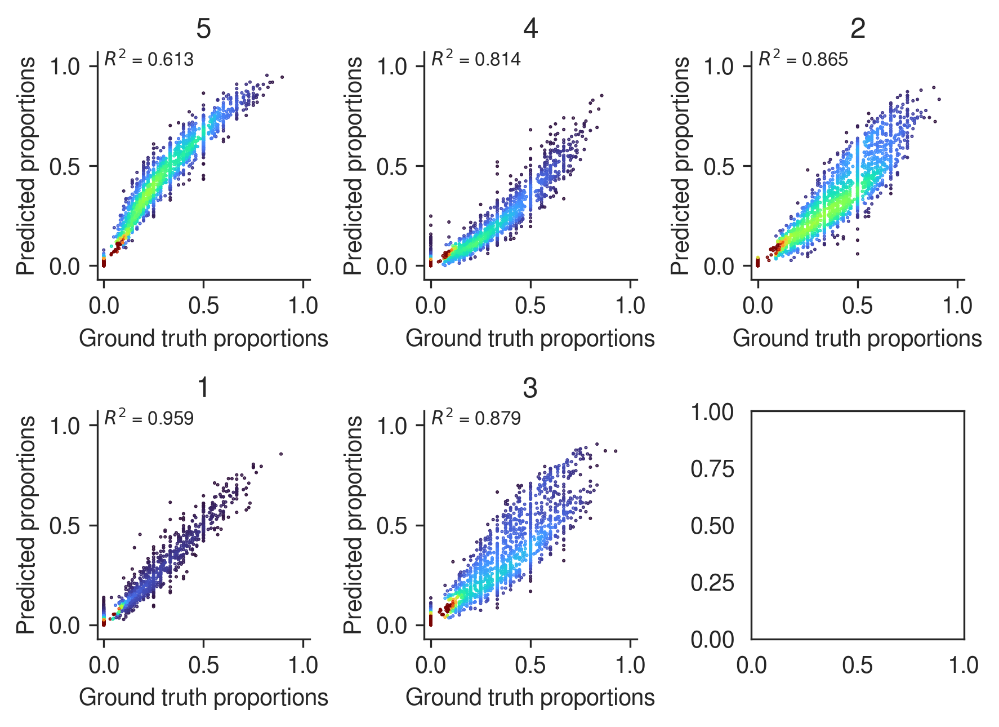

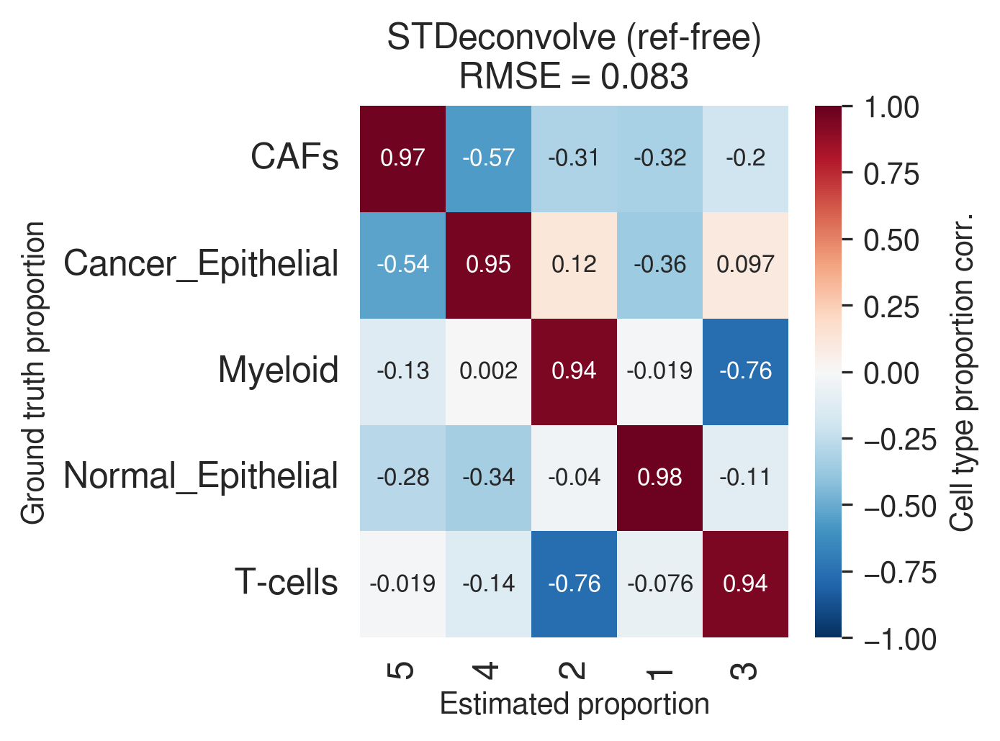

In [84]:
# STDeconvolve
benchmark_utils.disp_prop_scatter(prop_df, prop_pred_stdeconv_df)
benchmark_utils.disp_corr(
    prop_df, 
    prop_pred_stdeconv_df,
    fontsize=8,
    title='STDeconvolve (ref-free)',
    outdir='../../plot_files/starfysh_revision/',
    filename='simu_5_stdeconv',
    savefig=True,
    format='png'
)

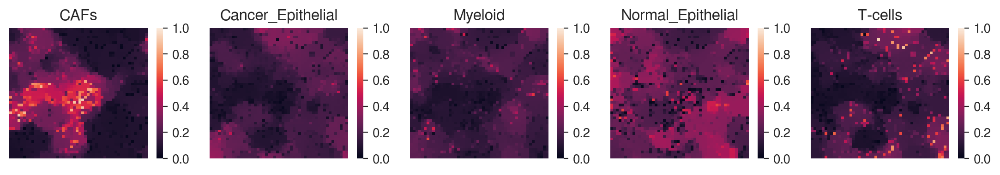

In [209]:
disp_spatial(prop_pred_bayestme_df)

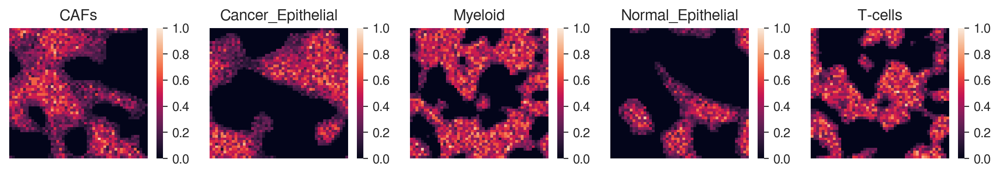

In [204]:
disp_spatial(prop_df)

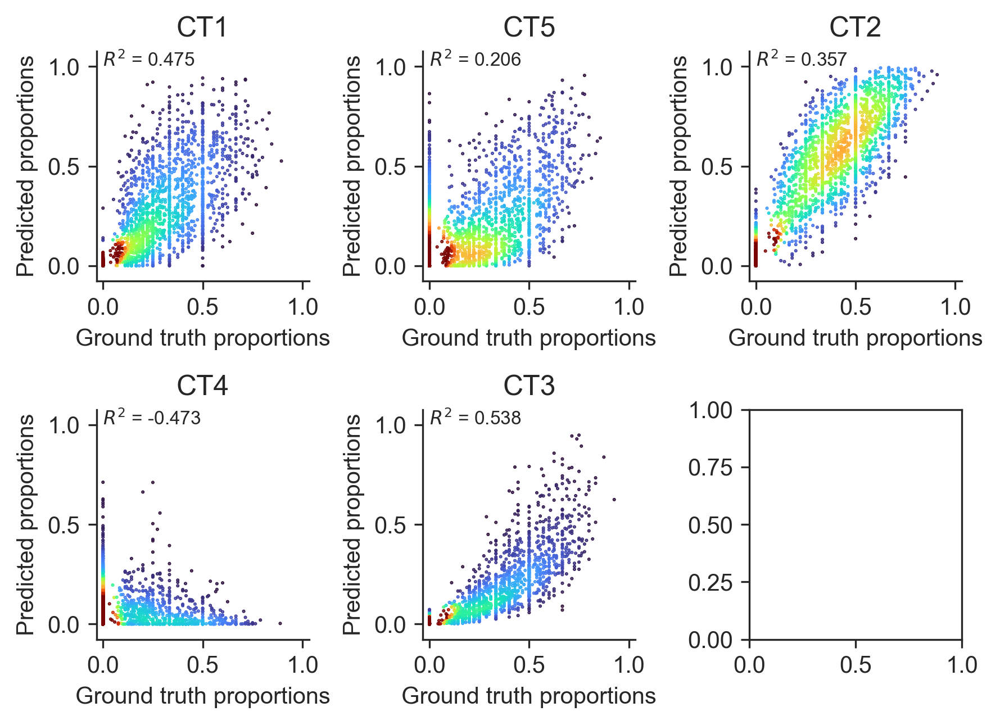

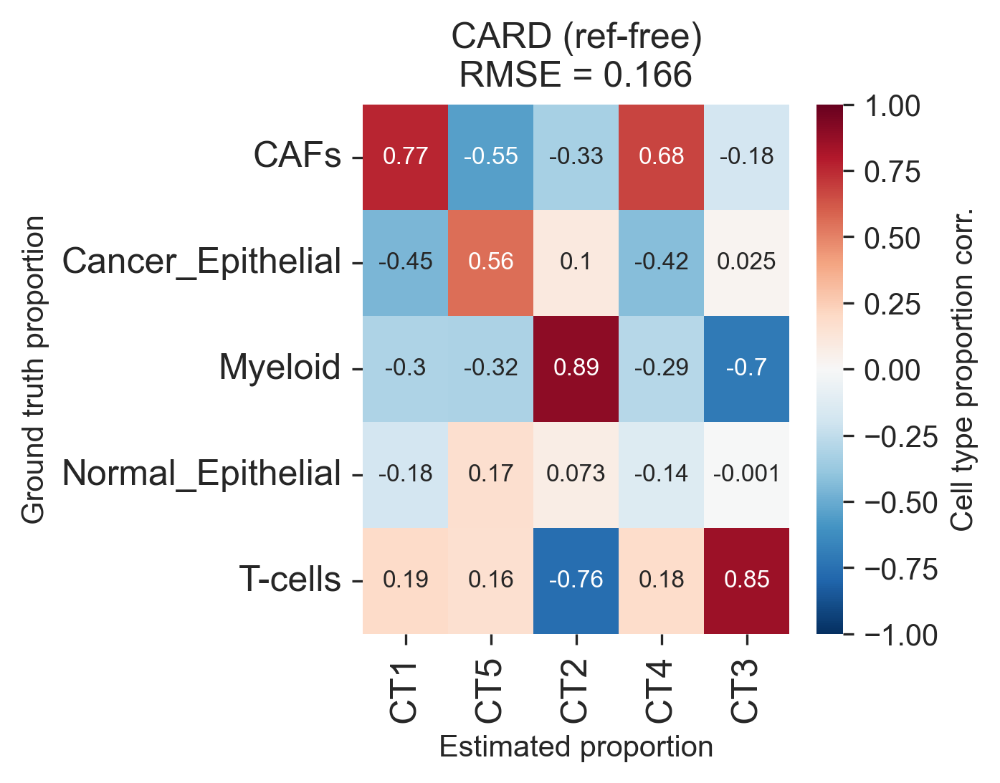

In [111]:
# CARD (ref-free)
benchmark_utils.disp_prop_scatter(prop_df, prop_pred_card_free_df)
benchmark_utils.disp_corr(
    prop_df,
    prop_pred_card_free_df,
    fontsize=8, 
    title='CARD (ref-free)',
    outdir='../../plot_files/starfysh_revision/',
    filename='simu_5_card_free',
    savefig=True,
    format='svg'
)

Violin plots of RMSE, Jensen-Shannon Divergence, etc.:

In [358]:
import torch
import torch.nn.functional as F
from scipy.spatial.distance import jensenshannon
from scipy.stats import ttest_ind, mannwhitneyu

In [345]:
def disp_metrics_violin(
    y_true,
    y_preds,
    labels,
    title=None,
    metric_name='RMSE',
    return_metrics=False):
    """
    Violinplot of per-spot metrics for each prediction against the ground-truth
    """
    n_spots, n_cts = y_true.shape
    if metric_name == 'RMSE':
        metrics = np.array([
            np.sqrt(((y_true.values-y_pred.values)**2).sum(1) / n_cts)
            for y_pred in y_preds
        ])
        
    elif metric_name == 'JSD':
        metrics = np.array([
            jensenshannon(y_true.values, y_pred.values, axis=1)
            for y_pred in y_preds
        ])
    else:
        raise NotImplementedError(metric_name)

    lbls = np.repeat(labels, n_spots)
    df = pd.DataFrame({
        metric_name: metrics.flatten(),
        'Method': lbls
    })
    
    fig, ax = plt.subplots(figsize=(10, 4), dpi=300)
    g = sns.violinplot(x='Method', y=metric_name, data=df, scale='width', ax=ax)    
    for violin in ax.collections:
        violin.set_alpha(0.5)
    g = sns.stripplot(x='Method', y=metric_name, data=df, color='black', alpha=0.2, s=1,  ax=ax)

    
    #g = sns.swarmplot(x='Method', y=metric_name, data=df, ax=ax)
    g.set_xticklabels(labels, rotation=45, fontsize=12)
    g.set_xlabel('Method', fontsize=15)
    g.set_ylabel(metric_name,fontsize=15)
    plt.suptitle(title, fontsize=20)
    plt.show()
    
    plt.setp(g.collections, alpha=.1)

    return metrics if return_metrics else None

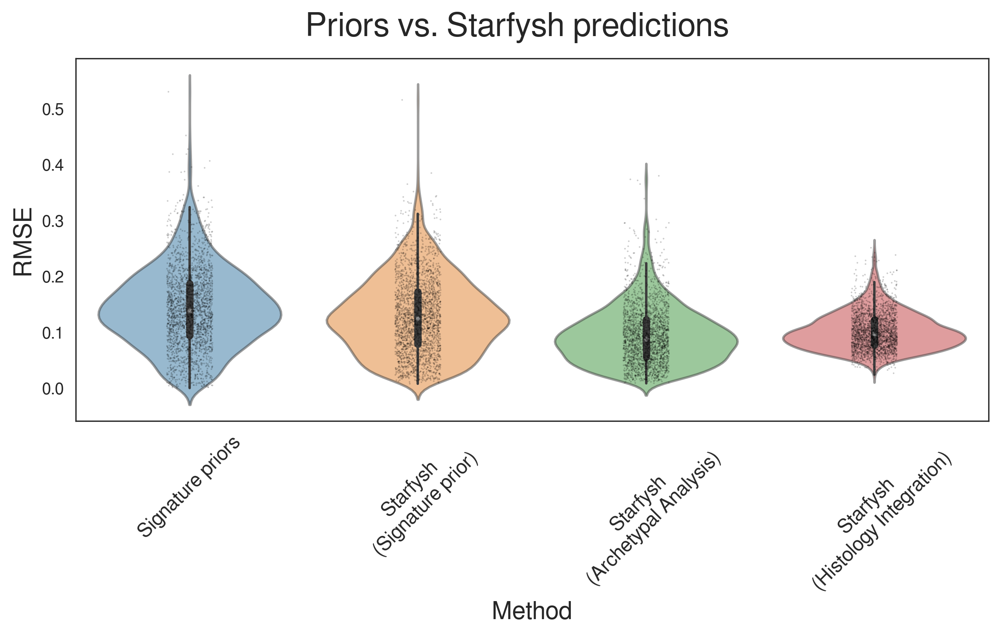

In [68]:
prop_pred_df = pd.read_csv('../simulation/results/Starfysh_simu_5.csv', index_col=0)
prop_pred_arche_df = pd.read_csv('../simulation/results/Starfysh_simu_5_arche.csv', index_col=0)
prop_pred_poe_df = pd.read_csv('../simulation/results/Starfysh_simu_5_poe.csv', index_col=0)

rmses = disp_metrics_violin(
    y_true=prop_df,
    y_preds=[prior_df, prop_pred_df, prop_pred_arche_df, prop_pred_poe_df],
    labels=['Signature priors', 'Starfysh\n(Signature prior)', 'Starfysh\n(Archetypal Analysis)', 'Starfysh\n(Histology Integration)'],
    title='Priors vs. Starfysh predictions',
    return_metrics=True
)

del prop_pred_df, prop_pred_arche_df, prop_pred_poe_df

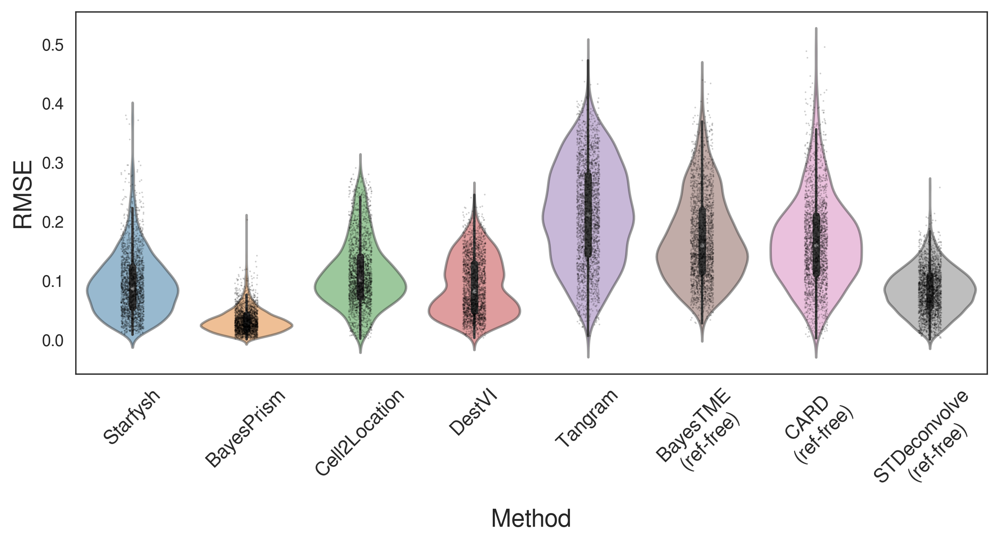

In [347]:
rmses = disp_metrics_violin(
    y_true=prop_df,
    y_preds=[prop_pred_starfysh_df, 
             prop_pred_bayesprism_df,
             prop_pred_cell2loc_df,
             prop_pred_destvi_df,
             prop_pred_tangram_df,
             prop_pred_bayestme_df,
             prop_pred_card_free_df,
             prop_pred_stdeconv_df
            ],
    labels=['Starfysh',
            'BayesPrism',
            'Cell2Location',
            'DestVI', 
            'Tangram',
            'BayesTME\n(ref-free)',
            'CARD\n(ref-free)',
            'STDeconvolve\n(ref-free)'
           ],
    return_metrics=True
)

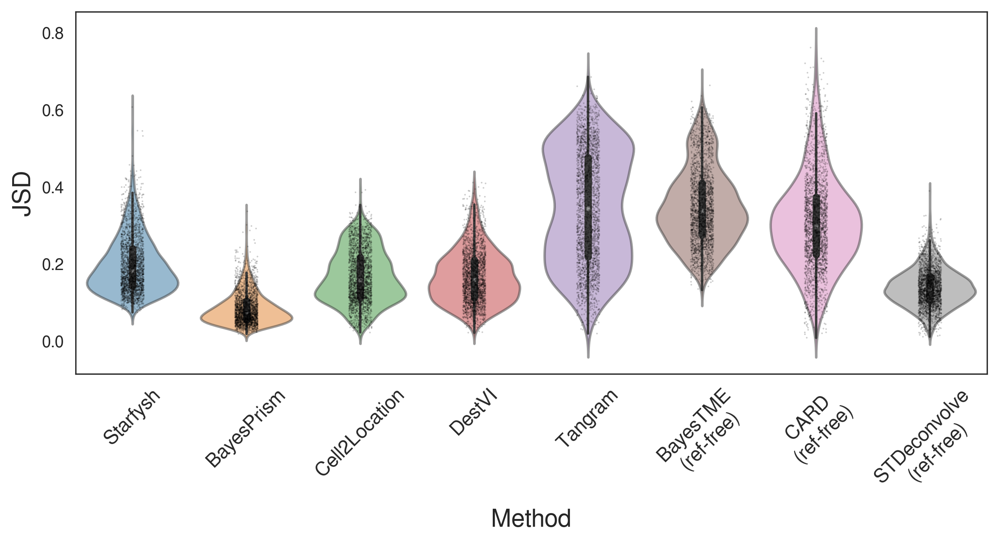

In [70]:
disp_metrics_violin(
    y_true=prop_df,
    y_preds=[prop_pred_starfysh_df, 
             prop_pred_bayesprism_df,
             prop_pred_cell2loc_df,
             prop_pred_destvi_df,
             prop_pred_tangram_df,
             prop_pred_bayestme_df,
             prop_pred_card_free_df,
             prop_pred_stdeconv_df
            ],
    labels=['Starfysh',
            'BayesPrism',
            'Cell2Location',
            'DestVI', 
            'Tangram',
            'BayesTME\n(ref-free)',
            'CARD\n(ref-free)',
            'STDeconvolve\n(ref-free)'
           ],
    metric_name='JSD'
)

##### (e). Other fig.1 + supp. fig. 8 & 9 plots

Figure 1(b) flowchart visualization with spatially independent simulations:

In [90]:
from sklearn.neighbors import KNeighborsRegressor
from scipy.stats import gaussian_kde

In [117]:
data_path = '../data/'
plot_dir = '../../plot_files/starfysh_revision/'

sample_id = 'simu_5_plot/'
adata, adata_normed = utils.load_adata(data_folder=data_path,  # root data directory
                                       sample_id=sample_id,  # sample_id
                                       n_genes=2000  # number of highly variable genes to keep
                                      )


# Ground-truth quantities
mem_df = pd.read_csv(os.path.join(data_path, sample_id, 'members.st_synth.csv'),index_col=0)
prop_df = pd.read_csv(os.path.join(data_path, sample_id, 'proportions.st_synth.csv'),index_col=0)

gene_sig = pd.read_csv(os.path.join(data_path, sample_id, 'signature.st_synth.csv'))
gene_sig = utils.filter_gene_sig(gene_sig,adata.to_df()) # filter out low-quality marker genes
gene_sig.head()

[2023-06-19 11:49:42] Preprocessing1: delete the mt and rp
[2023-06-19 11:49:43] Preprocessing2: Normalize
[2023-06-19 11:49:43] Preprocessing3: Logarithm
[2023-06-19 11:49:43] Preprocessing4: Find the variable genes


,CAFs,Cancer_Epithelial,Myeloid,Normal_Epithelial,T-cells
0,DCN,SCGB2A2,C1QB,KRT14,CCL5
1,COL1A1,CD24,LYZ,KRT17,IL7R
2,LUM,MUCL1,C1QA,LTF,GNLY
3,COL1A2,KRT19,C1QC,KRT15,NKG7
4,SFRP2,SCGB1D2,TYROBP,PTN,CD3E


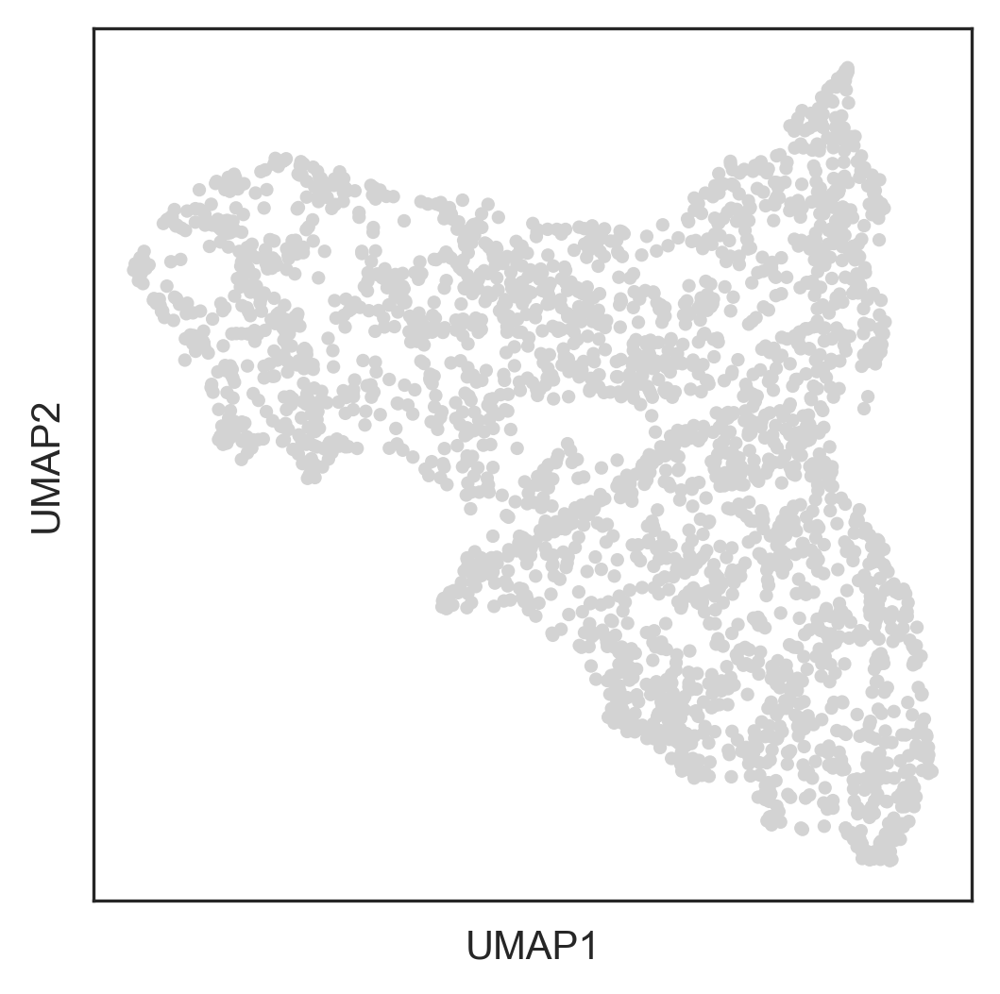

In [118]:
umap_df = utils.get_umap(adata, display=True)
map_info = utils.get_simu_map_info(umap_df)

# Create dummy dict. as img_metadata
img_metadata = {
    'img': None,
    'map_info': map_info,
    'scalefactor': None
}


In [120]:
visium_args = utils.VisiumArguments(adata,
                                    adata_normed,
                                    gene_sig,
                                    img_metadata,
                                    window_size=1,
                                    sample_id=sample_id
                                   )

adata, adata_normed = visium_args.get_adata()
anchors_df = visium_args.get_anchors()

[2023-06-19 11:50:13] Subsetting highly variable & signature genes ...
[2023-06-19 11:50:19] Smoothing library size by taking averaging with neighbor spots...
[2023-06-19 11:50:20] Retrieving & normalizing signature gene expressions...


[2023-06-19 11:50:20] Identifying anchor spots (highly expression of specific cell-type signatures)...


In [121]:
aa_model = AA.ArchetypalAnalysis(adata_orig=adata)

# set large resolution / convergence criteria to obtain major archetypes
archetype, arche_dict, major_idx, evs = aa_model.compute_archetypes(cn=30,
                                                                    r=100,  
                                                                    converge=1e-2,
                                                                    display=False)

arche_df = aa_model.find_archetypal_spots(major=True)
markers_df = aa_model.find_markers(n_markers=30, display=False)

# (3). Map archetypes to closest anchors within `r` nearest neighbors
# Choose the top 30% anchors of each cell type for mapping

percent_anchor = 0.3
n_ancs = int(percent_anchor*adata.shape[0])

anchors_df = visium_args.get_anchors()
map_df, map_dict = aa_model.assign_archetypes(anchor_df=anchors_df[:n_ancs],
                                              r=n_ancs)

[2023-06-19 11:50:22] Computing intrinsic dimension to estimate k...
[2023-06-19 11:50:23] Estimating lower bound of # archetype as 4...


7 components are retained using conditional_number=30.00


[2023-06-19 11:50:56] Calculating UMAPs for counts + Archetypes...
[2023-06-19 11:51:01] 0.913 variance explained by raw archetypes.
Merging raw archetypes within 100 NNs to get major archetypes
[2023-06-19 11:51:01] Finding 20 nearest neighbors for each archetype...
[2023-06-19 11:51:01] Finding 30 top marker genes for each archetype...


In [122]:
gene_sig_arch = gene_sig.copy()
for cell_type in map_dict.keys():
    arch = map_dict[cell_type]
    gene_sig_arch = utils.append_sigs(gene_sig_arch, cell_type, markers_df[arch], n_genes=30)

In [123]:
visium_args = utils.VisiumArguments(adata,
                                    adata_normed,
                                    gene_sig_arch,
                                    img_metadata,
                                    window_size=1,
                                    sample_id=sample_id
                                   )

adata, adata_normed = visium_args.get_adata()
anchors_df = visium_args.get_anchors()

[2023-06-19 11:51:06] Subsetting highly variable & signature genes ...
[2023-06-19 11:51:11] Smoothing library size by taking averaging with neighbor spots...
[2023-06-19 11:51:13] Retrieving & normalizing signature gene expressions...


[2023-06-19 11:51:13] Identifying anchor spots (highly expression of specific cell-type signatures)...


In [124]:
n_repeats = 3
epochs = 100
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')

model, loss = utils.run_starfysh(visium_args,
                                 n_repeats=n_repeats,
                                 alpha_mul=10,
                                 epochs=epochs,
                                 poe=False,
                                 device=device)

[2023-06-19 11:51:15] Running Starfysh with 3 restarts, choose the model with best parameters...
[2023-06-19 11:51:15]  ===  Restart Starfysh 1 === 

[2023-06-19 11:51:15] Initializing model parameters...
[2023-06-19 11:51:28] Epoch[10/100], train_loss: 584.0758, train_reconst: 522.8931, train_u: 16.2215,train_z: 19.6952,train_c: 23.1926,train_n: 2.0733
[2023-06-19 11:51:42] Epoch[20/100], train_loss: 555.4031, train_reconst: 496.4790, train_u: 15.0405,train_z: 19.9818,train_c: 21.5890,train_n: 2.3129
[2023-06-19 11:51:55] Epoch[30/100], train_loss: 538.3645, train_reconst: 481.5014, train_u: 14.2823,train_z: 20.3006,train_c: 19.8726,train_n: 2.4075
[2023-06-19 11:52:08] Epoch[40/100], train_loss: 525.0337, train_reconst: 470.1945, train_u: 13.7787,train_z: 20.6065,train_c: 18.0531,train_n: 2.4010
[2023-06-19 11:52:21] Epoch[50/100], train_loss: 513.2415, train_reconst: 460.2465, train_u: 13.3971,train_z: 20.9464,train_c: 16.2323,train_n: 2.4192
[2023-06-19 11:52:35] Epoch[60/100], tra

In [125]:
inference_outputs, generative_outputs = sf_model.model_eval(model,
                                                            adata,
                                                            visium_args,
                                                            poe=False,
                                                            device=device)

# Deconvolution prediction
prop_pred_df = pd.DataFrame(adata.obsm['qc_m'], index=adata.obs_names, columns=gene_sig.columns)

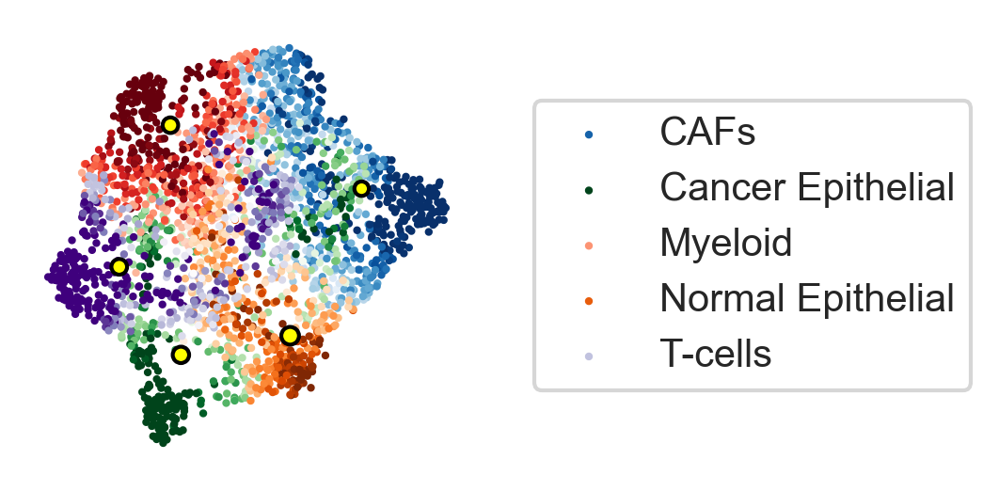

In [126]:
# fig. 1(b)-4 Starfysh reconstructed latent dim (Z) colored with ground-truth proportions


qz_u = post_analysis.get_z_umap(adata.obsm['qz_m'])
fig, ax = post_analysis.plot_type_all(inference_outputs, qz_u, prop_df, figsize=(2, 2))
knr = KNeighborsRegressor(10)
knr.fit(adata.obsm['qz_m'], qz_u)
qu_umap = knr.predict(adata.uns['qu_m'])

ax.scatter(*qu_umap.T, c='yellow', edgecolors='black',
            s=np.exp(model.qs_logm.cpu().detach()).sum(axis=1)**1/2)

In [127]:
fig.savefig(os.path.join(plot_dir, 'fig1b_qz.svg'), dpi=300, bbox_inches='tight')

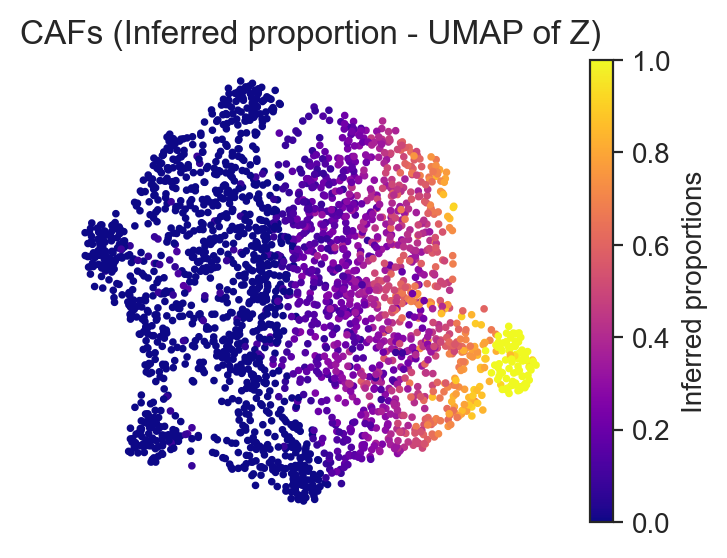

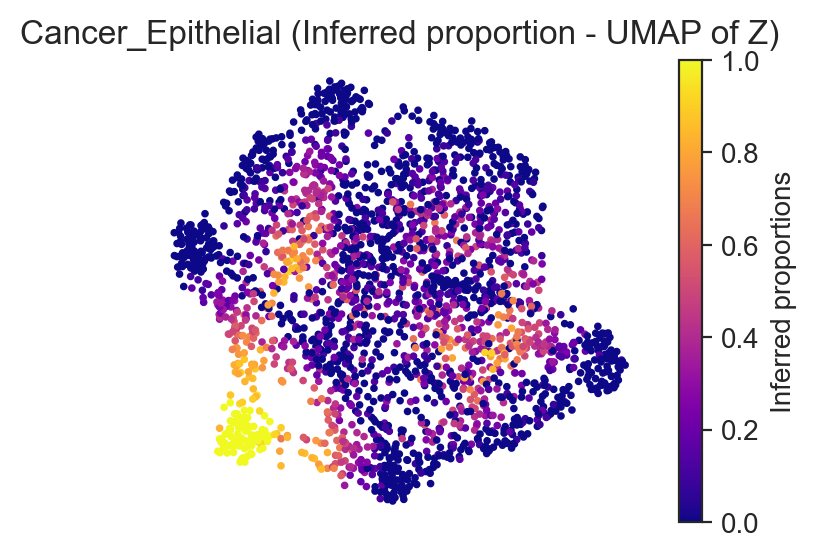

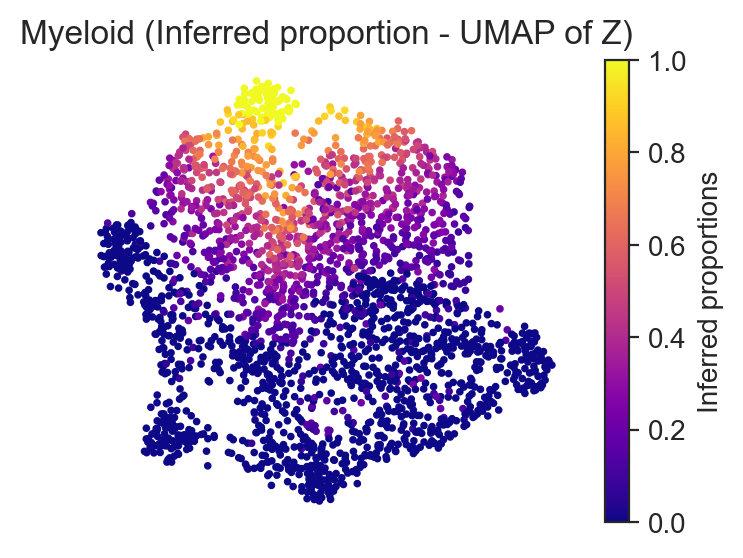

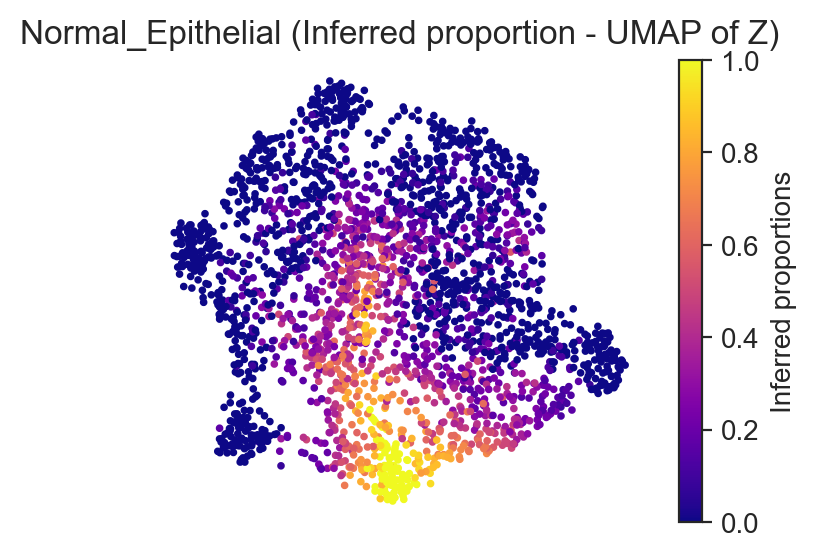

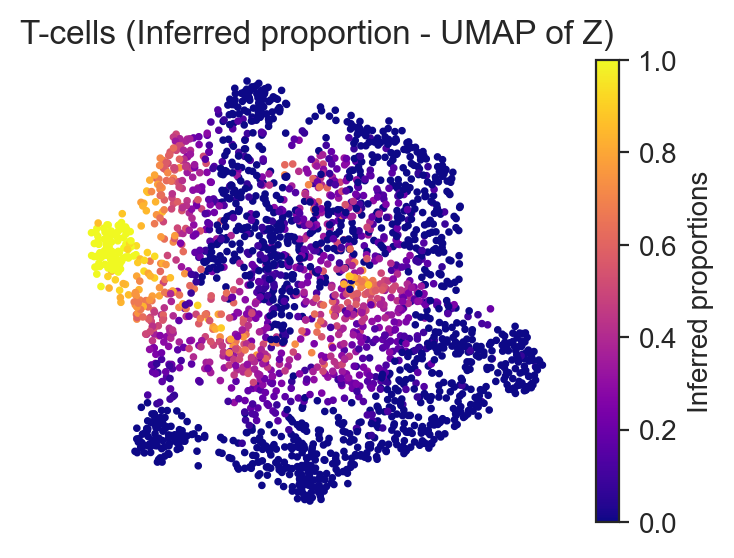

In [132]:
# Visualize q(z) colored with individual Ground-truth proportions

#adata_gt = adata.copy()
adata_gt.obsm['qc_m'] = prop_df.values  # Assign ground-truth proportions
plot_utils.pl_spatial_inf_feature(adata_gt, feature='qz_m', cmap='plasma', spot_size=1)

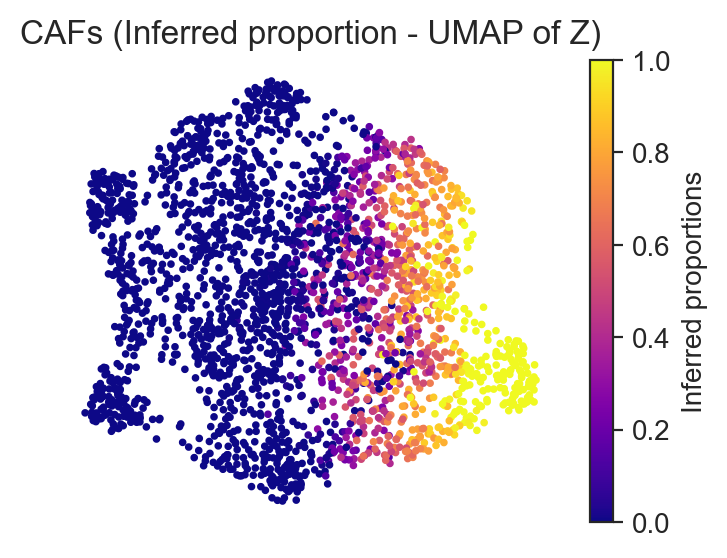

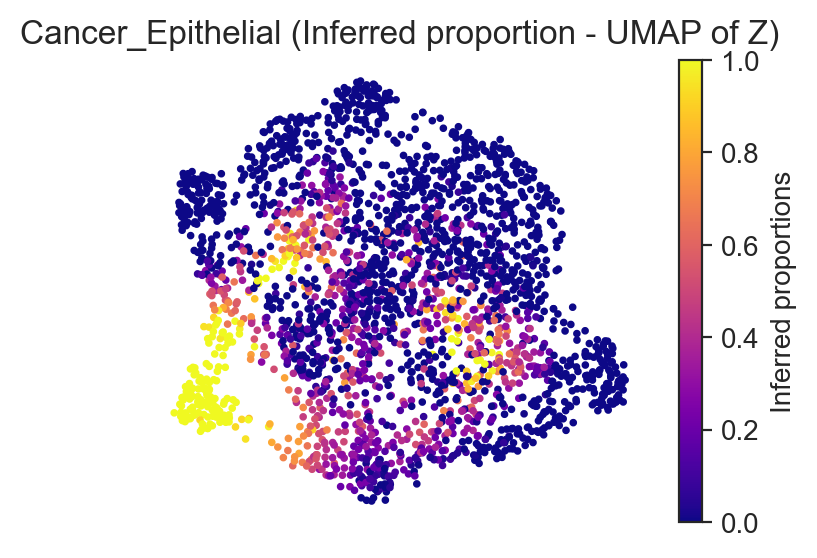

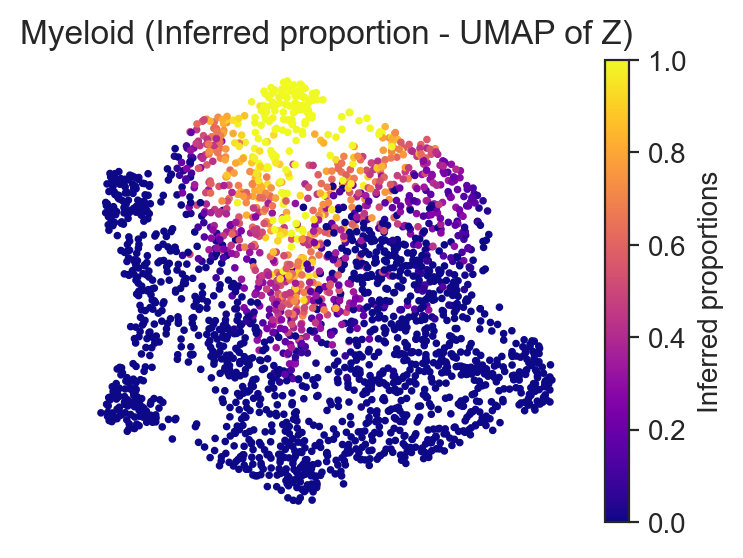

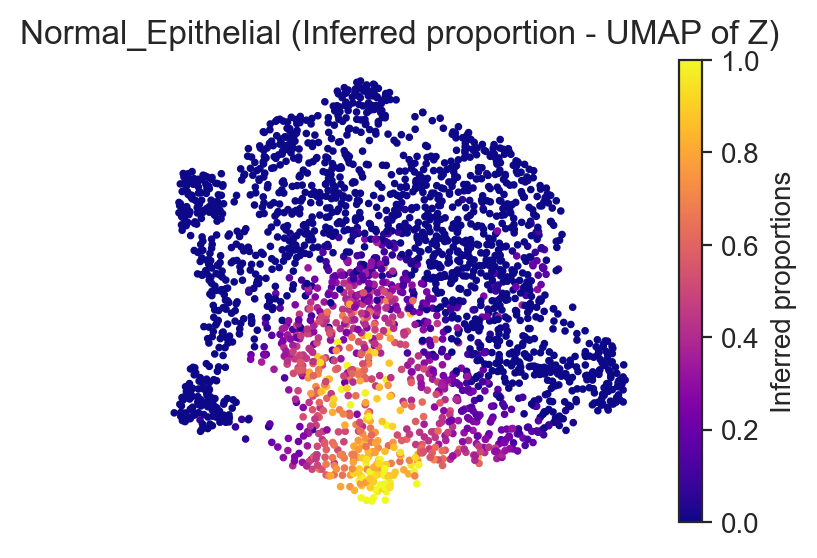

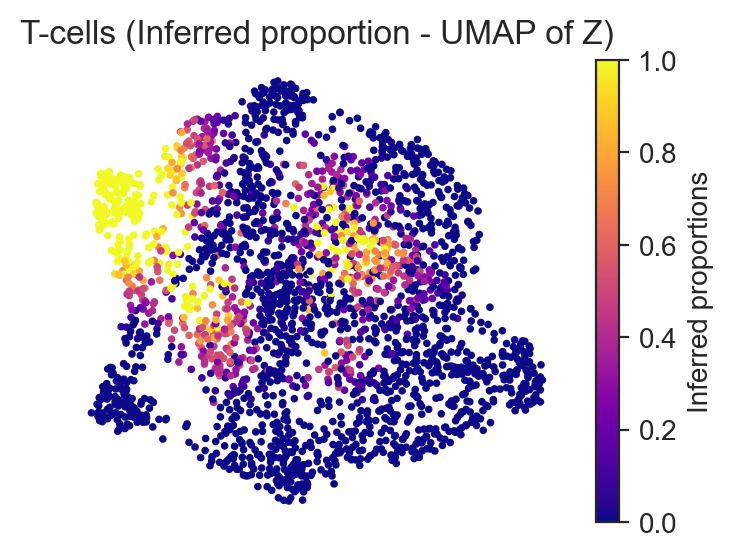

In [135]:
# Visualize q(z) colored with individual predicted proportions
plot_utils.pl_spatial_inf_feature(adata, feature='qz_m', cmap='plasma', spot_size=1, vmax=1)

[2023-06-19 12:28:47] Fontsize 0.00 < 1.0 pt not allowed by FreeType. Setting fontsize = 1 pt
[2023-06-19 12:28:47] Fontsize 0.00 < 1.0 pt not allowed by FreeType. Setting fontsize = 1 pt
[2023-06-19 12:28:47] Fontsize 0.00 < 1.0 pt not allowed by FreeType. Setting fontsize = 1 pt
[2023-06-19 12:28:47] Fontsize 0.00 < 1.0 pt not allowed by FreeType. Setting fontsize = 1 pt
[2023-06-19 12:28:47] Fontsize 0.00 < 1.0 pt not allowed by FreeType. Setting fontsize = 1 pt
[2023-06-19 12:28:47] Fontsize 0.00 < 1.0 pt not allowed by FreeType. Setting fontsize = 1 pt
[2023-06-19 12:28:47] Fontsize 0.00 < 1.0 pt not allowed by FreeType. Setting fontsize = 1 pt
[2023-06-19 12:28:47] Fontsize 0.00 < 1.0 pt not allowed by FreeType. Setting fontsize = 1 pt
[2023-06-19 12:28:47] Fontsize 0.00 < 1.0 pt not allowed by FreeType. Setting fontsize = 1 pt
[2023-06-19 12:28:47] Fontsize 0.00 < 1.0 pt not allowed by FreeType. Setting fontsize = 1 pt
[2023-06-19 12:28:47] Fontsize 0.00 < 1.0 pt not allowed by 

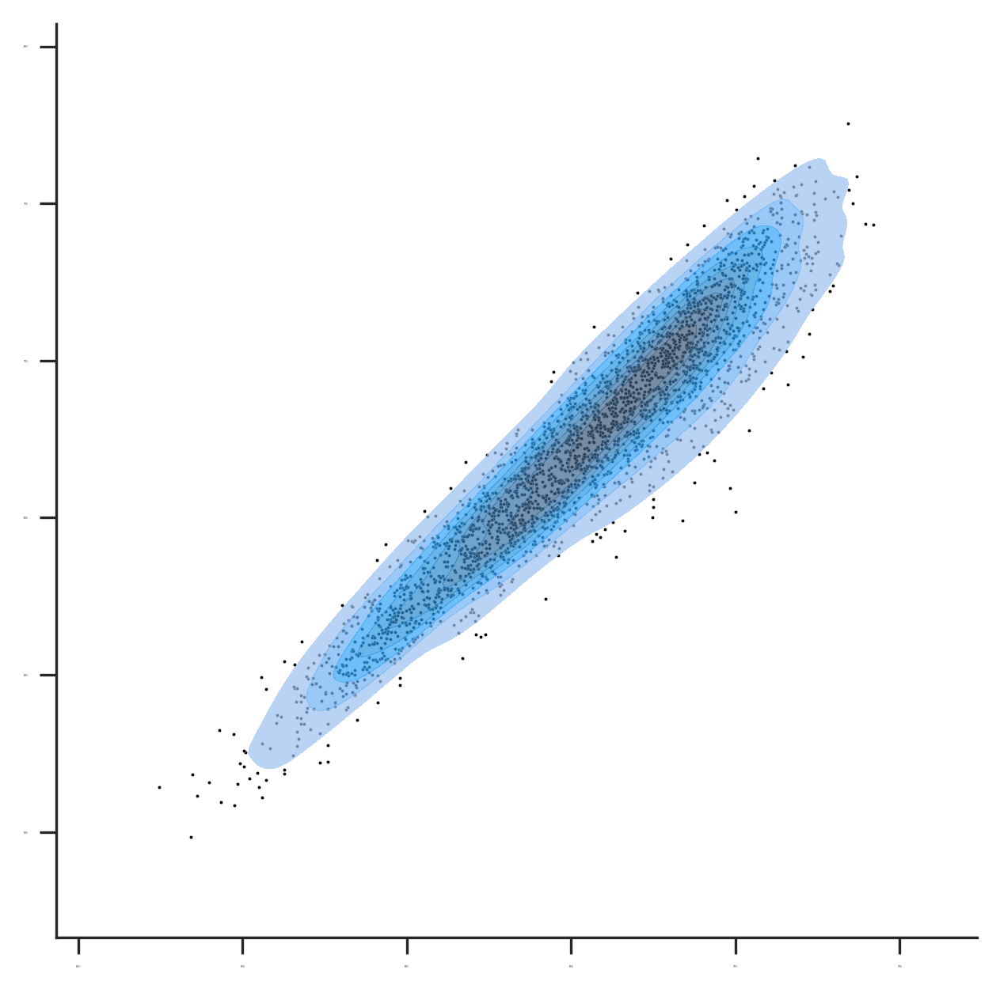

In [146]:
# fig. 1(b)-5. ql vs. ground-truth log library size

# prediction vs. ground-truth density

plot_dir = '../../plot_files/starfysh_revision/'

log_pl = visium_args.log_lib
log_ql = adata.obsm['ql_m']

fig, ax = plt.subplots(figsize=(5, 5), dpi=300)
sns.scatterplot(log_pl, log_ql, color='k', s=1, ax=ax)
sns.kdeplot(log_pl, log_ql, level=10, fill=True, alpha=.7, ax=ax)

ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)
ax.spines['bottom'].set_linestyle('-')  # Horizontal line
ax.spines['left'].set_linestyle('-')    # Vertical line

sns.set_style('ticks')
ax.tick_params(axis='both', which='both', labelsize=0, length=5)

#plt.xlabel('Ground-truth log library size')
#plt.ylabel('Inferred log library size')
#plt.suptitle('Library size reconstruction (Without histology integration)')
#plt.savefig(os.path.join(plot_dir, 'simu_5_ql.svg'), format='svg')
plt.savefig(os.path.join(plot_dir, 'simu_5_ql.png'), format='png')
plt.show()


[2023-06-19 12:18:02] Fontsize 0.00 < 1.0 pt not allowed by FreeType. Setting fontsize = 1 pt
[2023-06-19 12:18:02] Fontsize 0.00 < 1.0 pt not allowed by FreeType. Setting fontsize = 1 pt
[2023-06-19 12:18:02] Fontsize 0.00 < 1.0 pt not allowed by FreeType. Setting fontsize = 1 pt
[2023-06-19 12:18:02] Fontsize 0.00 < 1.0 pt not allowed by FreeType. Setting fontsize = 1 pt
[2023-06-19 12:18:02] Fontsize 0.00 < 1.0 pt not allowed by FreeType. Setting fontsize = 1 pt
[2023-06-19 12:18:02] Fontsize 0.00 < 1.0 pt not allowed by FreeType. Setting fontsize = 1 pt
[2023-06-19 12:18:02] Fontsize 0.00 < 1.0 pt not allowed by FreeType. Setting fontsize = 1 pt
[2023-06-19 12:18:02] Fontsize 0.00 < 1.0 pt not allowed by FreeType. Setting fontsize = 1 pt
[2023-06-19 12:18:02] Fontsize 0.00 < 1.0 pt not allowed by FreeType. Setting fontsize = 1 pt
[2023-06-19 12:18:02] Fontsize 0.00 < 1.0 pt not allowed by FreeType. Setting fontsize = 1 pt
[2023-06-19 12:18:02] Fontsize 0.00 < 1.0 pt not allowed by 

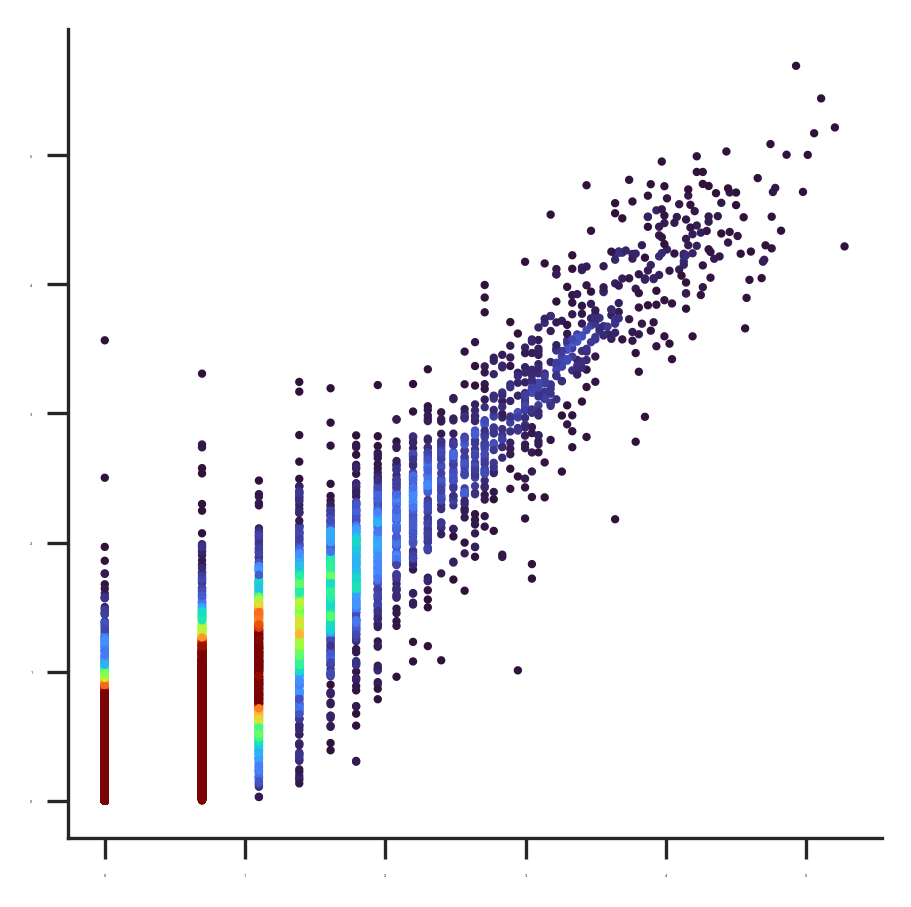

In [139]:
# Expression reconstruction

np.random.seed(42)
rand_indices = np.random.choice(np.arange(adata.shape[0]*adata.shape[1]), 100000)

x_true = np.log1p(adata.X.flatten()[rand_indices])
x_reconst = np.log1p(adata.obsm['px_rate'].flatten()[rand_indices])

v_stacked = np.vstack([x_true, x_reconst])
den = gaussian_kde(v_stacked)(v_stacked)

fig, ax = plt.subplots(figsize=(3.5, 3.5), dpi=300)
# sns.scatterplot(x_true, x_reconst, color='k', s=1, ax=ax)
# sns.kdeplot(x_true, x_reconst, levels=5, clip=(0.01, 10), fill=True, alpha=.7, ax=ax)
ax.scatter(x_true, x_reconst, c=den, s=1, cmap='turbo', vmax=den.max()*1e-3)


ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)
ax.spines['bottom'].set_linestyle('-')  # Horizontal line
ax.spines['left'].set_linestyle('-')    # Vertical line

sns.set_style('ticks')
ax.tick_params(axis='both', which='both', labelsize=0, length=5)

# plt.xlabel(r'Ground-truth expressions ($X$)')
# plt.ylabel(r'Reconstructed expressions ($\hat{X})$')
# plt.savefig(os.path.join(plot_dir, 'simu_5_reconst.svg'), format='svg')
plt.savefig(os.path.join(plot_dir, 'simu_5_reconst.png'), format='png')
plt.show()

### II. Fine-grained cell type simulations

#### Load data

In [46]:
data_path = '../data/'
sample_id = 'simu_10'
adata, adata_normed = utils.load_adata(data_folder=data_path,  # root data directory
                                       sample_id=sample_id,  # sample_id
                                       n_genes=2000  # number of highly variable genes to keep
                                      )

gene_sig = pd.read_csv(os.path.join(data_path, sample_id, 'signature.st_synth.csv'))
gene_sig = utils.filter_gene_sig(gene_sig,adata.to_df())  # filter out low-quality marker genes
gene_sig.head()

[2023-08-02 21:35:06] Preprocessing1: delete the mt and rp
[2023-08-02 21:35:07] Preprocessing2: Normalize
[2023-08-02 21:35:07] Preprocessing3: Logarithm
[2023-08-02 21:35:07] Preprocessing4: Find the variable genes


,Activated CD8,B cells memory,Basal,CAFs MSC iCAF-like,CAFs myCAF-like,Endothelial,PVL immature,Tcm,Treg,pDC
0,CD69,MS4A1,EMP1,APOD,COL1A1,ACKR1,CCL19,CCR7,TNFRSF4,IL3RA
1,CCR7,CD79A,TAGLN,DCN,COL1A2,FABP4,RGS5,LTB,LTB,LILRA4
2,CD27,CD83,TTYH1,PTGDS,COL3A1,PLVAP,IGFBP7,IL7R,IL32,CD123
3,BTLA,CD37,RTN4,CFD,LUM,RAMP2,NDUFA4L2,SARAF,BATF,TCF4
4,CD40LG,BANK1,TK1,LUM,SFRP2,VWF,CCL2,SELL,FOXP3,IRF7


Load ground-truth proportions & densities:

In [47]:
mem_df = pd.read_csv(os.path.join(data_path, sample_id, 'members.st_synth.csv'),index_col=0)
prop_df = pd.read_csv(os.path.join(data_path, sample_id, 'proportions.st_synth.csv'),index_col=0)

In [8]:
# Load paired spatial information

has_histology = False

if has_histology:
    # TODO: update code to load histology & spatial metadata w/ simulation
    raise NotImplementedError("We don't have paired histology simulation")
    
else:
    xx, yy = np.meshgrid(np.arange(50), np.arange(50), indexing='ij')
    map_info = pd.DataFrame(
        np.vstack([xx.flatten(), yy.flatten()]).T,
        index=adata.obs.index,
        columns=['array_row', 'array_col']
    )
    del xx, yy

    # Create dummy dict. as img_metadata
    img_metadata = {
        'img': None,
        'map_info': map_info,
        'scalefactor': None
    }

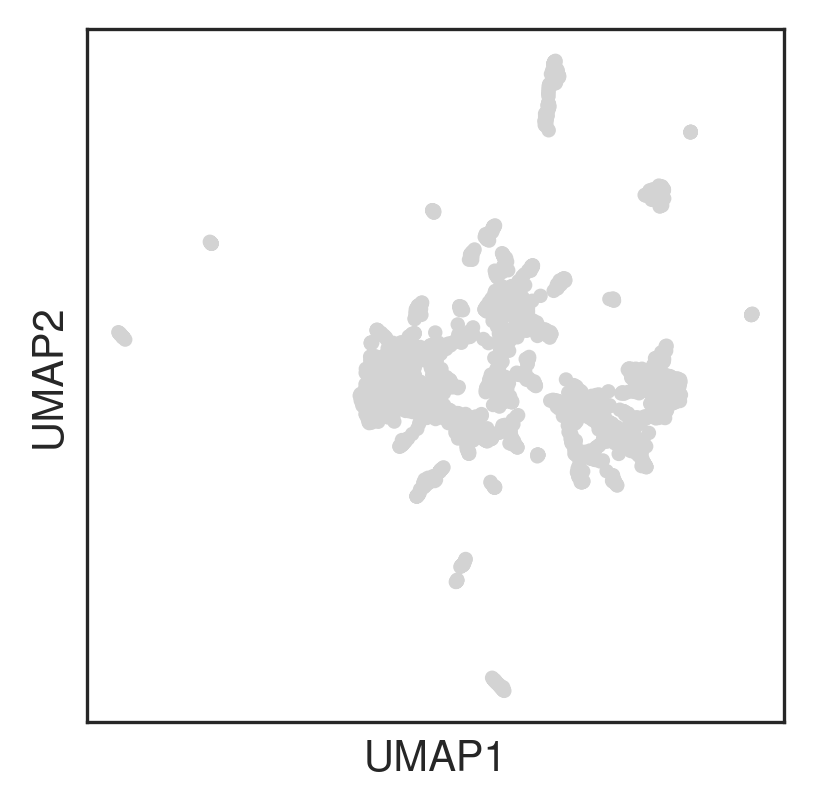

In [9]:
umap_df = utils.get_umap(adata_normed, display=True)

Data preprocessing:

In [48]:
visium_args = utils.VisiumArguments(adata,
                                    adata_normed,
                                    gene_sig,
                                    img_metadata,
                                    window_size=1,
                                    sample_id=sample_id
                                   )

adata, adata_normed = visium_args.get_adata()
anchors_df = visium_args.get_anchors()

[2023-08-02 21:35:08] Subsetting highly variable & signature genes ...
[2023-08-02 21:35:14] Smoothing library size by taking averaging with neighbor spots...
[2023-08-02 21:35:15] Retrieving & normalizing signature gene expressions...


[2023-08-02 21:35:16] Identifying anchor spots (highly expression of specific cell-type signatures)...


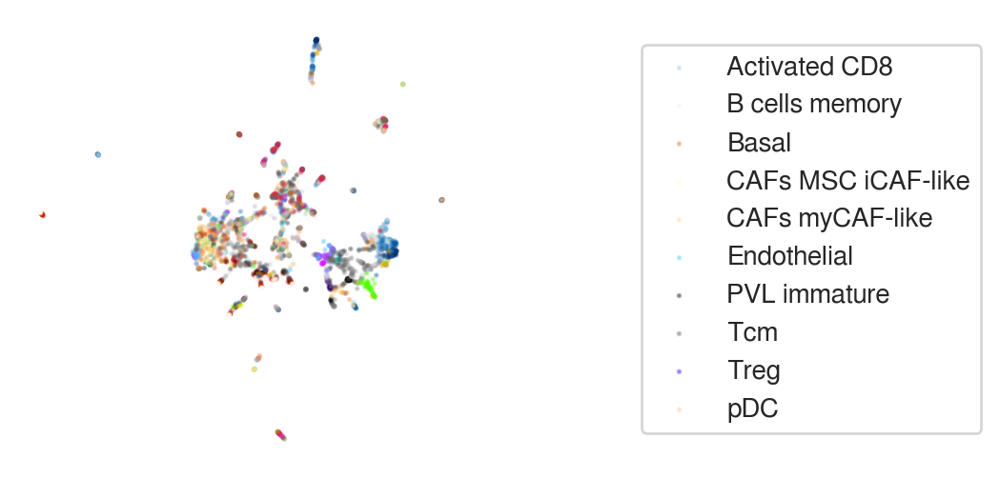

In [13]:
display_gt_umaps(umap_df, prop_df)

Plot RMSE of different priors:

In [116]:
# Plot RMSE
def disp_metrics_violin(
    y_true,
    y_preds,
    labels,
    title=None,
    metric_name='RMSE',
    return_metrics=False):
    """
    Violinplot of per-spot metrics for each prediction against the ground-truth
    """
    n_spots, n_cts = y_true.shape
    if metric_name == 'RMSE':
        metrics = np.array([
            np.sqrt(((y_true.values-y_pred.values)**2).sum(1) / n_cts)
            for y_pred in y_preds
        ])
        
    elif metric_name == 'JSD':
        metrics = np.array([
            jensenshannon(y_true.values, y_pred.values, axis=1)
            for y_pred in y_preds
        ])
    else:
        raise NotImplementedError(metric_name)

    lbls = np.repeat(labels, n_spots)
    df = pd.DataFrame({
        metric_name: metrics.flatten(),
        'Method': lbls
    })
    
    fig, ax = plt.subplots(figsize=(10, 4), dpi=300)
    g = sns.violinplot(x='Method', y=metric_name, data=df, scale='width', ax=ax)    
    for violin in ax.collections:
        violin.set_alpha(0.5)
    g = sns.stripplot(x='Method', y=metric_name, data=df, color='black', alpha=0.2, s=1,  ax=ax)

    
    #g = sns.swarmplot(x='Method', y=metric_name, data=df, ax=ax)
    g.set_xticklabels(labels, rotation=45, fontsize=12)
    g.set_xlabel('Method', fontsize=15)
    g.set_ylabel(metric_name,fontsize=15)
    plt.suptitle(title, fontsize=20)
    plt.show()
    
    plt.setp(g.collections, alpha=.1)

    return metrics if return_metrics else None

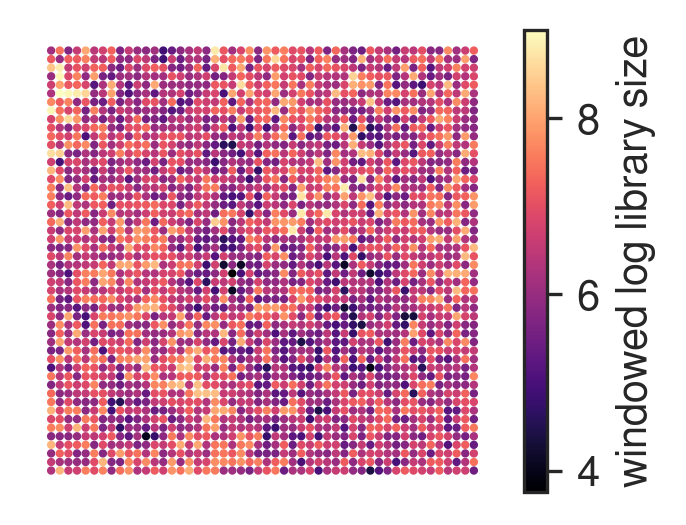

In [17]:
plot_utils.plot_spatial_feature(adata,
                                map_info,
                                visium_args.win_loglib,
                                label='windowed log library size',
                                )

#### Supp. Fig. 8

##### (a). Starfysh with only signature priors

In [49]:
n_repeats = 1
epochs = 200
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')

model, _ = utils.run_starfysh(visium_args,
                             n_repeats=n_repeats,
                             alpha_mul=50, 
                             epochs=epochs,
                             poe=False,
                             device=device)

[2023-08-02 21:35:20] Running Starfysh with 1 restarts, choose the model with best parameters...
[2023-08-02 21:35:20]  ===  Restart Starfysh 1 === 

[2023-08-02 21:35:20] Initializing model parameters...
[2023-08-02 21:35:34] Epoch[10/200], train_loss: 774.1682, train_reconst: 683.8362, train_u: 15.9549,train_z: 21.4857,train_c: 50.7783,train_l: 2.1131
[2023-08-02 21:35:48] Epoch[20/200], train_loss: 711.9810, train_reconst: 627.3990, train_u: 14.4233,train_z: 21.8059,train_c: 46.0362,train_l: 2.3165
[2023-08-02 21:36:02] Epoch[30/200], train_loss: 690.6139, train_reconst: 610.3466, train_u: 13.3629,train_z: 21.9508,train_c: 42.5192,train_l: 2.4344
[2023-08-02 21:36:16] Epoch[40/200], train_loss: 665.4910, train_reconst: 587.6805, train_u: 12.6087,train_z: 22.2492,train_c: 40.5167,train_l: 2.4360
[2023-08-02 21:36:29] Epoch[50/200], train_loss: 650.3605, train_reconst: 575.6229, train_u: 12.0632,train_z: 22.3868,train_c: 37.8960,train_l: 2.3916
[2023-08-02 21:36:43] Epoch[60/200], tra

Parse results:

In [50]:
inference_outputs, generative_outputs = sf_model.model_eval(model,
                                                            adata,
                                                            visium_args,
                                                            poe=False,
                                                            device=device)

# Deconvolution prediction
prop_pred_df = pd.DataFrame(adata.obsm['qc_m'], index=adata.obs_names, columns=gene_sig.columns)

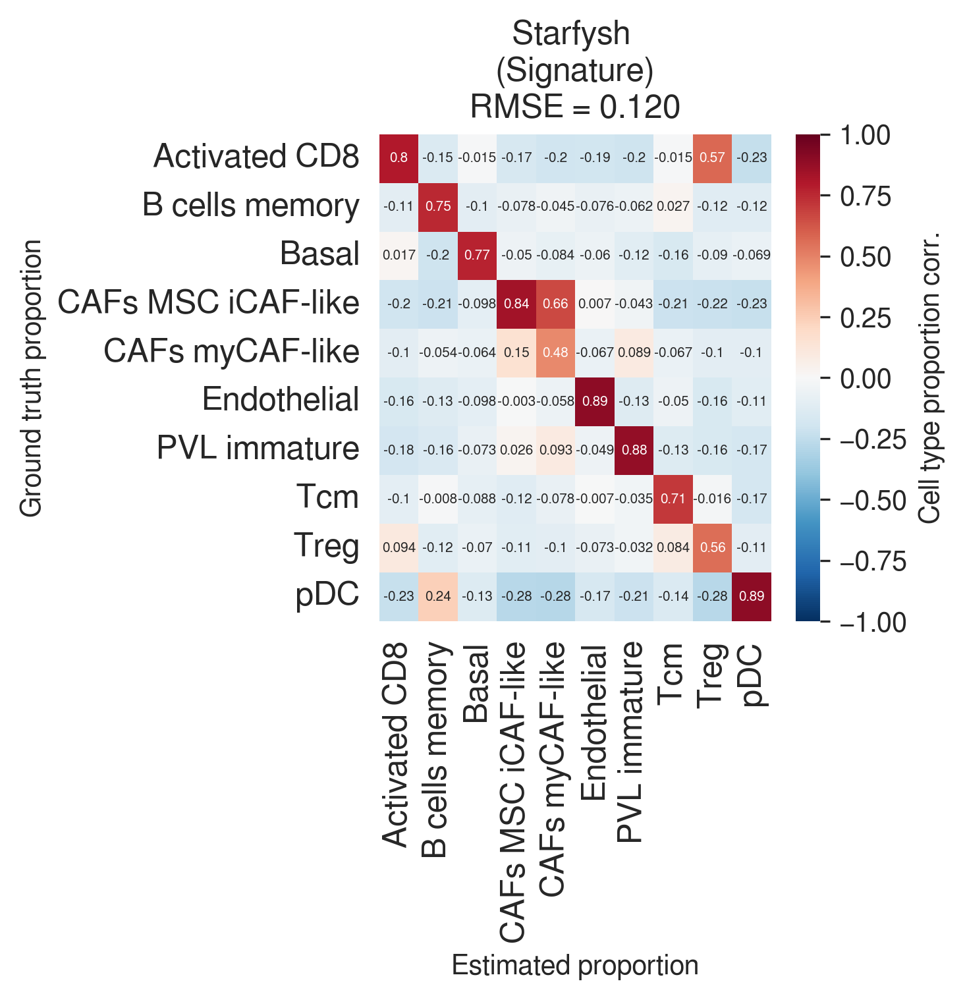

In [51]:
benchmark_utils.disp_corr(
    prop_df,
    prop_pred_df,
    fontsize=5, 
    outdir='../../plot_files/starfysh_revision/',
    title='Starfysh \n(Signature)',
    filename='simu_10_starfysh',
    savefig=True,
    format='png'
)

TODO: Check separability of `u`'s:

In [27]:
qz = adata.obsm['qz_m']

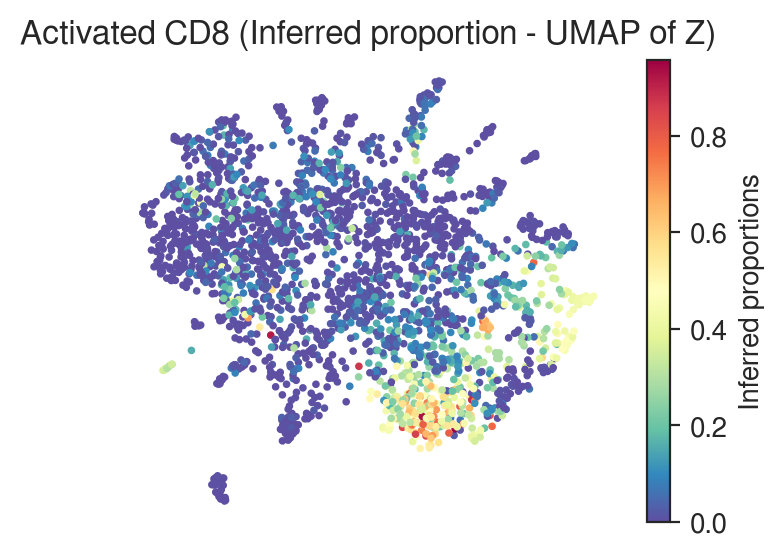

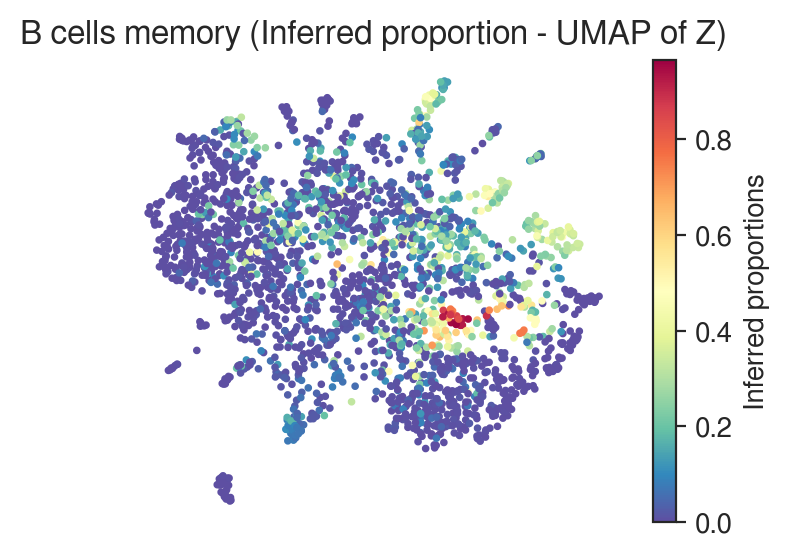

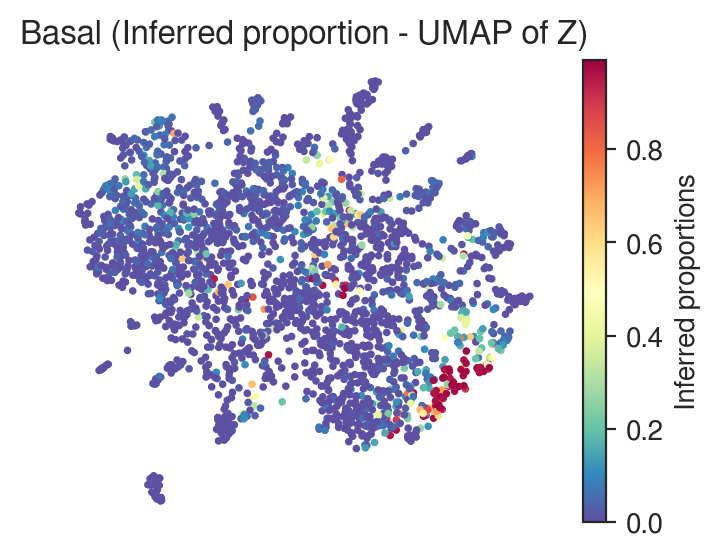

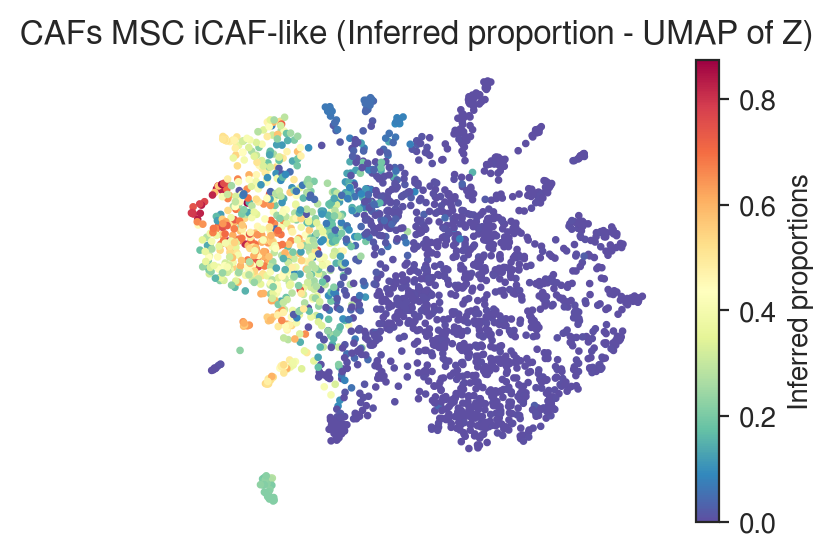

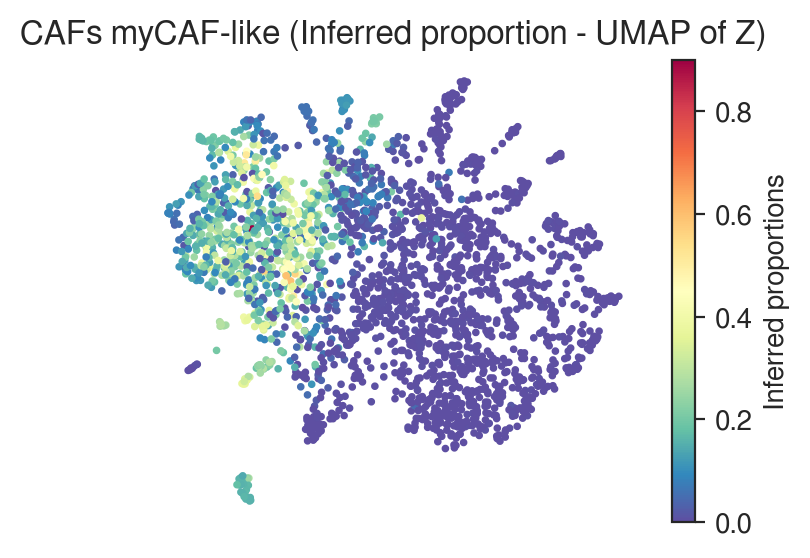

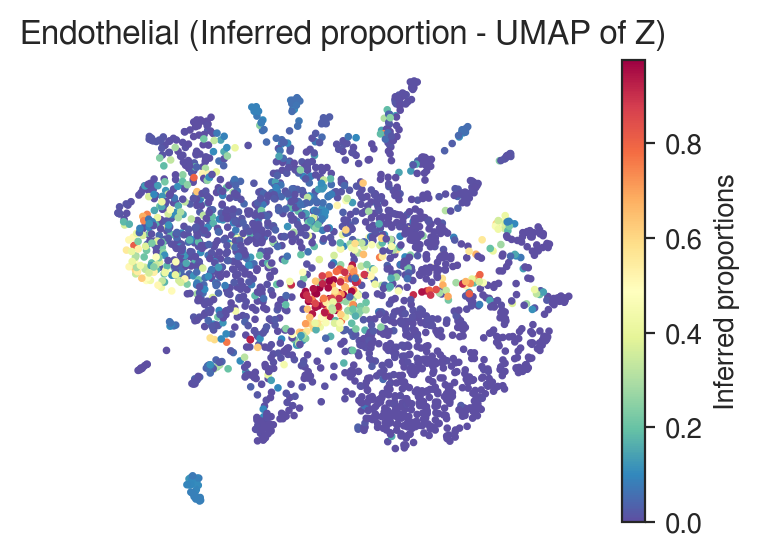

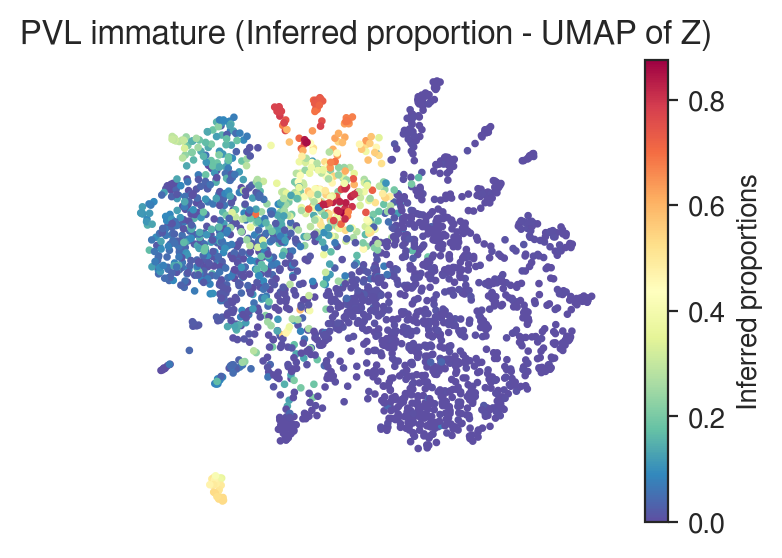

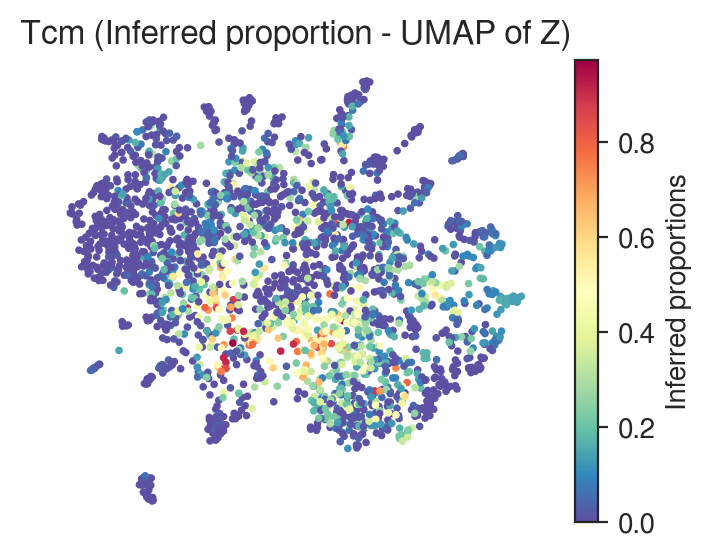

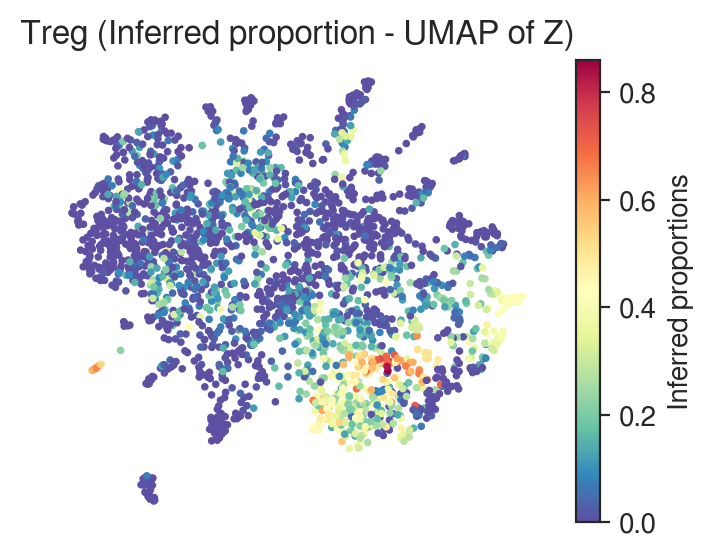

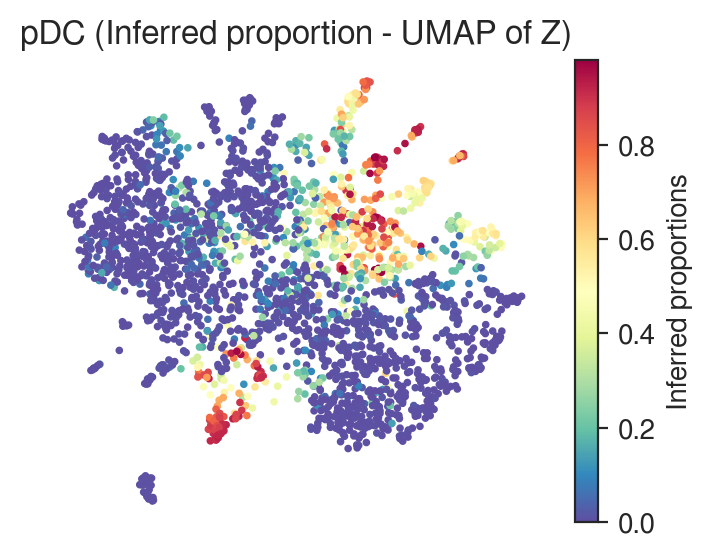

In [29]:
plot_utils.pl_spatial_inf_feature(adata, feature='qz_m')

##### (b). Starfysh with archetypal analysis

In [52]:
# Try taking normalization but without log-transform
aa_model = AA.ArchetypalAnalysis(adata_orig=adata)

# set large resolution / convergence criteria to obtain major archetypes
archetype, arche_dict, major_idx, evs = aa_model.compute_archetypes(cn=30,
                                                                    r=100,  
                                                                    converge=1e-2,
                                                                    display=False)

arche_df = aa_model.find_archetypal_spots(major=True)
markers_df = aa_model.find_markers(n_markers=30, display=False)

# (3). Map archetypes to closest anchors within `r` nearest neighbors
# Choose the top 5% anchors of each cell type for mapping
percent_anchor = 0.05
n_ancs = int(percent_anchor*adata.shape[0])

anchors_df = visium_args.get_anchors()
map_df, map_dict = aa_model.assign_archetypes(anchor_df=anchors_df[:n_ancs],
                                              r=n_ancs)


[2023-08-02 21:39:57] Computing intrinsic dimension to estimate k...
[2023-08-02 21:39:57] Estimating lower bound of # archetype as 6...


17 components are retained using conditional_number=30.00


[2023-08-02 21:41:13] 0.9099 variance explained by raw archetypes.
Merging raw archetypes within 100 NNs to get major archetypes
[2023-08-02 21:41:13] Finding 20 nearest neighbors for each archetype...
[2023-08-02 21:41:14] Finding 30 top marker genes for each archetype...


[2023-08-02 21:41:22] Calculating UMAPs for counts + Archetypes...


(<Figure size 1800x1200 with 1 Axes>, <AxesSubplot:>)

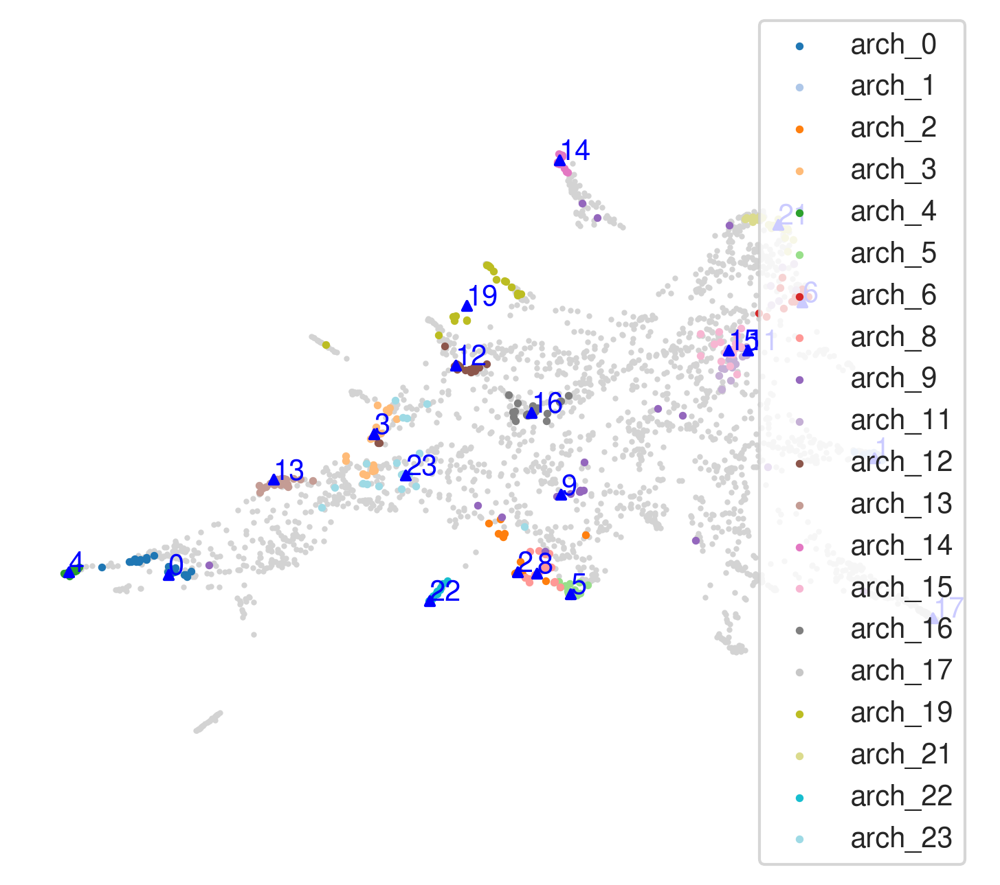

In [53]:
aa_model.plot_archetypes()

<AxesSubplot:>

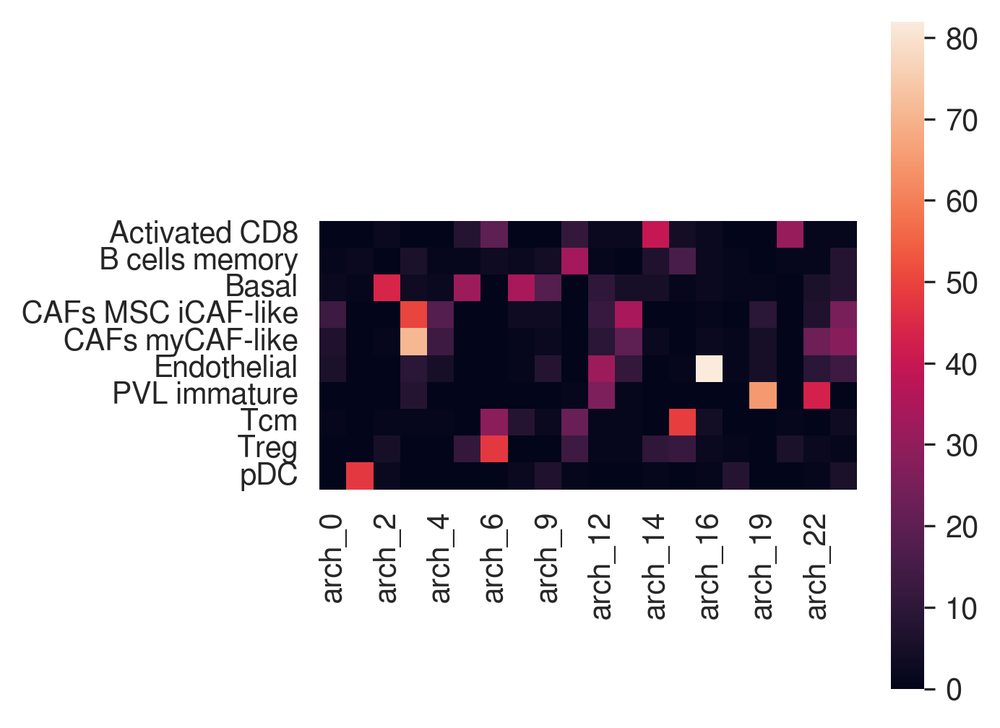

In [54]:
sns.heatmap(map_df, square=True)

Append archetypal markers to signatures based on best anchor-archetype mapping

In [55]:
map_dict

{'Activated CD8': 'arch_14',
 'B cells memory': 'arch_11',
 'Basal': 'arch_2',
 'CAFs myCAF-like': 'arch_3',
 'Endothelial': 'arch_16',
 'PVL immature': 'arch_19',
 'Tcm': 'arch_15',
 'Treg': 'arch_6',
 'pDC': 'arch_1',
 'CAFs MSC iCAF-like': 'arch_13'}

In [38]:
gene_sig_arch = gene_sig.copy()

for cell_type in map_dict.keys():
    if (~pd.isna(gene_sig[cell_type])).sum() < 50:
        print(cell_type)
        arch = map_dict[cell_type]
        gene_sig_arch = utils.append_sigs(gene_sig_arch, cell_type, markers_df[arch], n_genes=30)

Activated CD8
B cells memory
CAFs myCAF-like
PVL immature
Tcm
pDC
CAFs MSC iCAF-like


Calculate updated anchors:

In [39]:
visium_args = utils.VisiumArguments(adata,
                                    adata_normed,
                                    gene_sig_arch,
                                    img_metadata,
                                    window_size=1,
                                    sample_id=sample_id
                                   )

adata, adata_normed = visium_args.get_adata()
anchors_df = visium_args.get_anchors()

[2023-08-02 18:17:40] Subsetting highly variable & signature genes ...
[2023-08-02 18:17:46] Smoothing library size by taking averaging with neighbor spots...
[2023-08-02 18:17:47] Retrieving & normalizing signature gene expressions...


[2023-08-02 18:17:48] Identifying anchor spots (highly expression of specific cell-type signatures)...


In [56]:
n_repeats = 1
epochs = 200
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')

model, loss = utils.run_starfysh(visium_args,
                                 n_repeats=n_repeats,
                                 alpha_mul=50,
                                 epochs=epochs,
                                 poe=False,
                                 device=device)

[2023-08-02 21:41:27] Running Starfysh with 1 restarts, choose the model with best parameters...
[2023-08-02 21:41:27]  ===  Restart Starfysh 1 === 

[2023-08-02 21:41:27] Initializing model parameters...
[2023-08-02 21:41:41] Epoch[10/200], train_loss: 795.2488, train_reconst: 711.1927, train_u: 15.8952,train_z: 20.9571,train_c: 45.5435,train_l: 1.6603
[2023-08-02 21:41:55] Epoch[20/200], train_loss: 732.4861, train_reconst: 652.0936, train_u: 14.3618,train_z: 21.9288,train_c: 42.0439,train_l: 2.0580
[2023-08-02 21:42:09] Epoch[30/200], train_loss: 697.5601, train_reconst: 619.9287, train_u: 13.3258,train_z: 21.9859,train_c: 40.0712,train_l: 2.2485
[2023-08-02 21:42:23] Epoch[40/200], train_loss: 682.4538, train_reconst: 606.0358, train_u: 12.5905,train_z: 22.4800,train_c: 39.0097,train_l: 2.3379
[2023-08-02 21:42:37] Epoch[50/200], train_loss: 663.8692, train_reconst: 589.1598, train_u: 12.0641,train_z: 22.7306,train_c: 37.5488,train_l: 2.3660
[2023-08-02 21:42:51] Epoch[60/200], tra

Parse outputs:

In [57]:
inference_outputs, generative_outputs = sf_model.model_eval(model,
                                                            adata,
                                                            visium_args,
                                                            poe=False,
                                                            device=device)

# Deconvolution prediction
prop_pred_arche_df = pd.DataFrame(adata.obsm['qc_m'], index=adata.obs_names, columns=gene_sig.columns)

**Starfysh deconvolution (with archetype)**

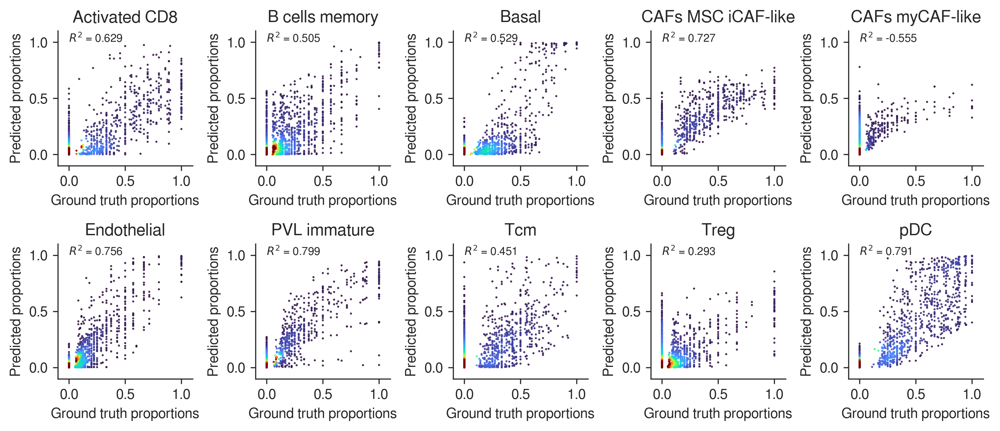

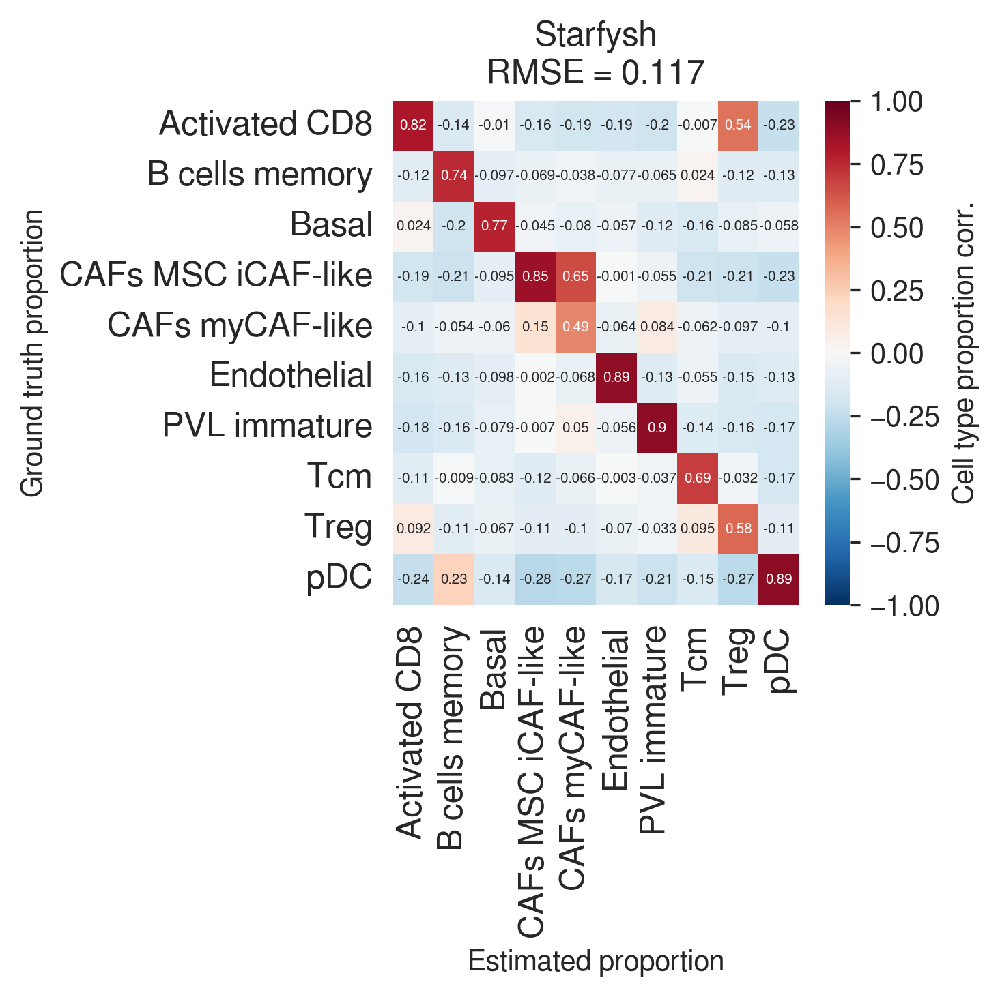

In [58]:
benchmark_utils.disp_prop_scatter(prop_df, prop_pred_arche_df)
benchmark_utils.disp_corr(
    prop_df,
    prop_pred_arche_df,
    fontsize=5, 
    title='Starfysh',
    outdir='../../plot_files/starfysh_revision/',
    filename='simu_10_starfysh_arche',
    savefig=True,
    format='png'
)

Save deconvolution results:

In [60]:
out_path = '../simulation/results/'
prop_pred_df.to_csv(os.path.join(out_path, 'Starfysh_simu_10.csv'), index=True)
prop_pred_arche_df.to_csv(os.path.join(out_path, 'Starfysh_simu_10_arche.csv'), index=True)

##### (c). Benchmark with other methods

Load deconvolution results from other methods:

In [62]:
%ls -al ../simulation/results/ | grep simu_10

-rw-r--r-- 1 yinuo yinuo 534959 Jul 28 18:57 Bayesprism_proportion_simu_10.csv
-rw-r--r-- 1 yinuo yinuo 290152 Aug  2 15:39 BayesTME_proportion_simu_10.csv
-rw-r--r-- 1 yinuo yinuo 549651 Jun  6 15:41 CARD_proportion_simu_10.csv
-rw-rw-r-- 1 yinuo yinuo 582318 May 22 11:06 Cell2Location_proportion_simu_10.csv
-rw-rw-r-- 1 yinuo yinuo 362571 Jun 13 18:01 DestVI_proportion_simu_10.csv
-rw-rw-r-- 1 yinuo yinuo 349074 Aug  3 03:10 Starfysh_simu_10_arche.csv
-rw-rw-r-- 1 yinuo yinuo 349557 Aug  3 03:10 Starfysh_simu_10.csv
-rw-r--r-- 1 yinuo yinuo 551016 Apr 25 01:37 STDeconvolve_proportion_simu_10.csv
-rw-rw-r-- 1 yinuo yinuo 577723 Jun 19 15:44 Tangram_proportion_simu_10.csv


In [69]:
res_path = '../simulation/results/'

prop_pred_starfysh_df = pd.read_csv(os.path.join(res_path, 'Starfysh_simu_10_arche.csv'), index_col=[0])
prop_pred_bayestme_df = pd.read_csv(os.path.join(res_path, 'BayesTME_proportion_simu_10.csv'), index_col=[0])
prop_pred_bayesprism_df = pd.read_csv(os.path.join(res_path, 'Bayesprism_proportion_simu_10.csv'), index_col=[0])
prop_pred_cell2loc_df = pd.read_csv(os.path.join(res_path, 'Cell2Location_proportion_simu_10.csv'), index_col=[0])
prop_pred_stdeconv_df = pd.read_csv(os.path.join(res_path, 'STDeconvolve_proportion_simu_10.csv'), index_col=[0])
prop_pred_card_df = pd.read_csv(os.path.join(res_path, 'CARD_proportion_simu_10.csv'), index_col=[0])
prop_pred_destvi_df = pd.read_csv(os.path.join(res_path, 'DestVI_proportion_simu_10.csv'), index_col=[0])
prop_pred_tangram_df = pd.read_csv(os.path.join(res_path, 'Tangram_proportion_simu_10.csv'), index_col=[0])

In [72]:
# Permute to best-matching cell type cols

# Ref-based (label alignment)
prop_pred_bayesprism_df = prop_pred_bayesprism_df[prop_df.columns]

# Ref-free (stable matching)
prop_pred_bayestme_df = benchmark_utils.get_best_permute(prop_df, prop_pred_bayestme_df)
prop_pred_card_df = benchmark_utils.get_best_permute(prop_df, prop_pred_card_df)
prop_pred_stdeconv_df = benchmark_utils.get_best_permute(prop_df, prop_pred_stdeconv_df)


Reference-based:

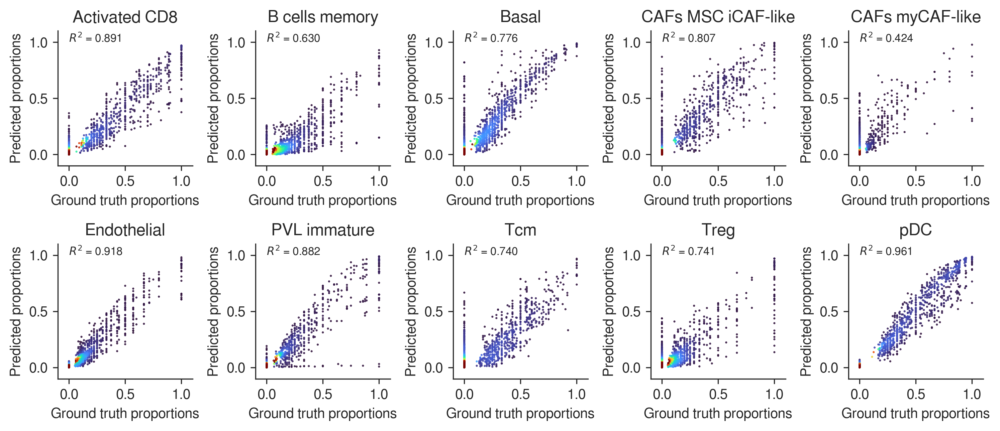

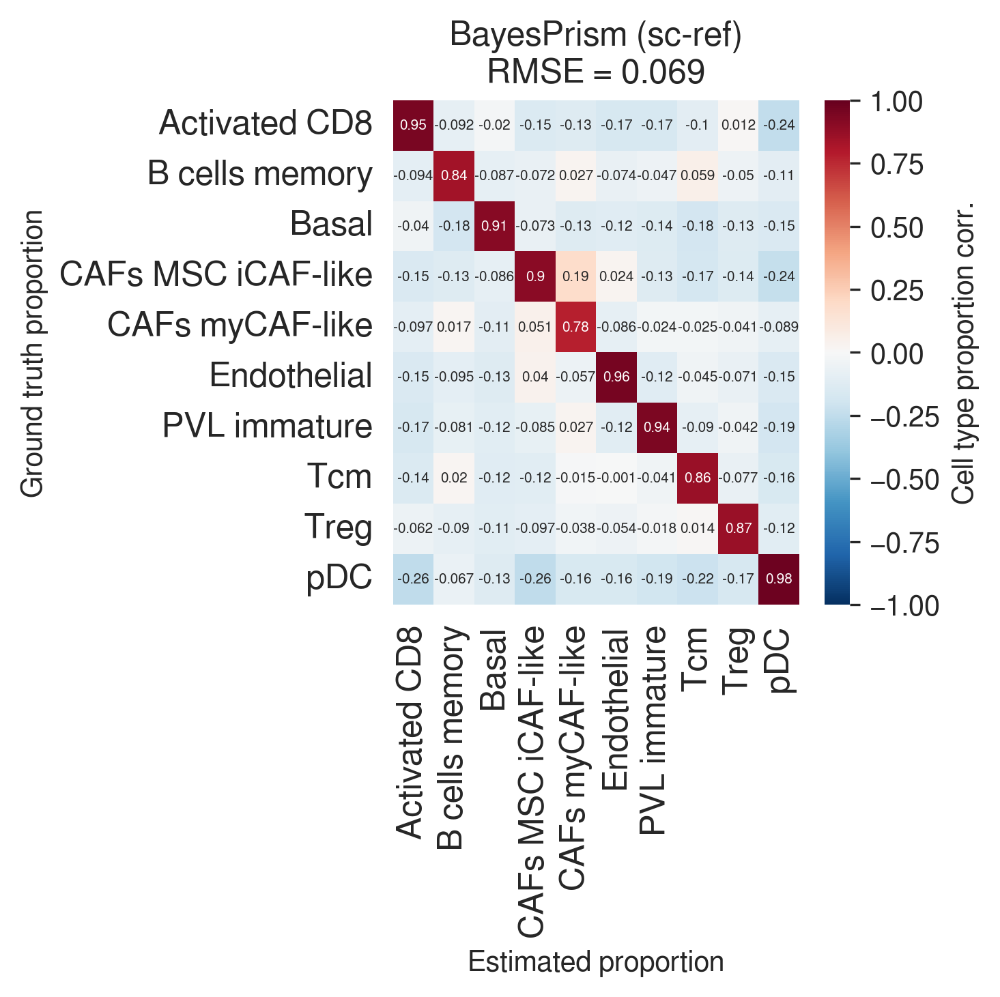

In [73]:
# BayesPrism
benchmark_utils.disp_prop_scatter(prop_df, prop_pred_bayesprism_df)
benchmark_utils.disp_corr(
    prop_df,
    prop_pred_bayesprism_df,
    fontsize=5, 
    title='BayesPrism (sc-ref)',
    outdir='../../plot_files/starfysh_revision/',
    filename='simu_10_bayesprism',
    savefig=True,
    format='png'
)


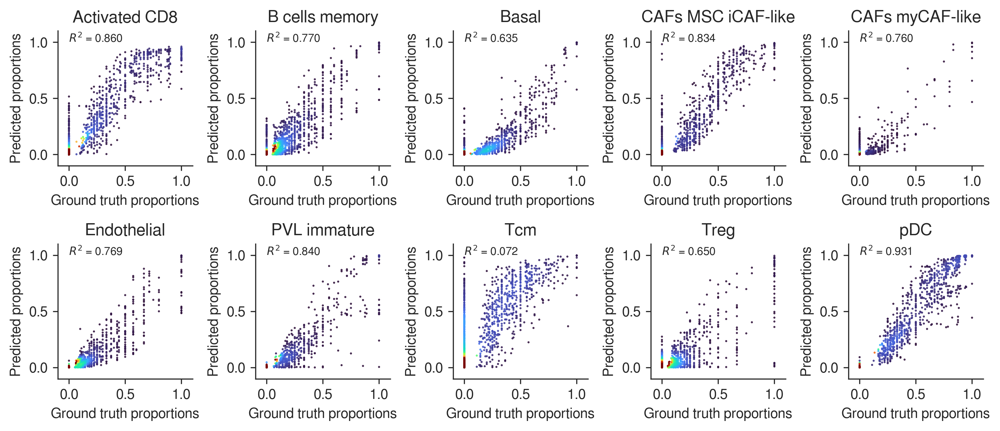

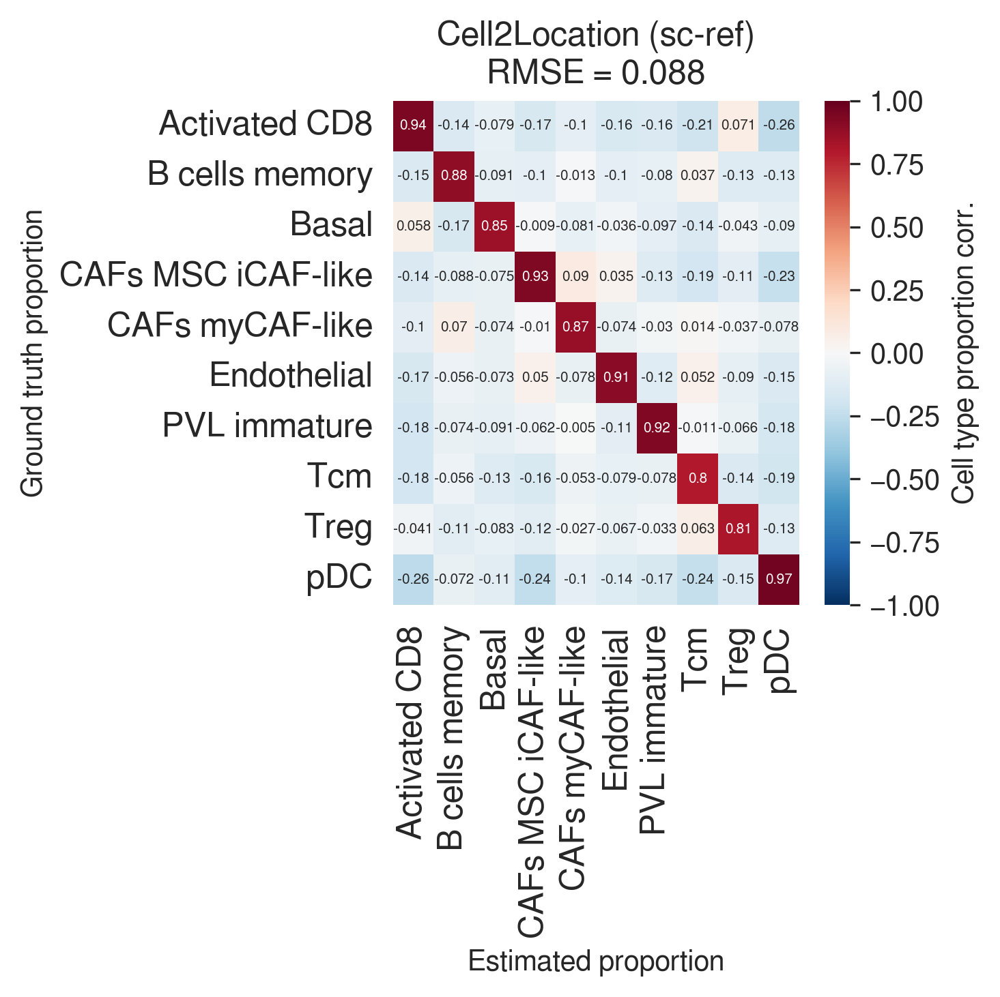

In [14]:
# Cell2Location
benchmark_utils.disp_prop_scatter(prop_df, prop_pred_cell2loc_df)
benchmark_utils.disp_corr(
    prop_df,
    prop_pred_cell2loc_df,
    fontsize=5, 
    title='Cell2Location (sc-ref)',
    outdir='../../plot_files/starfysh_revision/',
    filename='simu_10_cell2loc',
    savefig=True,
    format='png'
)

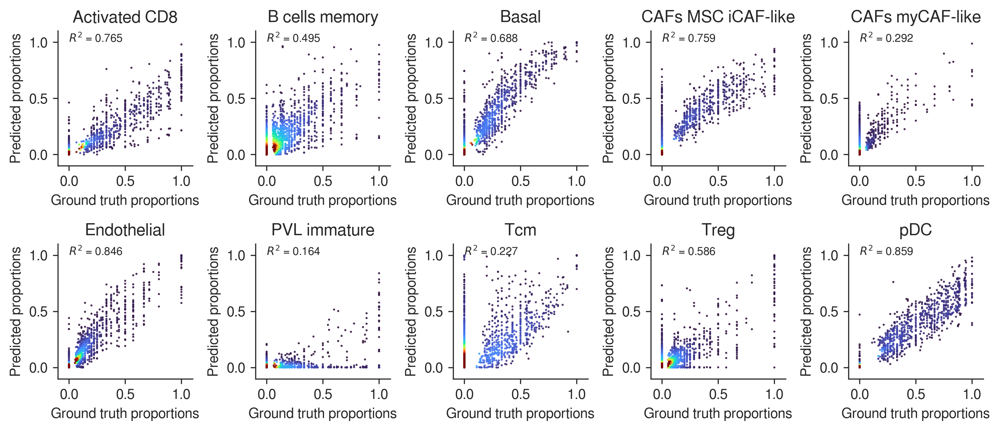

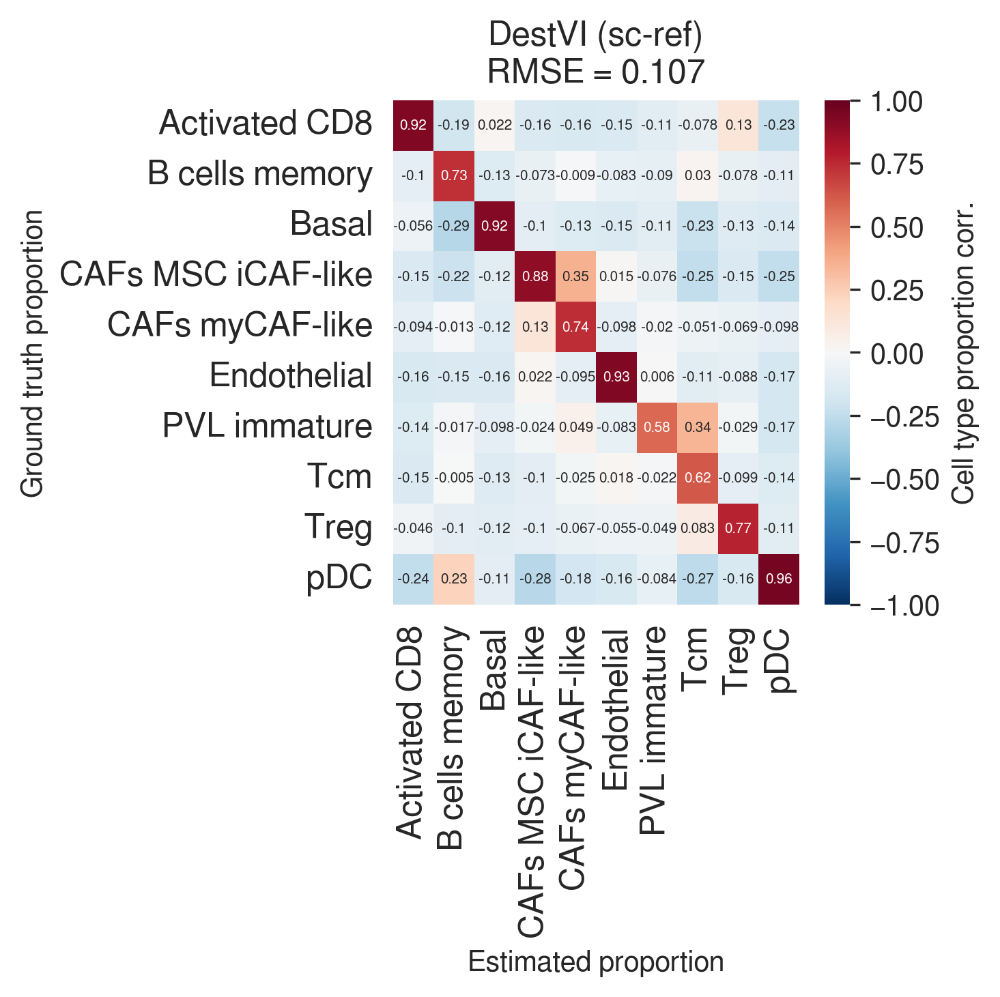

In [154]:
# DestVI
benchmark_utils.disp_prop_scatter(prop_df, prop_pred_destvi_df)
benchmark_utils.disp_corr(
    prop_df,
    prop_pred_destvi_df,
    fontsize=5, 
    title='DestVI (sc-ref)',
    outdir='../../plot_files/starfysh_revision/',
    filename='simu_10_destvi',
    savefig=True,
    format='png'
)

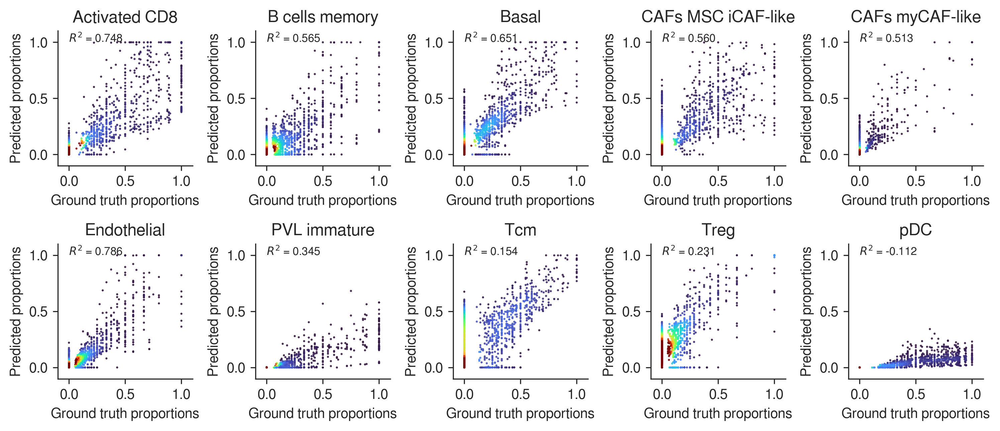

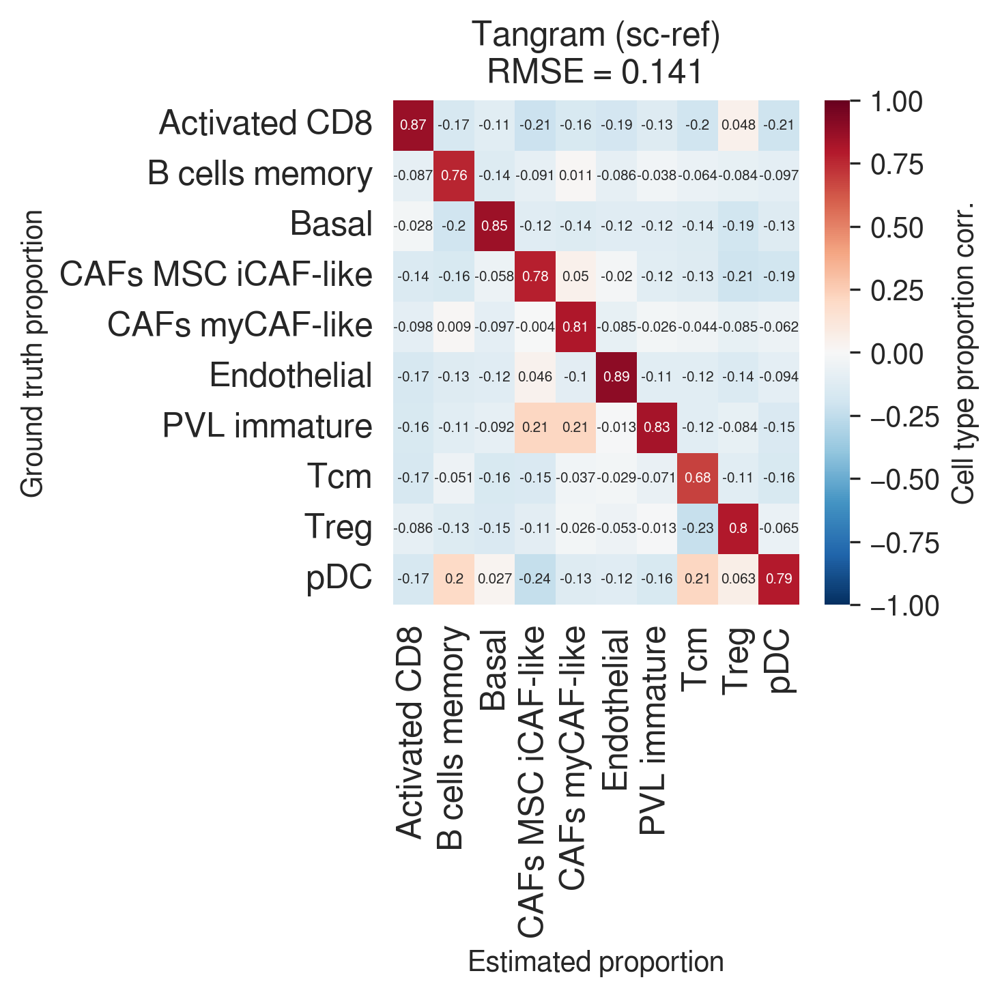

In [74]:
# Tangram
benchmark_utils.disp_prop_scatter(prop_df, prop_pred_tangram_df)
benchmark_utils.disp_corr(
    prop_df,
    prop_pred_tangram_df,
    fontsize=5, 
    title='Tangram (sc-ref)',
    # outdir='../../plot_files/starfysh_revision/',
    # filename='simu_10_tangram',
    # savefig=True,
    # format='png'
)

Reference-free:

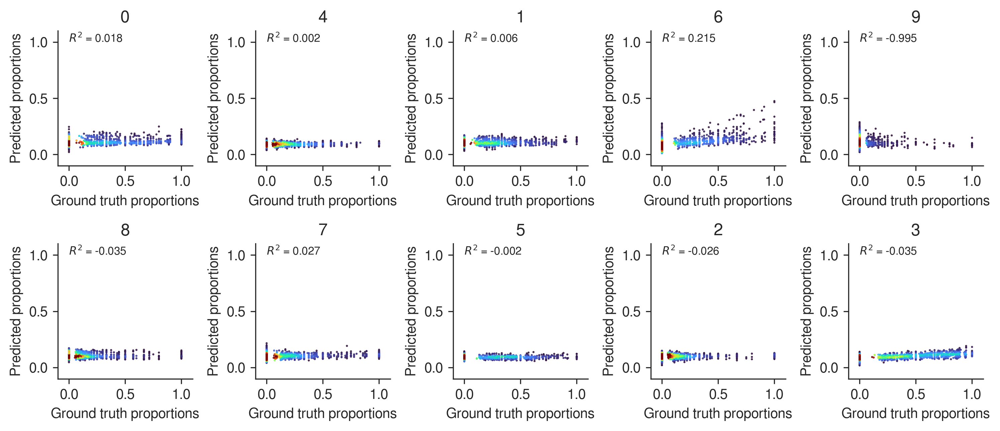

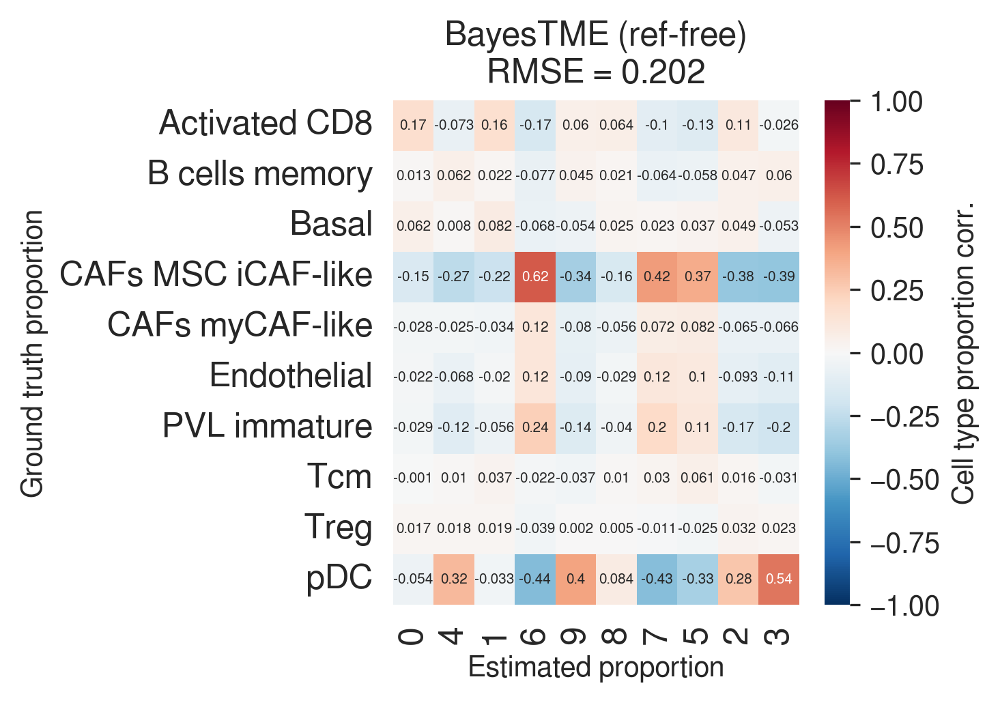

In [75]:
# BayesTME
benchmark_utils.disp_prop_scatter(prop_df, prop_pred_bayestme_df)
benchmark_utils.disp_corr(
    prop_df,
    prop_pred_bayestme_df,
    fontsize=5, 
    title='BayesTME (ref-free)',
    # outdir='../../plot_files/starfysh_revision/',
    # filename='simu_10_bayestme',
    # savefig=True,
    # format='png'
)

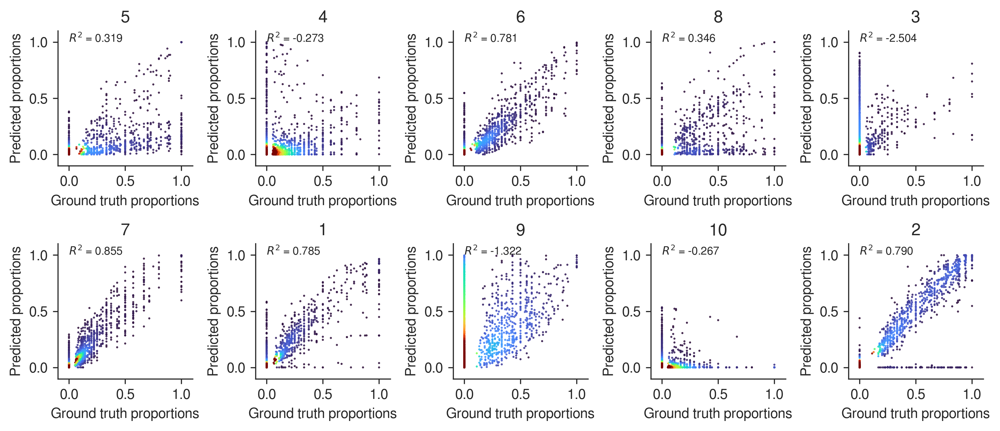

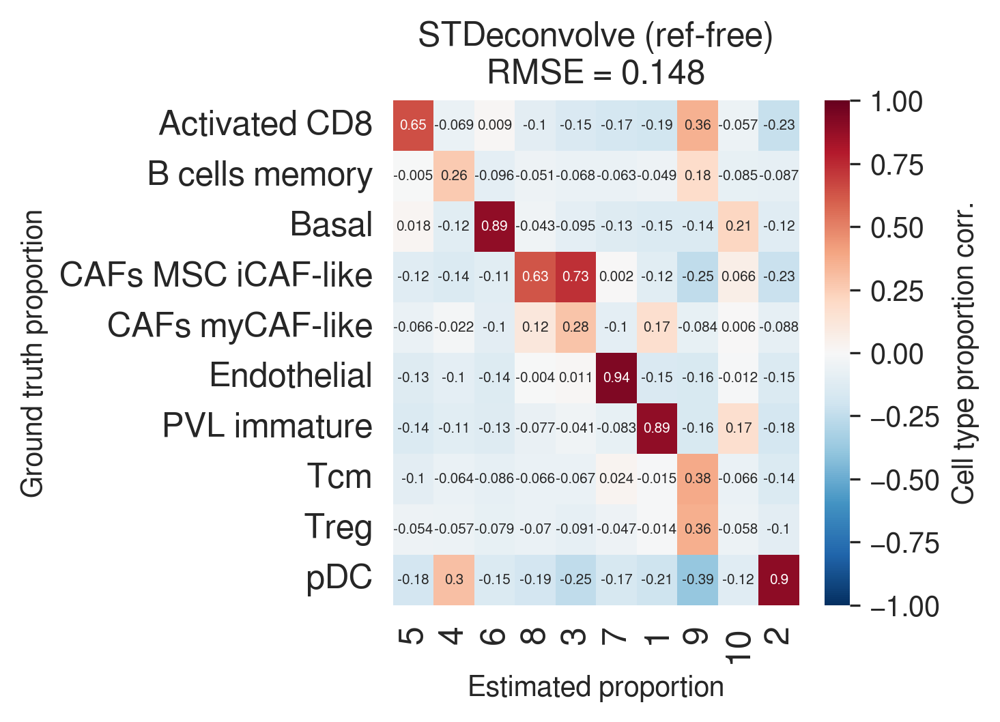

In [156]:
# STDeconvolve
benchmark_utils.disp_prop_scatter(prop_df, prop_pred_stdeconv_df)
benchmark_utils.disp_corr(
    prop_df,
    prop_pred_stdeconv_df,
    fontsize=5, 
    title='STDeconvolve (ref-free)',
    # outdir='../../plot_files/starfysh_revision/',
    # filename='simu_10_stdeconv',
    # savefig=True,
    # format='png'
)

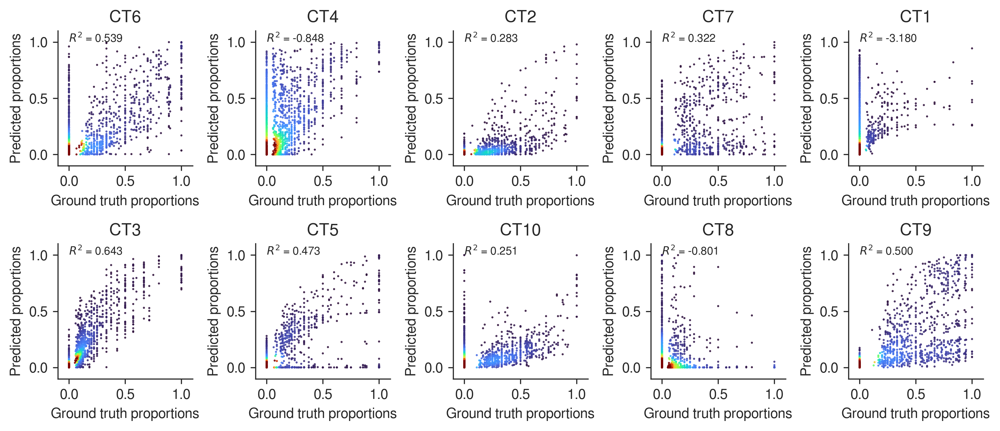

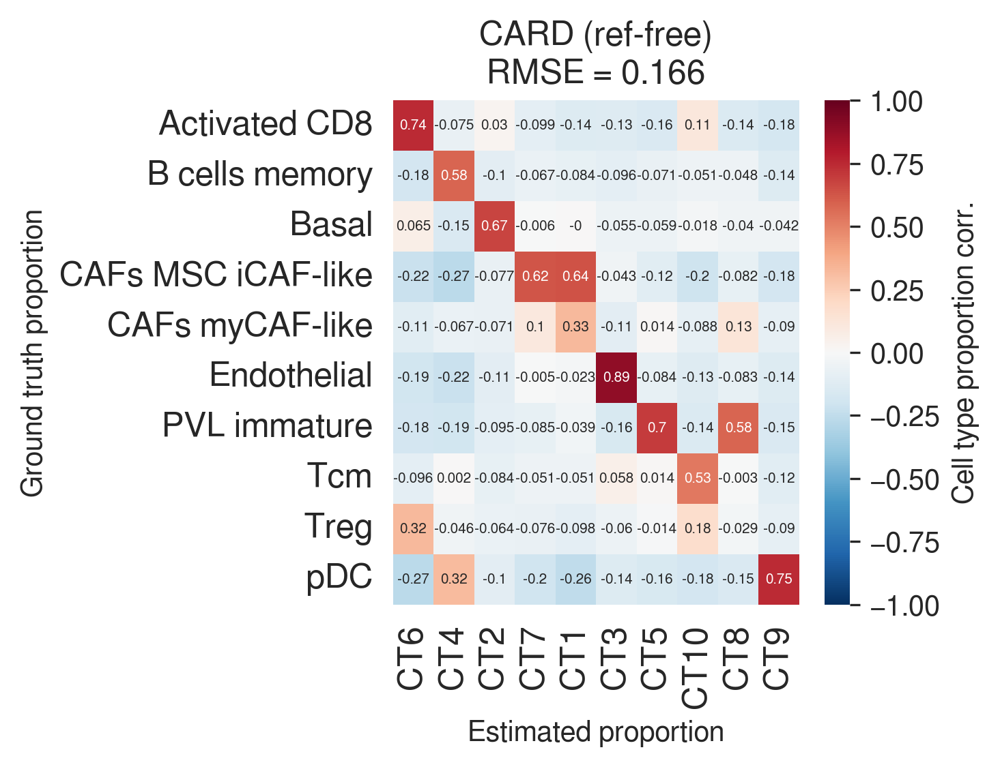

In [157]:
# CARD
benchmark_utils.disp_prop_scatter(prop_df, prop_pred_card_df)
benchmark_utils.disp_corr(
    prop_df,
    prop_pred_card_df,
    fontsize=5, 
    title='CARD (ref-free)',
    # outdir='../../plot_files/starfysh_revision/',
    # filename='simu_10_card',
    # savefig=True,
    # format='png'
)

In [86]:
from statannotations.Annotator import Annotator

In [91]:
def disp_metrics_violin(
    y_true,
    y_preds,
    labels,
    title=None,
    metric_name='RMSE',
    test_pairs=[],
    return_metrics=False
):
    """
    Violinplot of per-spot metrics for each prediction against the ground-truth
    """
    n_spots, n_cts = y_true.shape
    if metric_name == 'RMSE':
        metrics = np.array([
            np.sqrt(((y_true.values-y_pred.values)**2).sum(1) / n_cts)
            for y_pred in y_preds
        ])
        
    elif metric_name == 'JSD':
        metrics = np.array([
            jensenshannon(y_true.values, y_pred.values, axis=1)
            for y_pred in y_preds
        ])
    else:
        raise NotImplementedError(metric_name)

    lbls = np.repeat(labels, n_spots)
    df = pd.DataFrame({
        metric_name: metrics.flatten(),
        'Method': lbls
    })
    
    fig, ax = plt.subplots(figsize=(10, 4), dpi=300)
    g = sns.violinplot(x='Method', y=metric_name, data=df, scale='width', ax=ax)    
    for violin in ax.collections:
        violin.set_alpha(0.5)
    g = sns.stripplot(x='Method', y=metric_name, data=df, color='black', alpha=0.2, s=1,  ax=ax)
    
    # Add statistic test annotations btw ref-free methods
    if len(test_pairs) >= 2:
        annotator = Annotator(ax, test_pairs, data=df, x='Method', y=metric_name, order=labels)
        annotator.configure(test='Mann-Whitney', text_format='simple', loc='outside')
        annotator.apply_and_annotate()
            
    g.set_xticklabels(labels, rotation=45, fontsize=12)
    g.set_xlabel('Method', fontsize=15)
    g.set_ylabel(metric_name,fontsize=15)
    plt.suptitle(title, fontsize=20)
    plt.show()
    
    plt.setp(g.collections, alpha=.1)

    return metrics if return_metrics else None

STDeconvolve
(ref-free) vs. Starfysh: Mann-Whitney-Wilcoxon test two-sided, P_val:2.259e-11 U_stat=3.466e+06
CARD
(ref-free) vs. Starfysh: Mann-Whitney-Wilcoxon test two-sided, P_val:7.637e-53 U_stat=3.906e+06
BayesTME
(ref-free) vs. Starfysh: Mann-Whitney-Wilcoxon test two-sided, P_val:0.000e+00 U_stat=6.091e+06


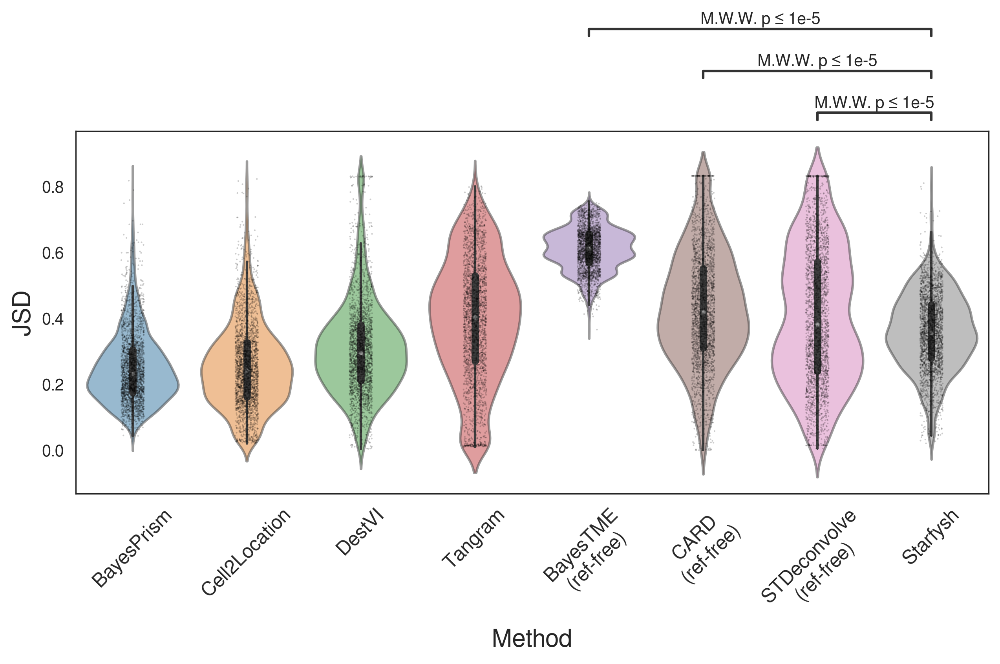

In [92]:
disp_metrics_violin(
    y_true=prop_df,
    y_preds=[prop_pred_bayesprism_df, 
             prop_pred_cell2loc_df,
             prop_pred_destvi_df,
             prop_pred_tangram_df,
             prop_pred_bayestme_df,
             prop_pred_card_df,
             prop_pred_stdeconv_df,
             prop_pred_starfysh_df
            ],
    labels=['BayesPrism',
            'Cell2Location',
            'DestVI', 
            'Tangram',
            'BayesTME\n(ref-free)',
            'CARD\n(ref-free)',
            'STDeconvolve\n(ref-free)',
            'Starfysh'
           ],
    test_pairs=[
        ('Starfysh', 'BayesTME\n(ref-free)'),
        ('Starfysh', 'CARD\n(ref-free)'),
        ('Starfysh', 'STDeconvolve\n(ref-free)')
    ],
    metric_name='JSD'
)

STDeconvolve
(ref-free) vs. Starfysh: Mann-Whitney-Wilcoxon test two-sided, P_val:1.949e-09 U_stat=3.431e+06
CARD
(ref-free) vs. Starfysh: Mann-Whitney-Wilcoxon test two-sided, P_val:1.558e-91 U_stat=4.161e+06
BayesTME
(ref-free) vs. Starfysh: Mann-Whitney-Wilcoxon test two-sided, P_val:0.000e+00 U_stat=5.441e+06


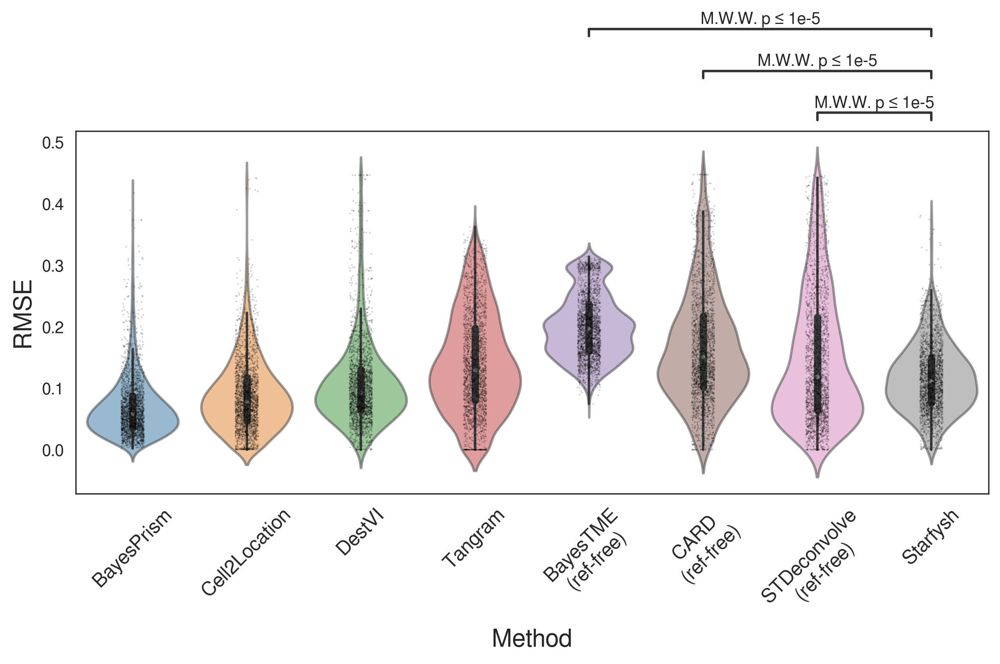

In [93]:
disp_metrics_violin(
    y_true=prop_df,
    y_preds=[prop_pred_bayesprism_df, 
             prop_pred_cell2loc_df,
             prop_pred_destvi_df,
             prop_pred_tangram_df,
             prop_pred_bayestme_df,
             prop_pred_card_df,
             prop_pred_stdeconv_df,
             prop_pred_starfysh_df
            ],
    labels=['BayesPrism',
            'Cell2Location',
            'DestVI', 
            'Tangram',
            'BayesTME\n(ref-free)',
            'CARD\n(ref-free)',
            'STDeconvolve\n(ref-free)',
            'Starfysh'
           ],
    test_pairs=[
        ('Starfysh', 'BayesTME\n(ref-free)'),
        ('Starfysh', 'CARD\n(ref-free)'),
        ('Starfysh', 'STDeconvolve\n(ref-free)')
    ],
    metric_name='RMSE'
)

### IV. Benchmark with real data (CID44971_TNBC)

#### Supp. Fig. 1

In [30]:
data_path = '../../starfysh/data/'
sample_id = 'CID44971_TNBC'

adata, adata_normed = utils.load_adata(data_folder=data_path,  # root data directory
                                       sample_id=sample_id,  # sample_id
                                       n_genes=2000  # number of highly variable genes to keep
                                      )

gene_sig = pd.read_csv('../../starfysh/data/bc_signatures_version_1013.csv')
gene_sig = utils.filter_gene_sig(gene_sig,adata.to_df()) # filter out low-quality marker genes
gene_sig.head()

[2023-07-13 16:10:54] Preprocessing1: delete the mt and rp
[2023-07-13 16:10:54] Preprocessing2: Normalize
[2023-07-13 16:10:54] Preprocessing3: Logarithm
[2023-07-13 16:10:54] Preprocessing4: Find the variable genes


,Basal,LumA,LumB,MBC,Normal epithelial,Tcm,Tem,Tfh,Treg,Activated CD8,...,Plasmablasts,MDSC,Monocytes,cDC,pDC,CAFs MSC iCAF-like,CAFs myCAF-like,PVL differentiated,PVL immature,Endothelial
0,EMP1,SH3BGRL,UGCG,COL11A2,KRT14,CCR7,IL7R,CXCL13,TNFRSF4,CD69,...,IGKV3-15,ITGAM,LYZ,CD80,IL3RA,APOD,COL1A1,ACTA2,CCL19,ACKR1
1,TAGLN,HSPB1,ARMT1,SDC1,KRT17,LTB,ANXA1,NMB,LTB,CCR7,...,IGHG1,CD33,IL1B,CD86,LILRA4,DCN,COL1A2,TAGLN,RGS5,FABP4
2,TTYH1,PHGR1,ISOC1,FBN2,LTF,IL7R,CXCR4,NR3C1,IL32,CD27,...,IGKV1-5,ARG1,G0S2,CCR7,CD123,PTGDS,COL3A1,MYL9,IGFBP7,PLVAP
3,RTN4,SOX9,GDF15,MMP1,KRT15,SARAF,KLRB1,DUSP4,BATF,BTLA,...,IGKV3-20,NOS2,TYROBP,CD1A,TCF4,CFD,LUM,TPM2,NDUFA4L2,RAMP2
4,TK1,CEBPD,ZFP36,FABP5,PTN,SELL,TNFAIP3,TNFRSF18,FOXP3,CD40LG,...,IGKV3-11,CD68,FCN1,CD1C,IRF7,LUM,SFRP2,NDUFA4L2,CCL2,VWF


In [31]:
# Unify annotations
subset_starfysh_dict = {
    'Cancer Basal SC':                  'Basal',
    'Cancer LumB SC':                   'LumB',
    'Myoepithelial':                    'Normal epithelial',
    'T_cells_c0_CD4+_CCR7':             'Tcm',
    'T_cells_c1_CD4+_IL7R':             'Tem',
    'T_cells_c3_CD4+_Tfh_CXCL13':       'Tfh',
    'T_cells_c2_CD4+_T-regs_FOXP3':     'Treg',
    'T_cells_c7_CD8+_IFNG':             'Activated CD8',
    'T_cells_c8_CD8+_LAG3':             'Terminal exhaustion',
    'B cells Memory':                   'B cells memory',
    'B cells Naive':                    'B cells naive',
    'Myeloid_c10_Macrophage_1_EGR1':    'Macrophage M1',
    'Myeloid_c9_Macrophage_2_CXCL10':   'Macrophage M2',
    'Plasmablasts':                     'Plasmablasts',
    'Myeloid_c7_Monocyte_3_FCGR3A':     'Monocytes',
    'Myeloid_c12_Monocyte_1_IL1B':      'Monocytes',
    'Myeloid_c8_Monocyte_2_S100A9':     'Monocytes',
    'Myeloid_c11_cDC2_CD1C':            'cDC',
    'Myeloid_c3_cDC1_CLEC9A':           'cDC',
    'Myeloid_c4_DCs_pDC_IRF7':          'pDC',
    'CAFs MSC iCAF-like s1':            'CAFs MSC iCAF-like',
    'CAFs MSC iCAF-like s2':            'CAFs MSC iCAF-like',
    'CAFs myCAF like s4':               'CAFs myCAF-like',
    'CAFs myCAF like s5':               'CAFs myCAF-like',
    'PVL Immature s1':                  'PVL immature',
    'PVL_Immature s2':                  'PVL immature',
    'PVL Differentiated s3':            'PVL differentiated',
    'Endothelial ACKR1':                'Endothelial',
    'Endothelial CXCL12':               'Endothelial',
    'Endothelial Lymphatic LYVE1':      'Endothelial',
    'Endothelial RGS5':                 'Endothelial'
}


gene_sig = gene_sig[np.unique(list(subset_starfysh_dict.values()))]
gene_sig.head()

,Activated CD8,B cells memory,B cells naive,Basal,CAFs MSC iCAF-like,CAFs myCAF-like,Endothelial,LumB,Macrophage M1,Macrophage M2,...,PVL differentiated,PVL immature,Plasmablasts,Tcm,Tem,Terminal exhaustion,Tfh,Treg,cDC,pDC
0,CD69,MS4A1,CD79A,EMP1,APOD,COL1A1,ACKR1,UGCG,C1QB,CXCL10,...,ACTA2,CCL19,IGKV3-15,CCR7,IL7R,CD3G,CXCL13,TNFRSF4,CD80,IL3RA
1,CCR7,CD79A,TCL1A,TAGLN,DCN,COL1A2,FABP4,ARMT1,C1QA,C1QB,...,TAGLN,RGS5,IGHG1,LTB,ANXA1,FASLG,NMB,LTB,CD86,LILRA4
2,CD27,CD83,MS4A1,TTYH1,PTGDS,COL3A1,PLVAP,ISOC1,C1QC,C1QC,...,MYL9,IGFBP7,IGKV1-5,IL7R,CXCR4,ID2,NR3C1,IL32,CCR7,CD123
3,BTLA,CD37,CD37,RTN4,CFD,LUM,RAMP2,GDF15,CCL3,CXCL9,...,TPM2,NDUFA4L2,IGKV3-20,SARAF,KLRB1,LAG3,DUSP4,BATF,CD1A,TCF4
4,CD40LG,BANK1,CD74,TK1,LUM,SFRP2,VWF,ZFP36,CCL3L3,C1QA,...,NDUFA4L2,CCL2,IGKV3-11,SELL,TNFAIP3,RGS1,TNFRSF18,FOXP3,CD1C,IRF7


In [33]:
# Load histology data
img_metadata = utils.preprocess_img(data_path,
                                    sample_id,
                                    adata_index=adata.obs.index,
                                    hchannel=True)

img, map_info, scalefactor = img_metadata['img'], img_metadata['map_info'], img_metadata['scalefactor']
map_info = map_info[['array_row', 'array_col']].astype(float)

#### (a). Starfysh deconvolution

In [34]:
visium_args = utils.VisiumArguments(adata,
                                    adata_normed,
                                    gene_sig,
                                    img_metadata,
                                    window_size=1,
                                    sample_id=sample_id
                                   )

sig_mean_df = visium_args.sig_mean.copy()
sig_mean_df = sig_mean_df.div(sig_mean_df.sum(1), 0)
adata, adata_normed = visium_args.get_adata()
anchors_df = visium_args.get_anchors()

[2023-07-13 16:12:36] Subsetting highly variable & signature genes ...
[2023-07-13 16:12:40] Smoothing library size by taking averaging with neighbor spots...
[2023-07-13 16:12:41] Retrieving & normalizing signature gene expressions...


[2023-07-13 16:12:42] Identifying anchor spots (highly expression of specific cell-type signatures)...


Archetypal Analysis:

In [118]:
# Try taking normalization but without log-transform
aa_model = AA.ArchetypalAnalysis(adata_orig=adata)

# set large resolution / convergence criteria to obtain major archetypes
archetype, arche_dict, major_idx, evs = aa_model.compute_archetypes(cn=30,
                                                                    r=100,
                                                                    display=False)

arche_df = aa_model.find_archetypal_spots(major=True)
markers_df = aa_model.find_markers(n_markers=30, display=False)

# (3). Map archetypes to closest anchors within `r` nearest neighbors
# Choose the top 5% anchors of each cell type for mapping
percent_anchor = 0.05
n_ancs = int(percent_anchor*adata.shape[0])

anchors_df = visium_args.get_anchors()
map_df, map_dict = aa_model.assign_archetypes(anchor_df=anchors_df[:n_ancs],
                                              r=n_ancs)


[2023-07-13 16:52:52] Computing intrinsic dimension to estimate k...
[2023-07-13 16:52:52] Estimating lower bound of # archetype as 5...


15 components are retained using conditional_number=30.00


[2023-07-13 16:53:50] 0.9122 variance explained by raw archetypes.
Merging raw archetypes within 100 NNs to get major archetypes
[2023-07-13 16:53:51] Finding 20 nearest neighbors for each archetype...
[2023-07-13 16:53:51] Finding 30 top marker genes for each archetype...
... storing 'sample' as categorical


[2023-07-13 11:25:14] Calculating UMAPs for counts + Archetypes...


(<Figure size 1800x1200 with 1 Axes>, <AxesSubplot:>)

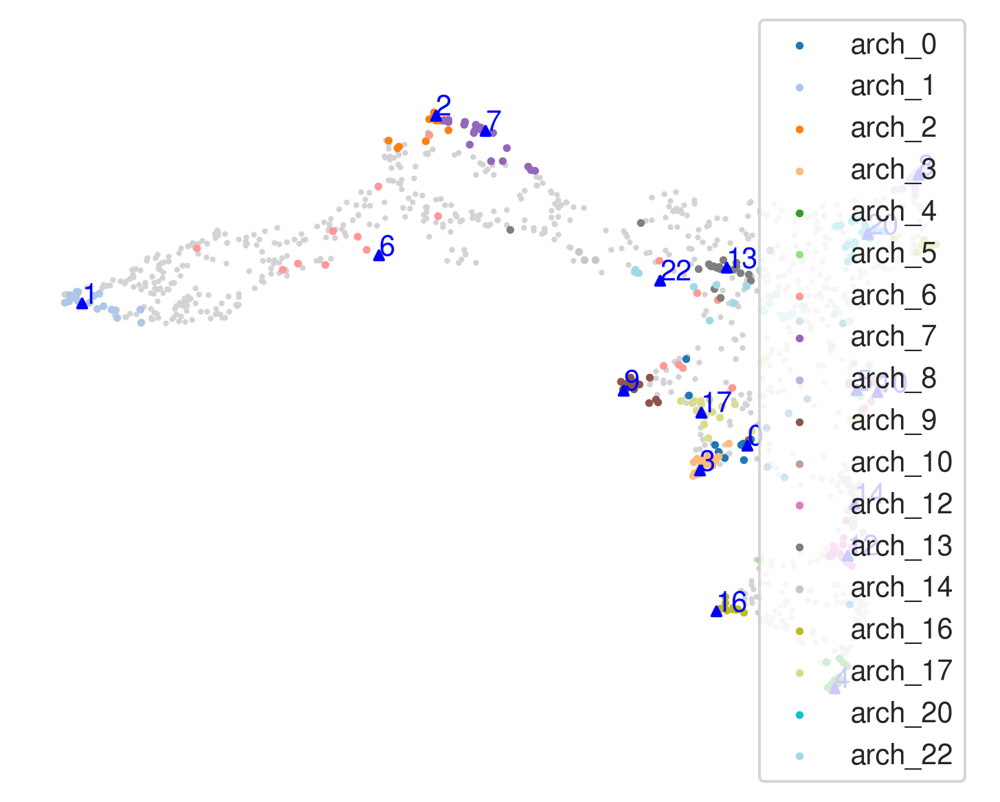

In [171]:
aa_model.plot_archetypes()

In [119]:
map_dict

{'Basal': 'arch_4',
 'CAFs myCAF-like': 'arch_14',
 'Endothelial': 'arch_22',
 'LumB': 'arch_1',
 'Monocytes': 'arch_12',
 'Normal epithelial': 'arch_6',
 'PVL differentiated': 'arch_13',
 'Plasmablasts': 'arch_0',
 'Tcm': 'arch_10',
 'Tfh': 'arch_5',
 'pDC': 'arch_7',
 'Activated CD8': 'arch_9',
 'B cells memory': 'arch_17',
 'CAFs MSC iCAF-like': 'arch_3',
 'Macrophage M1': 'arch_2',
 'B cells naive': 'arch_20',
 'Macrophage M2': 'arch_16',
 'PVL immature': 'arch_8'}

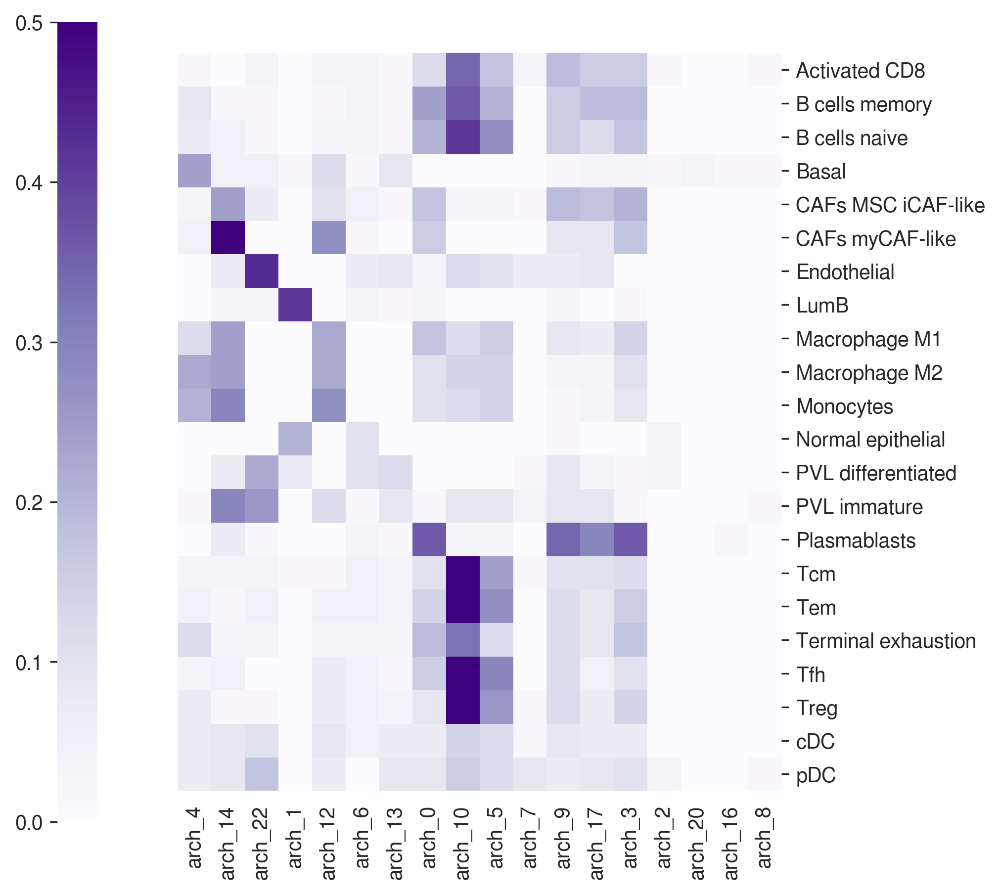

In [120]:
map_df_prop = map_df / n_ancs

fig, ax = plt.subplots(figsize=(7, 7), dpi=300)
g = sns.heatmap(map_df_prop[list(map_dict.values())], cmap='Purples', vmax=0.5, square=True, 
                cbar_kws=dict(location='left'), ax=ax)
ax.yaxis.tick_right()
ax.set_yticklabels(ax.get_yticklabels(), rotation=0)
plt.show()

In [121]:
gene_sig_arch = gene_sig.copy()
for cell_type in map_dict.keys():
    if (~pd.isna(gene_sig[cell_type])).sum() < 50:
        arch = map_dict[cell_type]
        gene_sig_arch = utils.append_sigs(gene_sig_arch, cell_type, markers_df[arch], n_genes=30)

Starfysh deconvolution:

In [122]:
visium_args_arche = utils.VisiumArguments(adata,
                                          adata_normed,
                                          gene_sig_arch,
                                          img_metadata,
                                          window_size=1,
                                          sample_id=sample_id
                                         )

adata, adata_normed = visium_args_arche.get_adata()
anchors_df = visium_args_arche.get_anchors()

[2023-07-13 16:54:01] Subsetting highly variable & signature genes ...
[2023-07-13 16:54:05] Smoothing library size by taking averaging with neighbor spots...
[2023-07-13 16:54:05] Retrieving & normalizing signature gene expressions...


[2023-07-13 16:54:06] Identifying anchor spots (highly expression of specific cell-type signatures)...


In [242]:
n_repeats = 3
epochs = 200
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')


t0 = time.perf_counter()
model, loss = utils.run_starfysh(visium_args_arche,
                                 n_repeats=n_repeats,
                                 alpha_mul=10,
                                 epochs=epochs,
                                 device=device)

t1 = time.perf_counter()

[2023-07-13 21:06:22] Running Starfysh with 3 restarts, choose the model with best parameters...
[2023-07-13 21:06:22]  ===  Restart Starfysh 1 === 

[2023-07-13 21:06:22] Initializing model parameters...
[2023-07-13 21:06:28] Epoch[10/200], train_loss: 1634.7105, train_reconst: 1512.5232, train_u: 16.9103,train_z: 16.6027,train_c: 86.6732,train_l: 2.0011
[2023-07-13 21:06:35] Epoch[20/200], train_loss: 1546.5688, train_reconst: 1428.8125, train_u: 15.9761,train_z: 17.8440,train_c: 81.5525,train_l: 2.3837
[2023-07-13 21:06:41] Epoch[30/200], train_loss: 1512.5459, train_reconst: 1397.7586, train_u: 15.3014,train_z: 18.4132,train_c: 78.4345,train_l: 2.6382
[2023-07-13 21:06:48] Epoch[40/200], train_loss: 1485.2177, train_reconst: 1372.9610, train_u: 14.8151,train_z: 18.6027,train_c: 76.1036,train_l: 2.7354
[2023-07-13 21:06:54] Epoch[50/200], train_loss: 1470.5930, train_reconst: 1360.8829, train_u: 14.4595,train_z: 18.5986,train_c: 73.8667,train_l: 2.7853
[2023-07-13 21:07:00] Epoch[60

In [246]:
print('Running time:', t1-t0, 'second', (t1-t0)/60, 'min')

Running time: 379.95638786198106 second 6.332606464366351 min


Calculate correlation to the priors:

In [174]:
from scipy.stats import pearsonr

In [247]:
inference_outputs, generative_outputs = sf_model.model_eval(model,
                                                            adata,
                                                            visium_args_arche,
                                                            device=device)

# Deconvolution prediction
prop_pred_starfysh_df = pd.DataFrame(adata.obsm['qc_m'], index=adata.obs_names, columns=gene_sig.columns)

In [253]:
corr_sigmean_df = pd.DataFrame(
    benchmark_utils.calc_elemcorr(sig_mean_df.values, sig_mean_df.values),
    index=sig_mean_df.columns,
    columns=sig_mean_df.columns
)

corr_sigmean_df.head()


,Activated CD8,B cells memory,B cells naive,Basal,CAFs MSC iCAF-like,CAFs myCAF-like,Endothelial,LumB,Macrophage M1,Macrophage M2,...,PVL differentiated,PVL immature,Plasmablasts,Tcm,Tem,Terminal exhaustion,Tfh,Treg,cDC,pDC
Activated CD8,1.000000,0.326659,0.325522,0.141023,-0.336694,-0.237952,-0.265161,-0.132198,0.230621,0.323834,...,-0.426770,-0.360361,0.045601,0.182236,0.300351,0.391067,0.405120,0.444921,0.128403,-0.082858
B cells memory,0.326659,1.000000,0.842929,-0.469337,-0.008089,0.119315,-0.312629,-0.620319,0.539463,0.549981,...,-0.689501,-0.390791,0.352421,0.070316,0.305018,0.193106,0.419261,0.370524,0.352738,0.121237
B cells naive,0.325522,0.842929,1.000000,-0.448753,-0.126435,-0.081809,-0.289820,-0.529939,0.550012,0.546921,...,-0.607564,-0.443074,0.076550,0.233225,0.390479,0.251182,0.477250,0.469801,0.382846,0.146366
Basal,0.141023,-0.469337,-0.448753,1.000000,-0.538779,-0.457390,-0.034295,0.682484,-0.194479,-0.093389,...,0.211184,-0.040387,-0.129391,-0.129614,-0.171168,0.118319,-0.207983,-0.067780,-0.262201,-0.255880
CAFs MSC iCAF-like,-0.336694,-0.008089,-0.126435,-0.538779,1.000000,0.747895,0.152710,-0.369742,-0.222678,-0.331936,...,-0.013287,0.241123,0.225076,-0.197972,-0.249749,-0.356956,-0.196150,-0.318634,-0.076361,0.047588


In [254]:
corr_starfysh_df = pd.DataFrame(
    benchmark_utils.calc_elemcorr(sig_mean_df.values, prop_pred_starfysh_df.values),
    index=sig_mean_df.columns,
    columns=prop_pred_df.columns
)

corr_starfysh_df.head()


,Activated CD8,B cells memory,B cells naive,Basal,CAFs MSC iCAF-like,CAFs myCAF-like,Endothelial,LumB,Macrophage M1,Macrophage M2,...,PVL differentiated,PVL immature,Plasmablasts,Tcm,Tem,Terminal exhaustion,Tfh,Treg,cDC,pDC
Activated CD8,0.192576,0.203385,0.272218,0.210267,0.004662,-0.170877,-0.150840,-0.188249,0.168648,0.208169,...,-0.233625,0.139975,0.054796,0.347198,0.175237,0.111911,0.412705,0.440961,-0.047346,-0.202592
B cells memory,0.389642,0.634868,-0.218071,-0.318118,0.298138,-0.001142,-0.124915,-0.282195,0.520697,0.464243,...,-0.161162,-0.308262,0.470103,0.546757,0.256719,0.025419,0.603505,0.480239,0.064554,-0.093236
B cells naive,0.267797,0.518449,-0.210956,-0.333913,0.133838,-0.112339,-0.121467,-0.130770,0.515507,0.457743,...,-0.201225,-0.362109,0.305766,0.588118,0.280953,0.034987,0.634136,0.519693,0.031308,-0.101913
Basal,-0.408025,-0.466953,0.793861,0.833054,-0.399480,-0.255375,-0.130088,-0.007001,-0.346744,-0.221401,...,-0.103906,0.714004,-0.420948,-0.405710,-0.241425,-0.030565,-0.398533,-0.238647,0.004120,-0.080819
CAFs MSC iCAF-like,0.286150,0.142526,-0.496059,-0.446993,0.586314,0.522276,0.187739,-0.119592,-0.010348,-0.090946,...,0.151554,-0.376141,0.259371,0.012377,-0.021637,-0.044662,-0.044691,-0.128327,-0.056762,0.145451


In [296]:
def dist2gt(A, A_gt):
    """
    Calculate the distance to ground-truth correlation matrix (approx. by marker gene expressions X normalized) 
    """
    return np.linalg.norm(A - A_gt, ord='fro')


def bootstrap_dists(corr_df, corr_gt_df, n_iter=1000, size=10):
    """
    Calculate the avg. distance to identity matrix based on random subsampling
    """
    n = min(size, min(corr_df.shape[0], corr_df.shape[1]))
    labels = corr_df.index if corr_df.shape[0] < corr_df.shape[1] else corr_df.columns
    dists = np.zeros(n_iter)

    for i in range(n_iter):
        lbl = np.random.choice(labels, n)
        A = corr_df.loc[lbl, lbl].values
        A_gt = corr_gt_df.loc[lbl, lbl].values
        dists[i] = dist2gt(A, A_gt)
        #dists[i] = dist2identity(A)

    return dists

In [314]:
np.random.seed(42)

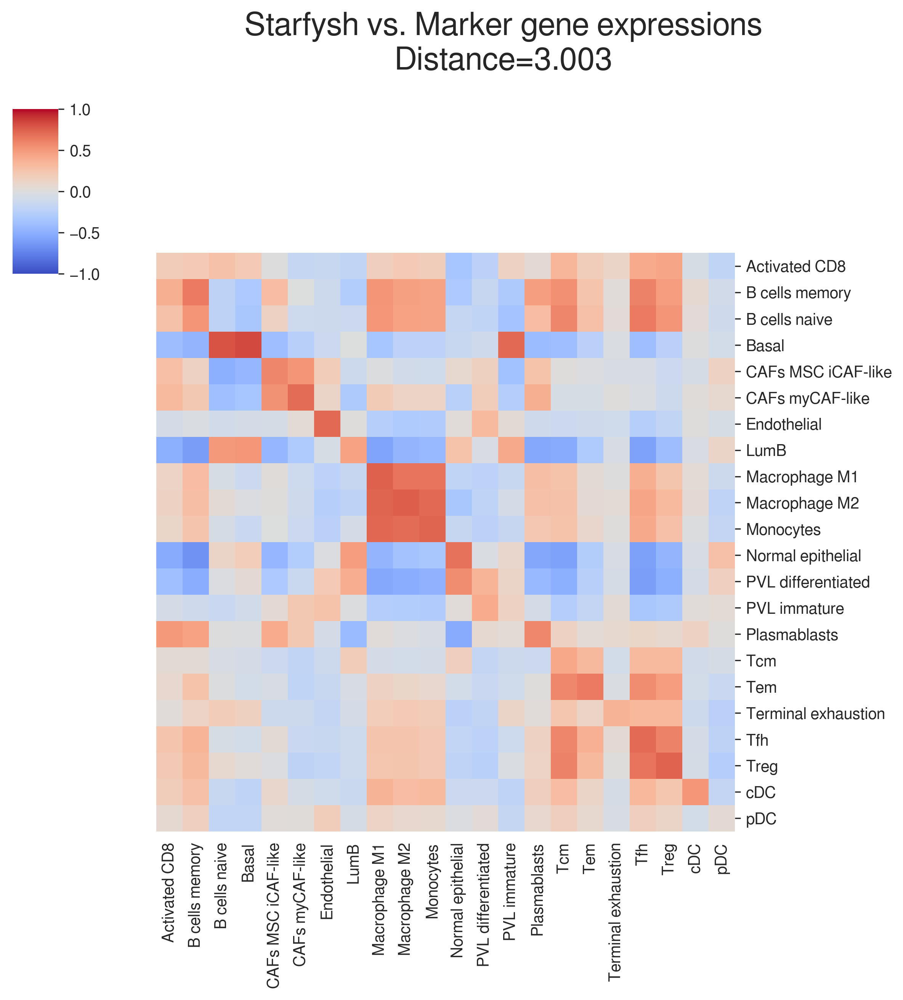

In [315]:
g = sns.clustermap(corr_starfysh_df, 
                   figsize=(8, 8),
                   cmap='coolwarm', 
                   row_cluster=False,
                   col_cluster=False,
                   vmin=-1,
                   vmax=1,
                   square=True,
                   xticklabels=True, 
                   yticklabels=True,
                   
                   annot_kws={'size': 15}
                  )

dists_starfysh = bootstrap_dists(corr_starfysh_df, corr_sigmean_df, size=10)

text = g.ax_heatmap.set_title(
    'Starfysh vs. Marker gene expressions\nDistance={}'.format(
        np.round(dists_starfysh.mean(), 3)
    ),
    fontsize=20, x=0.6, y=1.3
)

#### (b). Benchmark with other methods 

In [53]:
from scipy.stats import pearsonr

In [316]:
res_path = '../simulation/results/'

prop_pred_bayesprism_df = pd.read_csv(os.path.join(res_path, 'Bayesprism_44971_proportion.csv'), index_col=[0])
prop_pred_cell2loc_df = pd.read_csv(os.path.join(res_path, 'Cell2Location_44971_proportion.csv'), index_col=[0])
prop_pred_stdeconv_df = pd.read_csv(os.path.join(res_path, 'STdeconvolve_44971_proportion.csv'), index_col=[0])

# sort cell type orders
prop_pred_bayesprism_df = prop_pred_bayesprism_df[prop_pred_cell2loc_df.columns]

In [317]:
corr_bayesprism_df = pd.DataFrame(
    benchmark_utils.calc_elemcorr(sig_mean_df.values, prop_pred_bayesprism_df.values),
    index=sig_mean_df.columns,
    columns=prop_pred_bayesprism_df.columns
)

In [318]:
corr_cell2loc_df = pd.DataFrame(
    benchmark_utils.calc_elemcorr(sig_mean_df.values, prop_pred_cell2loc_df.values),
    index=sig_mean_df.columns,
    columns=prop_pred_cell2loc_df.columns
)

In [319]:
corr_stdeconv = np.zeros((sig_mean_df.shape[1], prop_pred_stdeconv_df.shape[1]))

for i in range(sig_mean_df.shape[1]):
    for j in range(prop_pred_stdeconv_df.shape[1]):
        corr_stdeconv[i, j] = pearsonr(sig_mean_df.iloc[:, i], prop_pred_stdeconv_df.iloc[:, j])[0]
        
corr_stdeconv_df = pd.DataFrame(corr_stdeconv, index=sig_mean_df.columns, columns=prop_pred_stdeconv_df.columns)

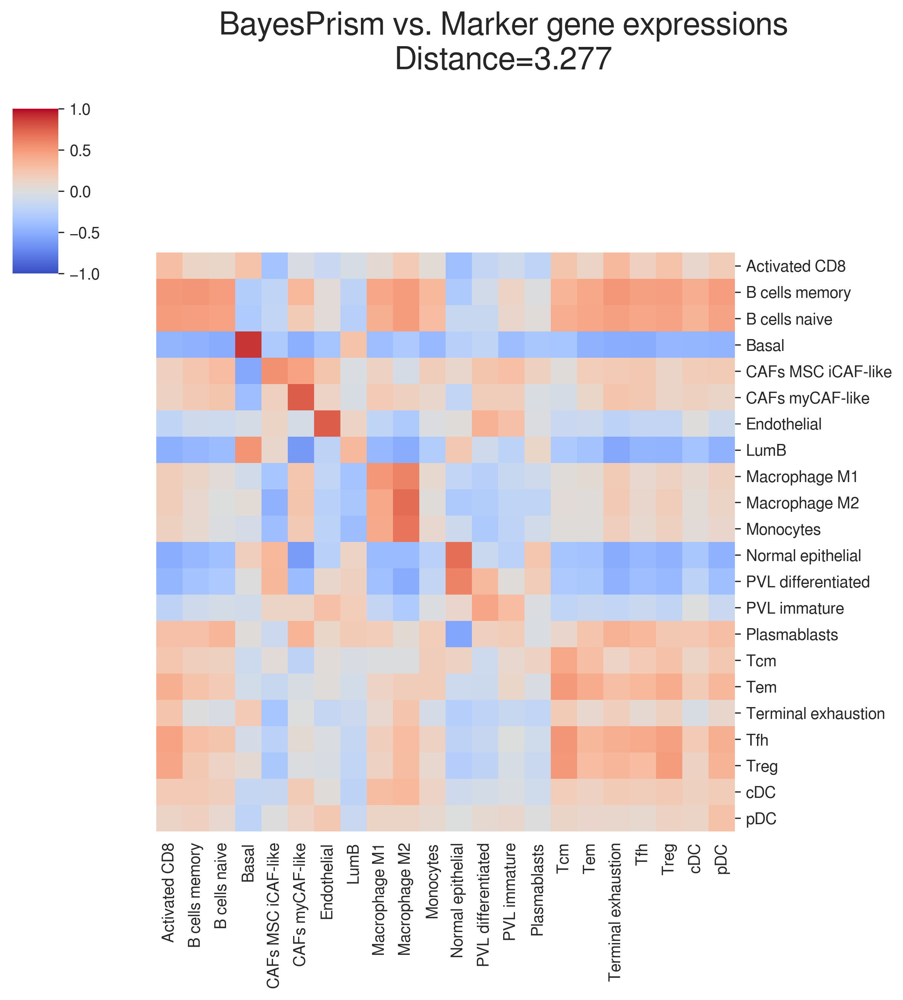

In [320]:
g = sns.clustermap(corr_bayesprism_df, 
                   figsize=(8, 8),
                   cmap='coolwarm', 
                   row_cluster=False,
                   col_cluster=False,
                   vmin=-1,
                   vmax=1,
                   square=True,
                   xticklabels=True, 
                   yticklabels=True,
                   
                   annot_kws={'size': 15}
                  )

dists_bayesprism =  bootstrap_dists(corr_bayesprism_df, corr_sigmean_df, size=10)

text = g.ax_heatmap.set_title(
    'BayesPrism vs. Marker gene expressions\nDistance={}'.format(
        np.round(dists_bayesprism.mean(), 3)
    ),
    fontsize=20, x=0.6, y=1.3
)

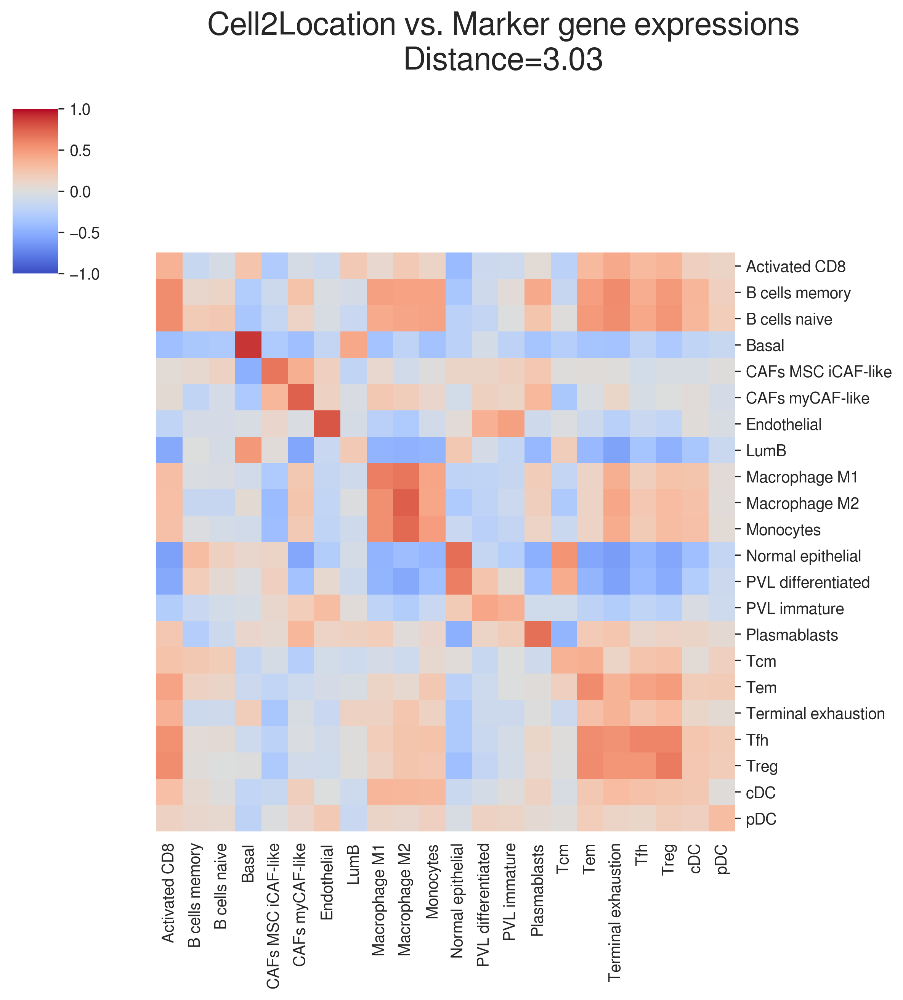

In [321]:
g = sns.clustermap(corr_cell2loc_df, 
                   figsize=(8, 8),
                   cmap='coolwarm', 
                   row_cluster=False,
                   col_cluster=False,
                   vmin=-1,
                   vmax=1,
                   square=True,
                   xticklabels=True, 
                   yticklabels=True,
                   
                   annot_kws={'size': 15}
                  )

dists_cell2loc =  bootstrap_dists(corr_cell2loc_df, corr_sigmean_df, size=10)

text = g.ax_heatmap.set_title(
    'Cell2Location vs. Marker gene expressions\nDistance={}'.format(
        np.round(dists_cell2loc.mean(), 3)
    ),
    fontsize=20, x=0.6, y=1.3
)

In [322]:
# Best-map between cell-type signature scores & STDeconvolve factors
def stable_matching(A):
    matching = {}
    free_rows, free_cols = set(range(A.shape[0])), set(range(A.shape[1]))

    while free_rows:
        i = free_rows.pop()
        for j in np.argsort(A[i])[::-1]:  # iter cols in decreasing vals
            if j in free_cols:
                matching[i] = j
                free_cols.remove(j)
                break
            else:  # Check matched cols & compare tie-breaking conditions
                i_prime = next(k for k, v in matching.items() if v == j)
                if A[i, j] > A[i_prime, j]:
                    matching[i] = j
                    free_rows.add(i_prime)
                    del matching[i_prime]
                    break

    return matching


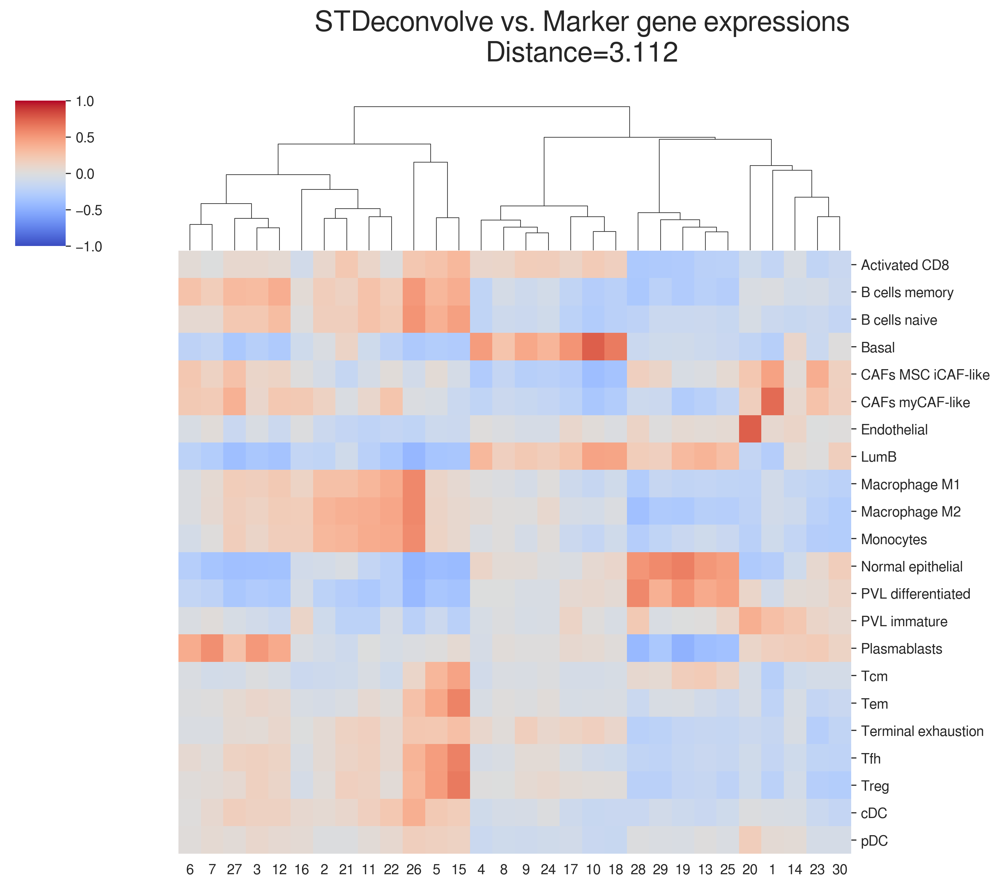

In [323]:
g = sns.clustermap(corr_stdeconv_df, 
                   figsize=(10, 8),
                   cmap='coolwarm', 
                   row_cluster=False,
                   col_cluster=True,
                   vmin=-1,
                   vmax=1,
                   square=True,
                   xticklabels=True, 
                   yticklabels=True,
                   annot_kws={'size': 15}
                  )

stdeconv_match = stable_matching(corr_stdeconv)
stdeconv_pseudo_lbls = np.asarray(prop_pred_stdeconv_df.columns)
for k, v in stdeconv_match.items():
    stdeconv_pseudo_lbls[v] = sig_mean_df.columns[k]
    
corr_stdeconv_match_df = corr_stdeconv_df.copy()
corr_stdeconv_match_df.columns = stdeconv_pseudo_lbls
dists_stdeconv =  bootstrap_dists(corr_stdeconv_match_df, corr_sigmean_df, size=10)



text = g.ax_heatmap.set_title(
    'STDeconvolve vs. Marker gene expressions\nDistance={}'.format(
        np.round(dists_stdeconv.mean(), 3)
    ),
    fontsize=20, x=0.6, y=1.3
)

    
del k, v, stdeconv_match, stdeconv_pseudo_lbls, corr_stdeconv_match_df

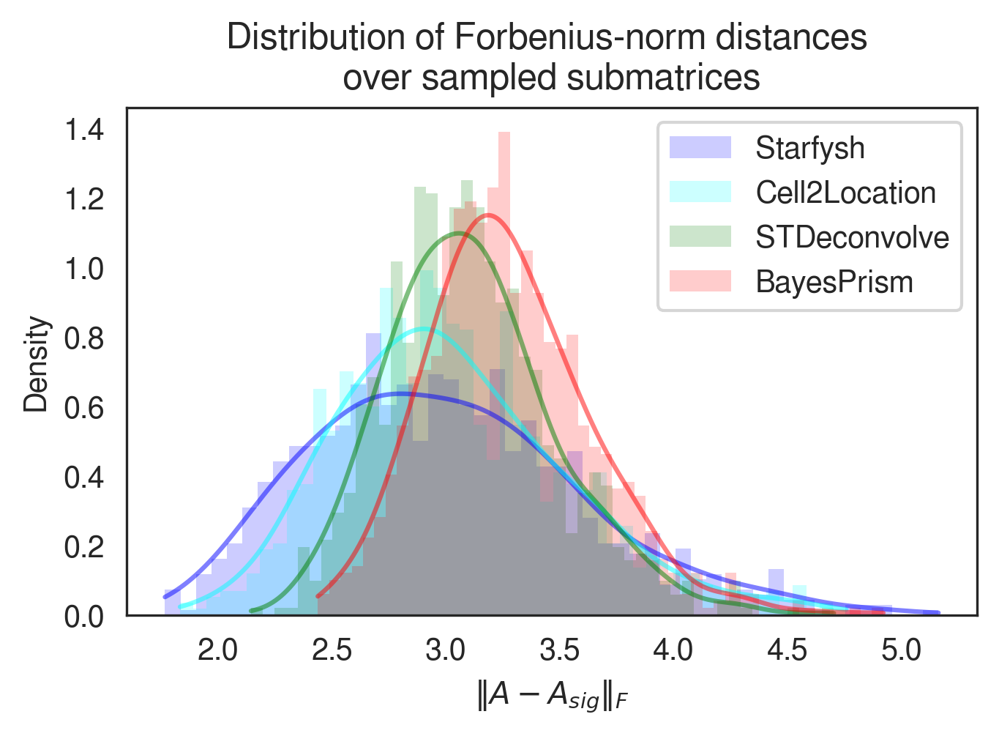

In [341]:
fig, ax = plt.subplots(1, 1, dpi=300, figsize=(5, 3))

ax.hist(dists_starfysh, color='blue', alpha=0.2, bins=50, density=True, edgecolor='none', label='Starfysh')
ax.hist(dists_cell2loc, color='cyan', alpha=0.2, bins=50, density=True, edgecolor='none', label='Cell2Location')
ax.hist(dists_stdeconv, color='green', alpha=0.2, bins=50, density=True, edgecolor='none', label='STDeconvolve')
ax.hist(dists_bayesprism, color='red', alpha=0.2, bins=50, density=True, edgecolor='none', label='BayesPrism')

# plot fitted KDEs
xx_starfysh = np.linspace(dists_starfysh.min(), dists_starfysh.max(), len(dists_starfysh))
xx_cell2loc = np.linspace(dists_cell2loc.min(), dists_cell2loc.max(), len(dists_cell2loc))
xx_stdeconv = np.linspace(dists_stdeconv.min(), dists_stdeconv.max(), len(dists_stdeconv))
xx_bayesprism = np.linspace(dists_bayesprism.min(), dists_bayesprism.max(), len(dists_bayesprism))

kde1 = gaussian_kde(dists_starfysh, bw_method=0.3)
kde2 = gaussian_kde(dists_cell2loc, bw_method=0.3)
kde3 = gaussian_kde(dists_stdeconv, bw_method=0.3)
kde4 = gaussian_kde(dists_bayesprism, bw_method=0.3)

ax.plot(xx_starfysh, kde1(xx_starfysh), color='blue', alpha=0.5)
ax.plot(xx_cell2loc, kde2(xx_cell2loc), color='cyan', alpha=0.5)
ax.plot(xx_stdeconv, kde3(xx_stdeconv), color='green', alpha=0.5)
ax.plot(xx_bayesprism, kde4(xx_bayesprism), color='red', alpha=0.5)

ax.set_xlabel(r"$\Vert A - A_{sig} \Vert_F$")
ax.set_ylabel('Density')

ax.legend()
ax.set_title('Distribution of Forbenius-norm distances \n over sampled submatrices ')
plt.show()

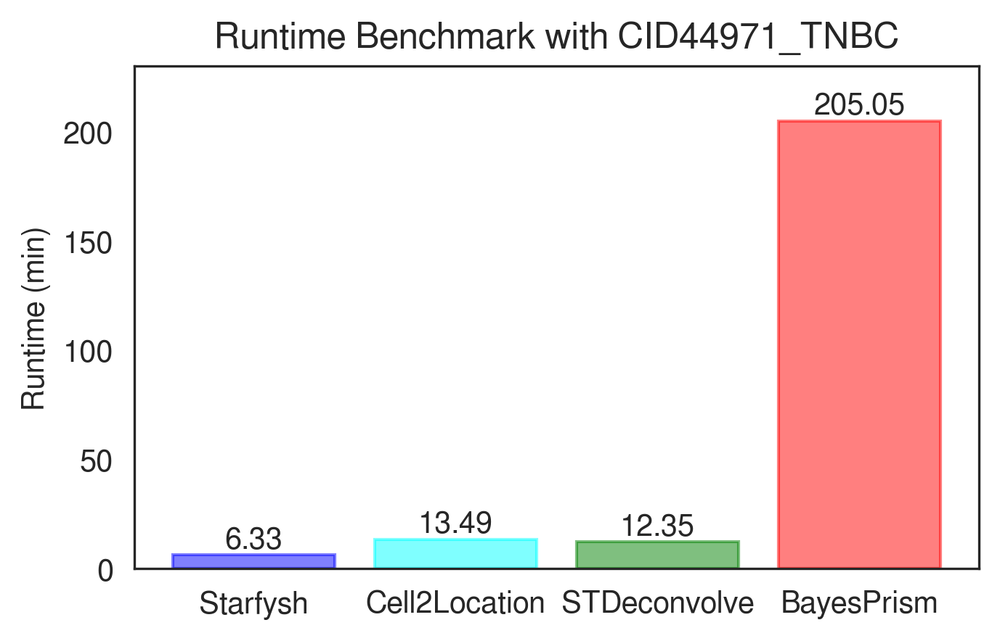

In [342]:
runtime = [6.33, 13.49, 12.35, 205.05]
methods = ['Starfysh', 'Cell2Location', 'STDeconvolve', 'BayesPrism']
colors = ['blue', 'cyan', 'green', 'red']

fig, ax = plt.subplots(1, 1, figsize=(5, 3), dpi=300)
g = ax.bar(methods, runtime, alpha=0.5)
ax.set_ylim([0, 230])
ax.set_ylabel('Runtime (min)')
ax.set_title('Runtime Benchmark with CID44971_TNBC')

for g_, col in zip(g, colors):
    g_.set_color(col)
for bars in ax.containers:
    ax.bar_label(bars)

---